# 1. Install Dependencies
Automated dependency installation

In [ ]:
!pip install datasets transformers
!pip install transformers[torch] #"Hugging Face Transformers library with PyTorch backend"
!pip install accelerate -U #"Library for easy usage of distributed training"
!pip install datasets[audio] #"Hugging Face Datasets library with audio processing support"
!pip install evaluate #"Evaluation metrics library from Hugging Face"
!pip install jiwer #"Library for calculating Word Error Rate (WER)"
!pip install rouge #"ROUGE metric for text summarization evaluation"
!pip install ipywidgets
!pip install ipython
!pip install python-Levenshtein # Install the Levenshtein library
!pip install rouge-score


  Using cached rapidfuzz-2.13.7-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (9.0 kB)
Using cached rapidfuzz-2.13.7-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (2.2 MB)
  Attempting uninstall: rapidfuzz
    Found existing installation: RapidFuzz 3.10.1
    Uninstalling RapidFuzz-3.10.1:
      Successfully uninstalled RapidFuzz-3.10.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
levenshtein 0.26.1 requires rapidfuzz<4.0.0,>=3.9.0, but you have rapidfuzz 2.13.7 which is incompatible.


  Using cached rapidfuzz-3.10.1-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (11 kB)
Using cached rapidfuzz-3.10.1-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (3.1 MB)
ERROR: Operation cancelled by user


# 2. Importing the Required Libraries
Organized library imports

In [ ]:
# Core Scientific Computing Libraries
import numpy as np                  # Numerical computing library for arrays and matrices
import torch                        # Deep learning framework
import pandas as pd                 # Data manipulation and analysis library

# Audio Processing
import librosa                      # Music and audio analysis
import librosa.display             # Visualization tools for audio signals
from IPython.display import display, Audio, HTML  # Display audio and HTML in notebooks
import IPython.display as ipd      # Rich display system for Jupyter notebooks

# NLP and ML Libraries
import transformers                 # Hugging Face Transformers for state-of-the-art NLP
import datasets                     # Hugging Face Datasets for accessing/managing datasets
import evaluate                     # Evaluation metrics for ML models
import nltk                         # Natural Language Toolkit for text processing
from wordcloud import WordCloud     # Generate word clouds from text data

# Data Visualization
import matplotlib.pyplot as plt     # Plotting library
import seaborn as sns              # Statistical data visualization

# Utility Imports
import re                          # Regular expressions for text processing
import json                        # JSON handling
import random                      # Random number generation
import time                        # Time tracking for performance metrics
from collections import Counter, defaultdict    # For counting and default dictionaries
from dataclasses import dataclass, field  # Data classes for structured data
from typing import Any, Dict, List, Optional, Union  # Type hints

# Dataset-related imports from Hugging Face
from datasets import (
    load_dataset,                  # Load datasets from Hugging Face hub
    ClassLabel,                    # Label classification utilities
    Audio,                        # Audio dataset handling
    DatasetDict,                  # Dictionary of datasets
    concatenate_datasets          # Combine multiple datasets
)

# Whisper-specific imports from Transformers
from transformers import (
    WhisperConfig,                # Model configuration
    WhisperProcessor,             # Process inputs for Whisper model
    WhisperFeatureExtractor,      # Extract features from audio
    WhisperTokenizer,             # Tokenization for Whisper
    WhisperForConditionalGeneration,  # Main Whisper model
    Trainer,                      # General training utilities
    TrainingArguments,            # Training configuration
    DataCollatorWithPadding,      # Batch preparation
    Seq2SeqTrainer,              # Sequence-to-sequence training
    Seq2SeqTrainingArguments,     # Seq2Seq training configuration
    pipeline,                     # Easy-to-use inference pipelines
    AdamW                        # AdamW optimizer
)
from transformers.utils import send_example_telemetry  # Telemetry utilities
# in file ipython-input-53-3fce0bf1bb57
from Levenshtein import distance as levenshtein_distance  # Import the function

# Google Colab specific imports
from google.colab import drive    # Mount Google Drive in Colab

# Download NLTK data for tokenization
nltk.download('punkt')            # Download punctuation tokenizer data

# Version verification
print("PyTorch version:", torch.__version__)
print("Transformers version:", transformers.__version__)
print("Datasets version:", datasets.__version__)

PyTorch version: 2.5.0+cu121
Transformers version: 4.44.2
Datasets version: 3.1.0


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


# 3. Data Preparation : Mount Google Drive
Google Drive mounting for Colab

In [ ]:
# Mount Google Drive for data storage
drive.mount('/content/drive', force_remount=True)  # Ensures fresh mount of Google Drive

Mounted at /content/drive


# 4. Loading and Merging the Data Set

In [ ]:
# Function to verify the integrity of audio data and print statistics
def verify_audio_data(dataset, name):
    """
    Verify audio data integrity and print dataset statistics

    Args:
        dataset: The dataset to verify
        name: Name of the dataset for printing purposes

    Returns:
        bool: True if no audio issues found, False otherwise
    """
    print(f"\n=== {name} Dataset Statistics ===")
    print(f"Number of examples: {len(dataset)}")

    # Check for potential audio loading issues
    # Counts examples where audio data is missing or corrupted
    audio_issues = 0
    for idx, example in enumerate(dataset):
        try:
            # Verify both audio array and sampling rate exist
            if example['audio'] is None or (
                isinstance(example['audio'], dict) and
                (example['audio'].get('array') is None or
                 example['audio'].get('sampling_rate') is None)
            ):
                audio_issues += 1
        except Exception as e:
            print(f"Error checking audio at index {idx}: {str(e)}")
            audio_issues += 1

    print(f"Examples with audio issues: {audio_issues}")

    # Calculate and print distribution of intent classes
    intent_counts = {}
    for example in dataset:
        intent_class = example['intent_class']
        intent_counts[intent_class] = intent_counts.get(intent_class, 0) + 1

    print("\nIntent distribution:")
    for intent_class, count in sorted(intent_counts.items()):
        print(f"Intent {intent_class}: {count} examples ({count/len(dataset)*100:.1f}%)")

    return audio_issues == 0

def load_minds14_datasets():
    """
    Load and verify MINDS-14 datasets for English variants

    Downloads and processes three English variants:
    - US English (en-US)
    - Australian English (en-AU)
    - British English (en-GB)

    Returns:
        dict: Dictionary containing individual datasets and combined dataset
    """
    try:
        # Download datasets from Hugging Face using CLI
        print("Downloading MINDS-14 datasets...")
        # Download US English dataset
        !huggingface-cli download PolyAI/minds14 --repo-type dataset --revision refs/convert/parquet \
            --local-dir . --local-dir-use-symlinks False  --include 'en-US/*'
        # Download Australian English dataset
        !huggingface-cli download PolyAI/minds14 --repo-type dataset --revision refs/convert/parquet \
            --local-dir . --local-dir-use-symlinks False  --include 'en-AU/*'
        # Download British English dataset
        !huggingface-cli download PolyAI/minds14 --repo-type dataset --revision refs/convert/parquet \
            --local-dir . --local-dir-use-symlinks False  --include 'en-GB/*'

        # Load each dataset from local files
        print("\nLoading datasets...")
        minds_enUS = load_dataset('./en-US', split="train")  # Load US English
        minds_enAU = load_dataset('./en-AU', split="train")  # Load Australian English
        minds_enGB = load_dataset('./en-GB', split="train")  # Load British English

        # Verify the integrity of each dataset
        us_valid = verify_audio_data(minds_enUS, "US English")
        au_valid = verify_audio_data(minds_enAU, "Australian English")
        gb_valid = verify_audio_data(minds_enGB, "British English")

        # Warning if any dataset has issues
        if not all([us_valid, au_valid, gb_valid]):
            print("\nWarning: Some datasets have audio integrity issues!")

        # Combine all English variants into one dataset
        combined_dataset = concatenate_datasets([minds_enUS, minds_enAU, minds_enGB])
        print(f"\nTotal combined examples: {len(combined_dataset)}")

        # Return dictionary containing all datasets
        return {
            'en-US': minds_enUS,
            'en-AU': minds_enAU,
            'en-GB': minds_enGB,
            'combined': combined_dataset
        }

    except Exception as e:
        print(f"Error loading datasets: {str(e)}")
        return None

# Load and verify all datasets
datasets = load_minds14_datasets()

# Print example from each dataset to verify structure
if datasets:
    # Iterate through each dataset (except combined)
    for variant, dataset in datasets.items():
        if variant != 'combined':
            print(f"\n=== Example from {variant} ===")
            example = dataset[0]
            # Print key information from first example
            print(f"Transcription: {example['transcription']}")  # Original transcription
            print(f"English transcription: {example['english_transcription']}")  # Standardized English
            print(f"Intent class: {example['intent_class']}")  # Intent classification
            print(f"Language ID: {example['lang_id']}")  # Language identifier
            print(f"Sampling rate: {example['audio']['sampling_rate']}")  # Audio sampling rate

/usr/local/lib/python3.10/dist-packages/huggingface_hub/commands/download.py:132: FutureWarning: Ignoring --local-dir-use-symlinks. Downloading to a local directory does not use symlinks anymore.
  warnings.warn(
Fetching 1 files: 100% 1/1 [00:00<00:00, 683.89it/s]
/content
/usr/local/lib/python3.10/dist-packages/huggingface_hub/commands/download.py:132: FutureWarning: Ignoring --local-dir-use-symlinks. Downloading to a local directory does not use symlinks anymore.
  warnings.warn(
Fetching 1 files: 100% 1/1 [00:00<00:00, 1090.00it/s]
/content
/usr/local/lib/python3.10/dist-packages/huggingface_hub/commands/download.py:132: FutureWarning: Ignoring --local-dir-use-symlinks. Downloading to a local directory does not use symlinks anymore.
  warnings.warn(
Fetching 1 files: 100% 1/1 [00:00<00:00, 1308.27it/s]
/content

Loading datasets...

=== US English Dataset Statistics ===
Number of examples: 563
Examples with audio issues: 0

Intent distribution:
Intent 0: 34 examples (6.0%)
Intent 1

In [ ]:
# Access individual datasets from the loaded datasets dictionary
us_data = datasets['en-US']    # United States English dataset
au_data = datasets['en-AU']    # Australian English dataset
gb_data = datasets['en-GB']    # British English dataset

# Access the combined dataset containing all English variants
all_data = datasets['combined']  # Merged dataset containing all three variants

# Access the combined dataset containing all English variants
all_data = datasets['combined']  # Merged dataset containing all three variants

def analyze_merged_dataset(datasets):
    """
    Analyze the merged dataset and compare with individual datasets

    Args:
        datasets (dict): Dictionary containing individual and combined datasets

    Returns:
        Dataset: The merged dataset if successful, None otherwise

    Analysis includes:
    - Total example count verification
    - Intent distribution analysis
    - Sample data verification
    """
    # Check if datasets are available
    if not datasets:
        print("No datasets available to analyze")
        return

    # Get the merged dataset
    merged = datasets['combined']
    print("\n=== Merged Dataset Analysis ===")
    print(f"Total examples in merged dataset: {len(merged)}")

    # Verify that the merged dataset size matches sum of individual datasets
    # This helps ensure no data was lost during merging
    individual_sum = sum(len(datasets[key]) for key in ['en-US', 'en-AU', 'en-GB'])
    print(f"Sum of individual datasets: {individual_sum}")
    print(f"Matches merged dataset: {individual_sum == len(merged)}")

    # Analyze distribution of intents in the merged dataset
    # This helps verify that the class distribution remains balanced
    intent_counts = {}
    for example in merged:
        intent_class = example['intent_class']
        intent_counts[intent_class] = intent_counts.get(intent_class, 0) + 1

    # Print intent distribution statistics
    print("\nIntent distribution in merged dataset:")
    for intent_class, count in sorted(intent_counts.items()):
        percentage = count/len(merged)*100
        print(f"Intent {intent_class}: {count} examples ({percentage:.1f}%)")

    # Verify data structure by examining a sample
    print("\nSample from merged dataset:")
    example = merged[0]
    print(f"Transcription: {example['transcription']}")          # Original text
    print(f"English transcription: {example['english_transcription']}")  # Standardized English
    print(f"Intent class: {example['intent_class']}")           # Intent label
    print(f"Language ID: {example['lang_id']}")                 # Original language
    print(f"Sampling rate: {example['audio']['sampling_rate']}") # Audio properties

    return merged

# Run the analysis on the merged dataset
merged_dataset = analyze_merged_dataset(datasets)

# Direct access to the merged dataset for further use
merged_dataset = datasets['combined']


=== Merged Dataset Analysis ===
Total examples in merged dataset: 1809
Sum of individual datasets: 1809
Matches merged dataset: True

Intent distribution in merged dataset:
Intent 0: 115 examples (6.4%)
Intent 1: 131 examples (7.2%)
Intent 2: 125 examples (6.9%)
Intent 3: 137 examples (7.6%)
Intent 4: 131 examples (7.2%)
Intent 5: 130 examples (7.2%)
Intent 6: 138 examples (7.6%)
Intent 7: 135 examples (7.5%)
Intent 8: 125 examples (6.9%)
Intent 9: 128 examples (7.1%)
Intent 10: 126 examples (7.0%)
Intent 11: 129 examples (7.1%)
Intent 12: 129 examples (7.1%)
Intent 13: 130 examples (7.2%)

Sample from merged dataset:
Transcription: I would like to set up a joint account with my partner
English transcription: I would like to set up a joint account with my partner
Intent class: 11
Language ID: 4
Sampling rate: 8000


#5. Exploratory Data Analysis

## 5a. Check intent_class distribution

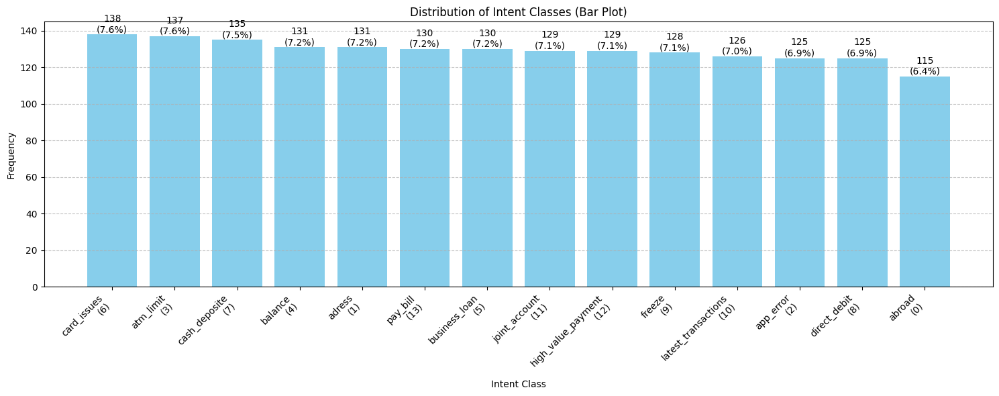

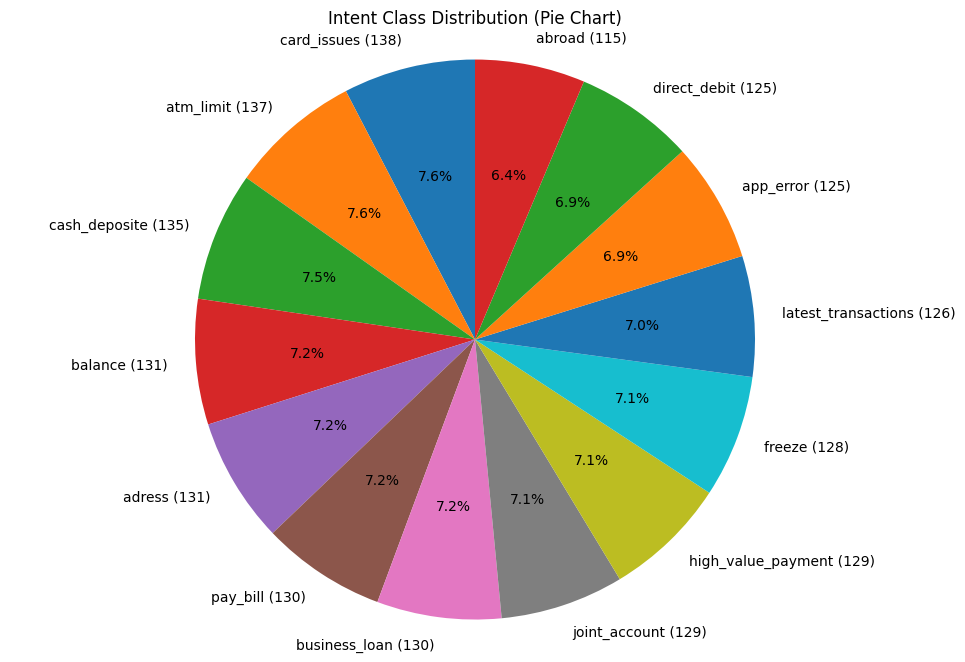

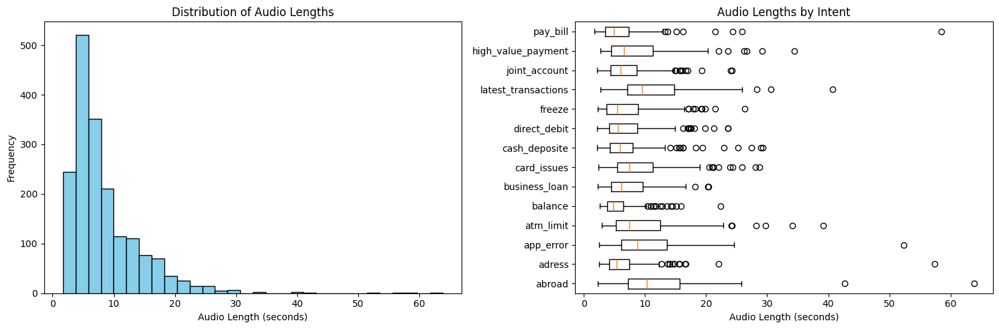

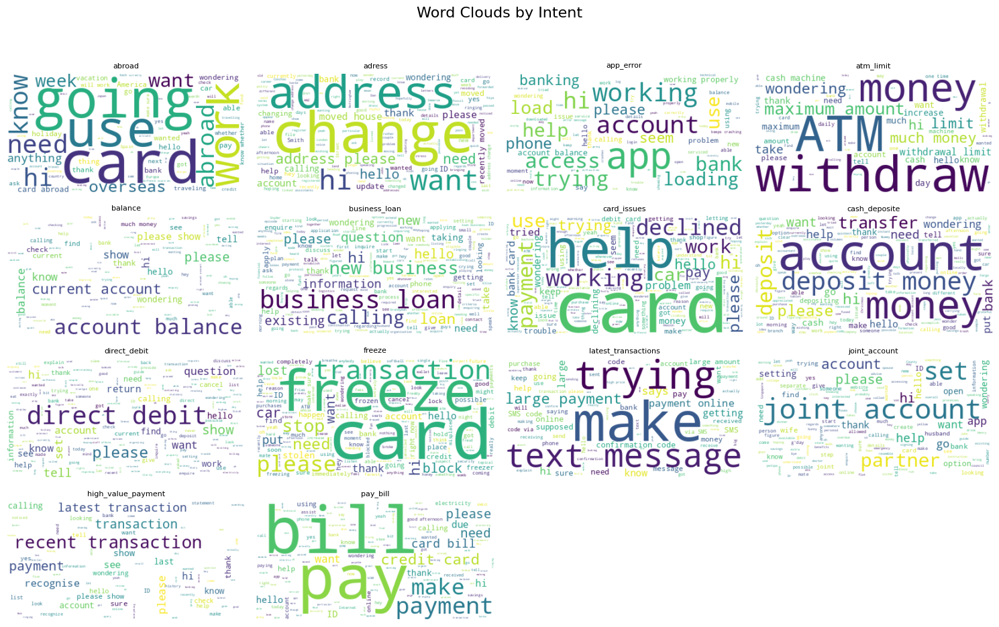

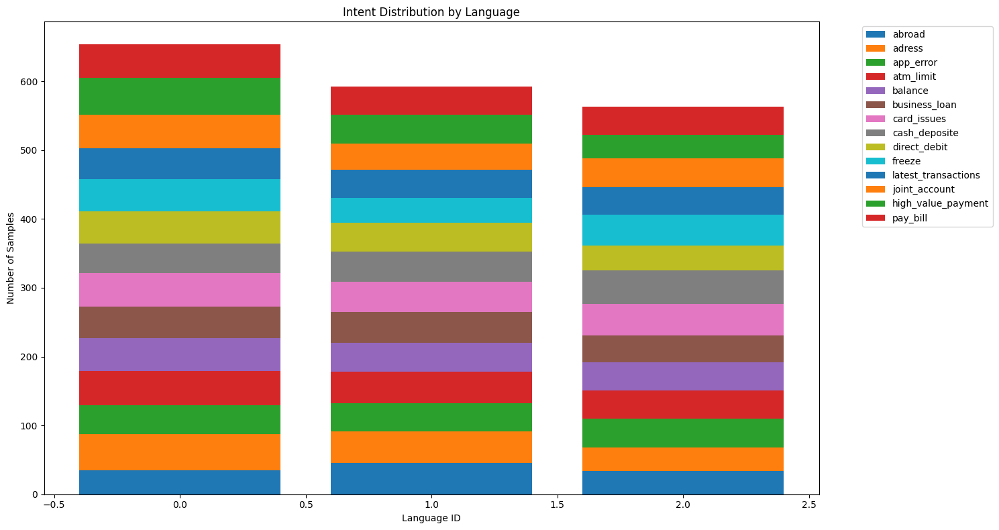

In [ ]:
# Define all possible intent classes with their indices and names
intent_classes = [
    {'index': 0, 'name': 'abroad'},             # Banking abroad queries
    {'index': 1, 'name': 'adress'},             # Address change requests
    {'index': 2, 'name': 'app_error'},          # Mobile app issues
    {'index': 3, 'name': 'atm_limit'},          # ATM withdrawal limits
    {'index': 4, 'name': 'balance'},            # Balance inquiries
    {'index': 5, 'name': 'business_loan'},      # Business loan inquiries
    {'index': 6, 'name': 'card_issues'},        # Card-related problems
    {'index': 7, 'name': 'cash_deposite'},      # Cash deposit queries
    {'index': 8, 'name': 'direct_debit'},       # Direct debit setup/issues
    {'index': 9, 'name': 'freeze'},             # Account freezing requests
    {'index': 10, 'name': 'latest_transactions'},# Transaction history
    {'index': 11, 'name': 'joint_account'},     # Joint account queries
    {'index': 12, 'name': 'high_value_payment'},# Large payment handling
    {'index': 13, 'name': 'pay_bill'}          # Bill payment queries
]

def plot_intent_distributions(dataset, plot_type='all'):
    """
    Create visualizations for intent class distribution

    Args:
        dataset: Dataset to analyze
        plot_type: Type of plot ('bar', 'pie', 'all')

    Creates:
        - Bar plot showing frequency of each intent
        - Pie chart showing proportion of intents
    """
    # Count occurrences of each intent class
    labels = dataset['intent_class']
    label_counts = Counter(labels)

    # Prepare data with intent names and percentages
    sorted_labels = [
        {
            'name': intent_classes[label]['name'],
            'index': intent_classes[label]['index'],
            'count': count,
            'percentage': (count / len(labels)) * 100
        }
        for label, count in sorted(label_counts.items(), key=lambda x: x[1], reverse=True)
    ]

    if plot_type in ['bar', 'all']:
        # Create bar plot
        plt.figure(figsize=(15, 6))
        x_labels = [f"{label['name']}\n({label['index']})" for label in sorted_labels]
        counts = [label['count'] for label in sorted_labels]

        # Add value labels on bars
        bars = plt.bar(x_labels, counts, color='skyblue')
        for bar in bars:
            height = bar.get_height()
            plt.text(bar.get_x() + bar.get_width()/2., height,
                    f'{int(height)}\n({height/len(labels):.1%})',
                    ha='center', va='bottom')

        plt.xlabel('Intent Class')
        plt.ylabel('Frequency')
        plt.title('Distribution of Intent Classes (Bar Plot)')
        plt.xticks(rotation=45, ha='right')
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        plt.tight_layout()
        plt.show()

    if plot_type in ['pie', 'all']:
        # Create pie chart
        plt.figure(figsize=(12, 8))
        plt.pie([label['count'] for label in sorted_labels],
                labels=[f"{label['name']} ({label['count']})" for label in sorted_labels],
                autopct='%1.1f%%',
                startangle=90)
        plt.title('Intent Class Distribution (Pie Chart)')
        plt.axis('equal')
        plt.show()

def plot_audio_analysis(dataset):
    """
    Analyze and visualize audio properties of the dataset

    Creates:
        - Histogram of audio lengths
        - Box plot of audio lengths by intent
    """
    # Calculate duration of each audio sample
    audio_lengths = [len(example['audio']['array']) / example['audio']['sampling_rate']
                    for example in dataset]

    plt.figure(figsize=(15, 5))

    # Create histogram of audio lengths
    plt.subplot(1, 2, 1)
    plt.hist(audio_lengths, bins=30, color='skyblue', edgecolor='black')
    plt.xlabel('Audio Length (seconds)')
    plt.ylabel('Frequency')
    plt.title('Distribution of Audio Lengths')

    # Create box plot grouped by intent
    plt.subplot(1, 2, 2)
    intent_lengths = {intent['name']: [] for intent in intent_classes}
    for example, length in zip(dataset, audio_lengths):
        intent_name = intent_classes[example['intent_class']]['name']
        intent_lengths[intent_name].append(length)

    plt.boxplot([lengths for lengths in intent_lengths.values()],
                labels=[intent['name'] for intent in intent_classes],
                vert=False)
    plt.xlabel('Audio Length (seconds)')
    plt.title('Audio Lengths by Intent')
    plt.tight_layout()
    plt.show()

def create_wordcloud_by_intent(dataset):
    """
    Create word clouds for transcriptions grouped by intent

    Creates:
        - Grid of word clouds showing common words for each intent
    """
    # Group transcriptions by intent class
    intent_texts = {intent['name']: [] for intent in intent_classes}
    for example in dataset:
        intent_name = intent_classes[example['intent_class']]['name']
        intent_texts[intent_name].append(example['transcription'])

    # Generate word clouds
    fig = plt.figure(figsize=(15, 10))
    fig.suptitle('Word Clouds by Intent', fontsize=16)

    for idx, (intent_name, texts) in enumerate(intent_texts.items(), 1):
        if texts:
            combined_text = ' '.join(texts)
            wordcloud = WordCloud(width=400, height=200, background_color='white').generate(combined_text)

            plt.subplot(4, 4, idx)
            plt.imshow(wordcloud, interpolation='bilinear')
            plt.axis('off')
            plt.title(intent_name, fontsize=8)

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

def plot_language_comparison(dataset):
    """
    Compare intent distributions across different language variants

    Creates:
        - Stacked bar chart showing intent distribution per language
    """
    # Count intents per language
    lang_intent_counts = {}
    for example in dataset:
        lang_id = example['lang_id']
        intent = intent_classes[example['intent_class']]['name']
        if lang_id not in lang_intent_counts:
            lang_intent_counts[lang_id] = Counter()
        lang_intent_counts[lang_id][intent] += 1

    # Create stacked bar visualization
    plt.figure(figsize=(15, 8))
    bottom = np.zeros(len(lang_intent_counts))

    for intent in [intent['name'] for intent in intent_classes]:
        values = [lang_intent_counts[lang_id][intent] for lang_id in sorted(lang_intent_counts.keys())]
        plt.bar(range(len(lang_intent_counts)), values, bottom=bottom, label=intent)
        bottom += values

    plt.xlabel('Language ID')
    plt.ylabel('Number of Samples')
    plt.title('Intent Distribution by Language')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

# Generate all visualizations if dataset is available
if merged_dataset:
    plot_intent_distributions(merged_dataset, 'all')
    plot_audio_analysis(merged_dataset)
    create_wordcloud_by_intent(merged_dataset)
    plot_language_comparison(merged_dataset)

## 5b. Visualize Waveform and Spectogram

=== Starting Waveform and Spectogram Analysis for All Intents ===


Analyzing Intent: abroad (Class 0)

Transcription: yes I'm going to be traveling to the United Kingdom for a couple of weeks next month I need to know if I can use my card from from my bank account while I'm in Europe
English Transcription: yes I'm going to be traveling to the United Kingdom for a couple of weeks next month I need to know if I can use my card from from my bank account while I'm in Europe
Duration: 17.834625 seconds


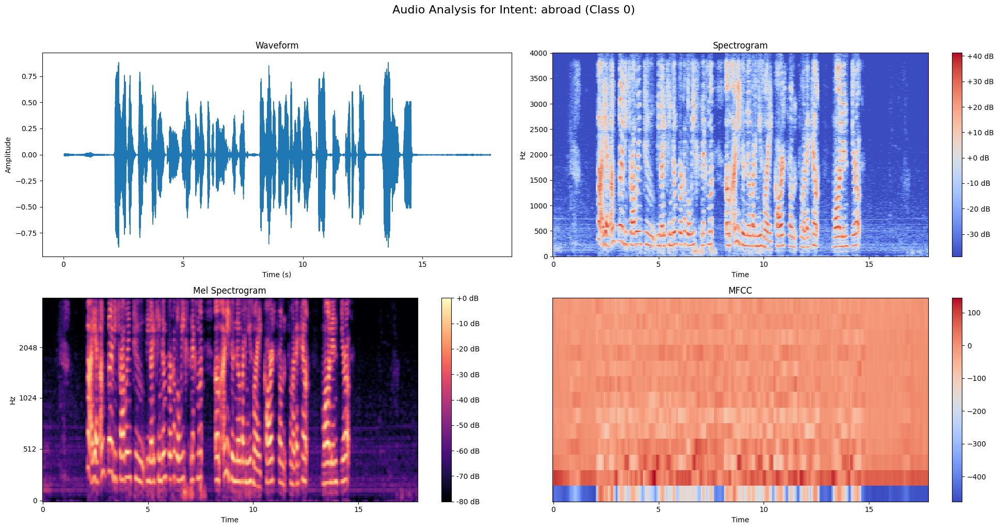


Analyzing Intent: adress (Class 1)

Transcription: hi yes I like to change my address
English Transcription: hi yes I like to change my address
Duration: 4.266625 seconds


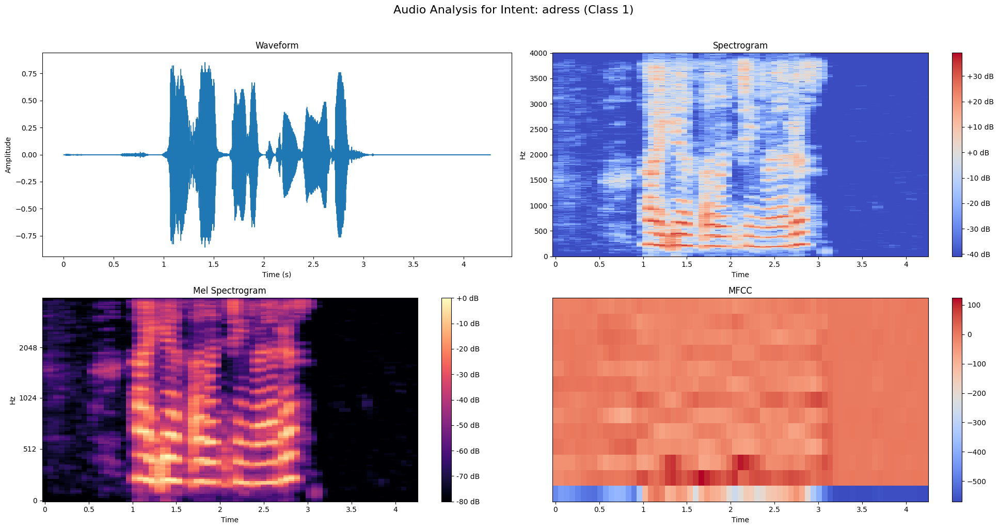


Analyzing Intent: app_error (Class 2)

Transcription: high on the app isn't loading information
English Transcription: high on the app isn't loading information
Duration: 5.376 seconds


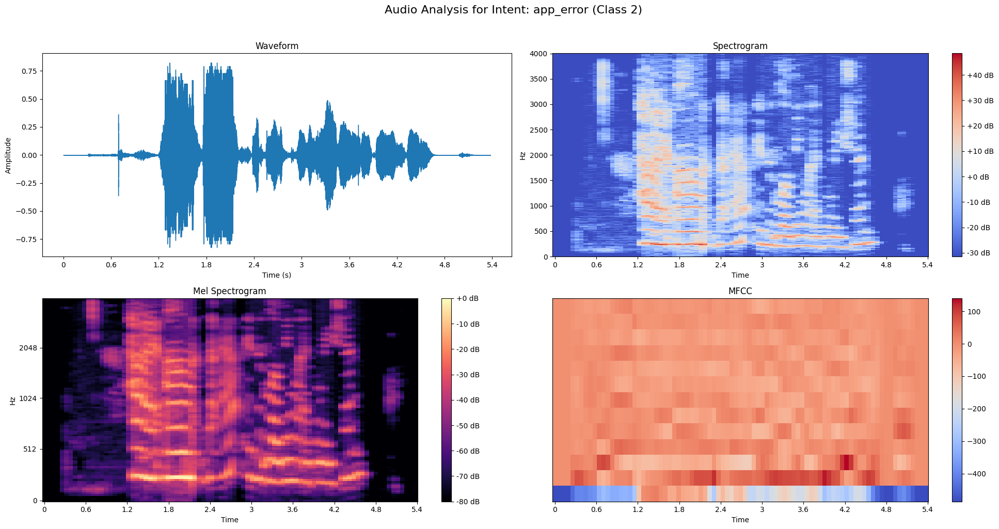


Analyzing Intent: atm_limit (Class 3)

Transcription: how much money can I withdraw per day from the ATM
English Transcription: how much money can I withdraw per day from the ATM
Duration: 4.551125 seconds


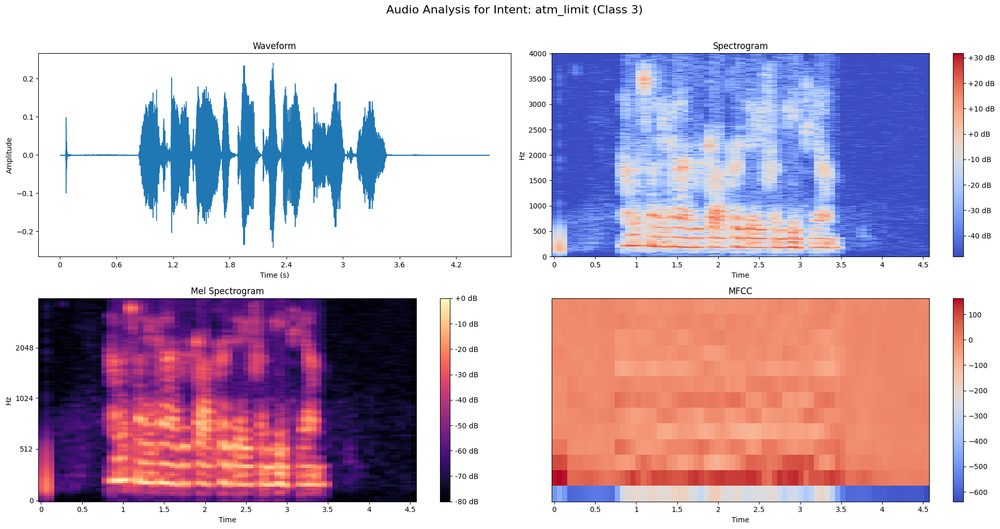


Analyzing Intent: balance (Class 4)

Transcription: what is my account balance
English Transcription: what is my account balance
Duration: 4.365375 seconds


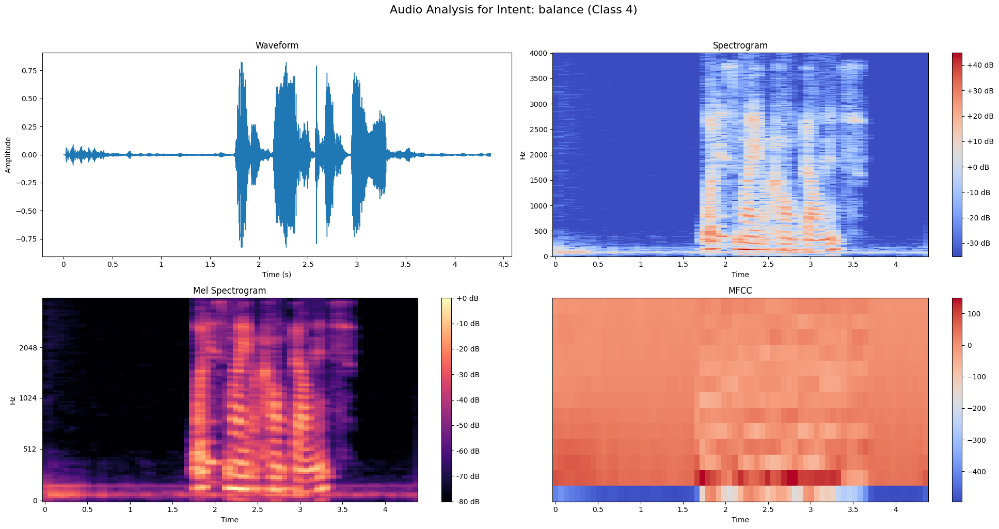


Analyzing Intent: business_loan (Class 5)

Transcription: I'm calling to inquire about a business loan
English Transcription: I'm calling to inquire about a business loan
Duration: 6.485375 seconds


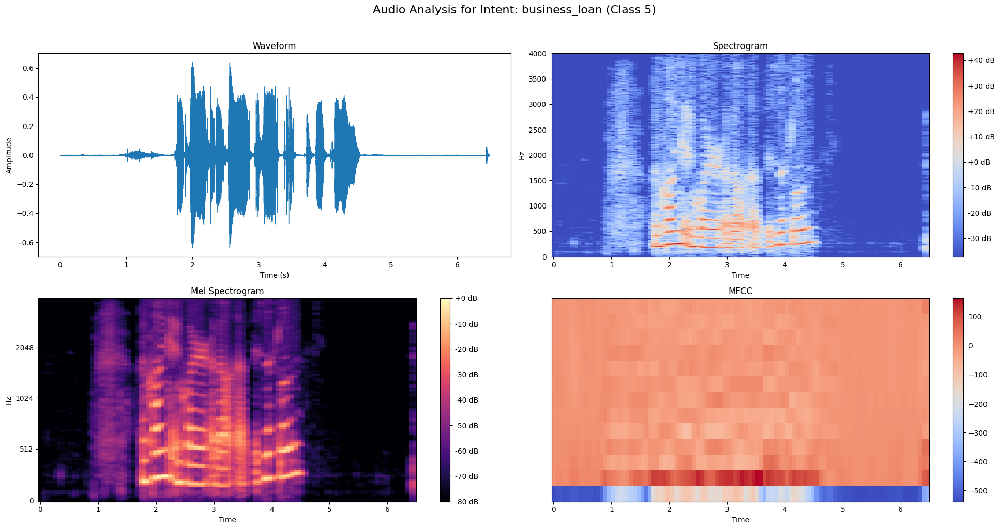


Analyzing Intent: card_issues (Class 6)

Transcription: I'm trying to say something is my car doesn't seem to work whenever I called do it it doesn't actually work
English Transcription: I'm trying to say something is my car doesn't seem to work whenever I called do it it doesn't actually work
Duration: 13.653375 seconds


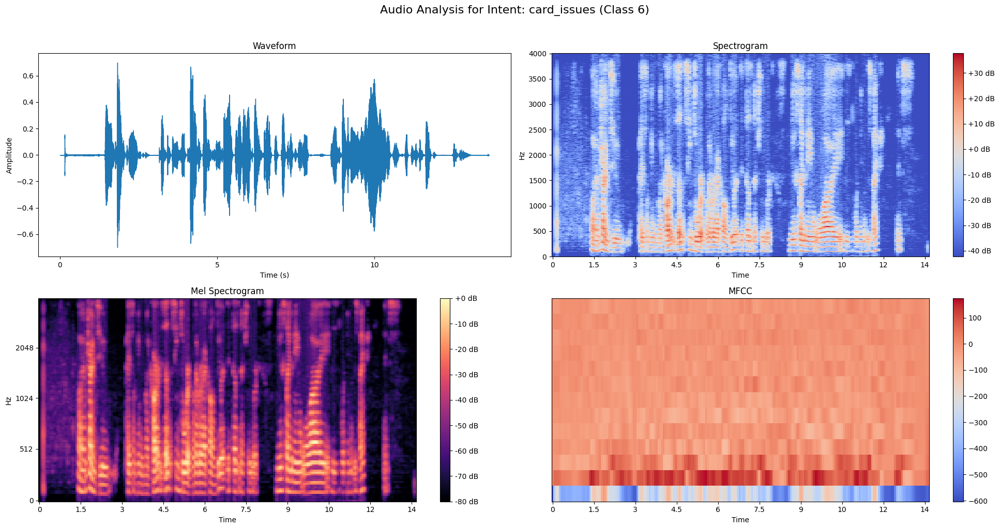


Analyzing Intent: cash_deposite (Class 7)

Transcription: transfer money to the account
English Transcription: transfer money to the account
Duration: 4.437375 seconds


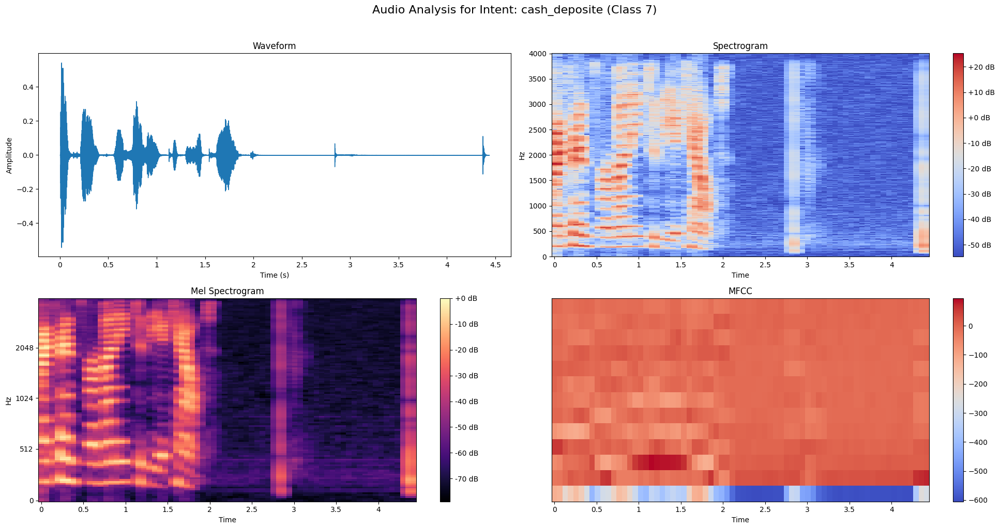


Analyzing Intent: direct_debit (Class 8)

Transcription: I'm having trouble understanding what a direct debit is to provide through Clarity and information for me
English Transcription: I'm having trouble understanding what a direct debit is to provide through Clarity and information for me
Duration: 8.874625 seconds


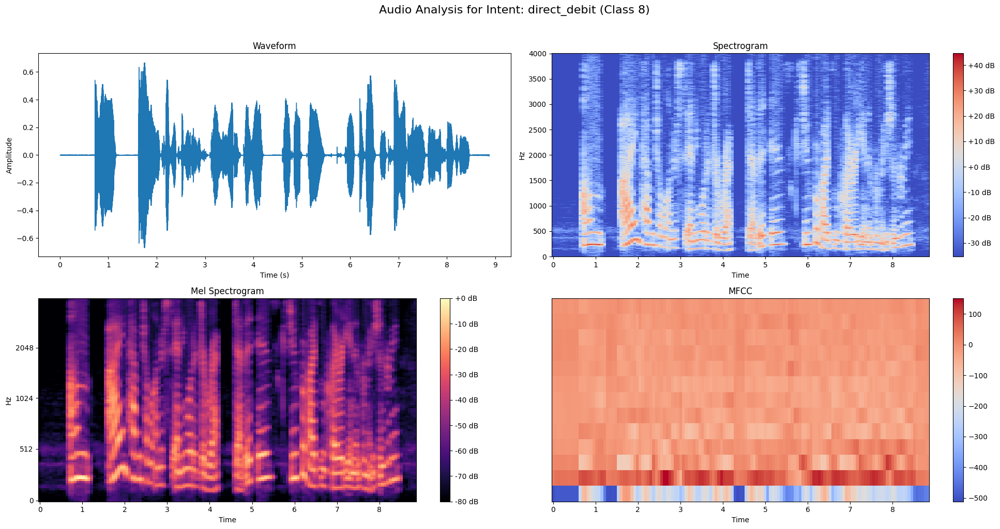


Analyzing Intent: freeze (Class 9)

Transcription: oh yeah hi I need fastest topical transactions on my card freeze my card block my card or something
English Transcription: oh yeah hi I need fastest topical transactions on my card freeze my card block my card or something
Duration: 8.96 seconds


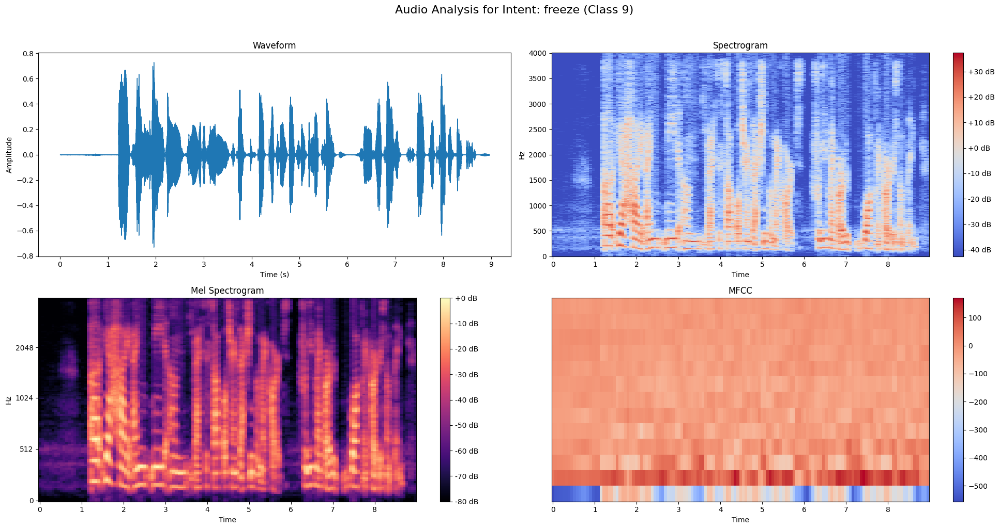


Analyzing Intent: latest_transactions (Class 10)

Transcription: how do I confirm a large email with a text message
English Transcription: how do I confirm a large email with a text message
Duration: 4.778625 seconds


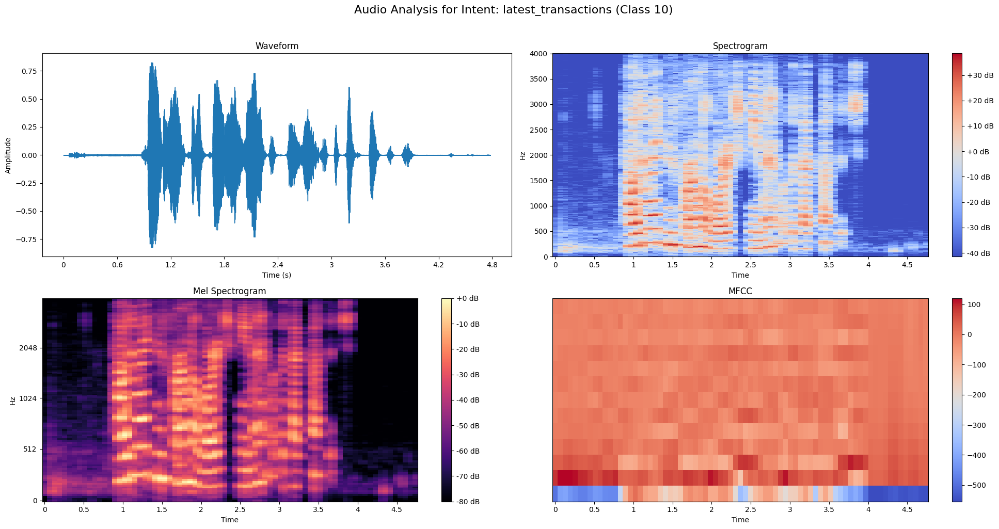


Analyzing Intent: joint_account (Class 11)

Transcription: I would like to set up a joint account with my partner
English Transcription: I would like to set up a joint account with my partner
Duration: 10.837375 seconds


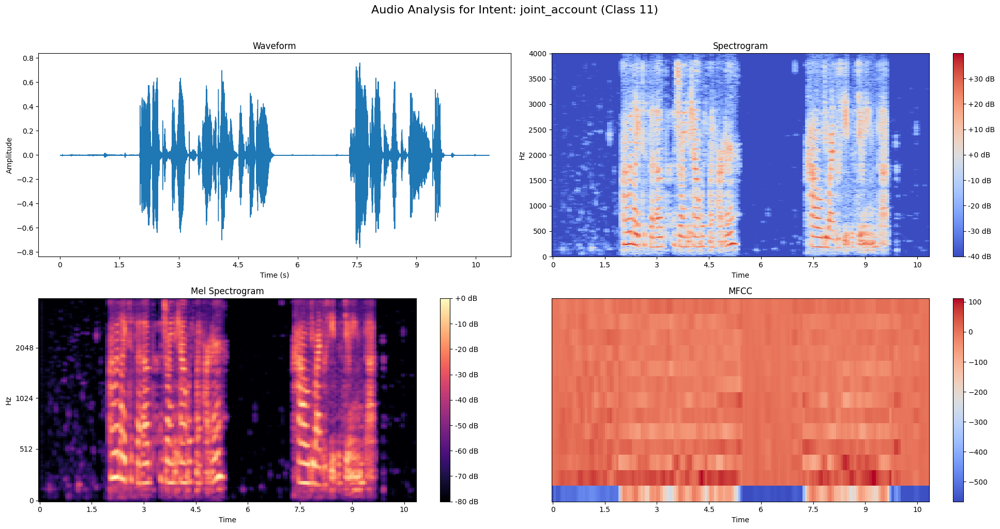


Analyzing Intent: high_value_payment (Class 12)

Transcription: tell me about recent transactions on my card
English Transcription: tell me about recent transactions on my card
Duration: 3.925375 seconds


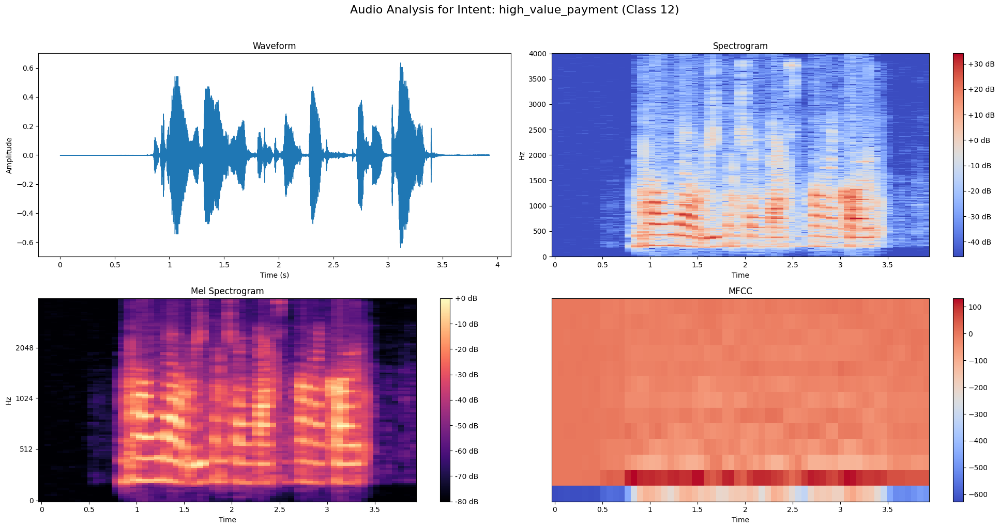


Analyzing Intent: pay_bill (Class 13)

Transcription: I would like to make a down payment
English Transcription: I would like to make a down payment
Duration: 3.584 seconds


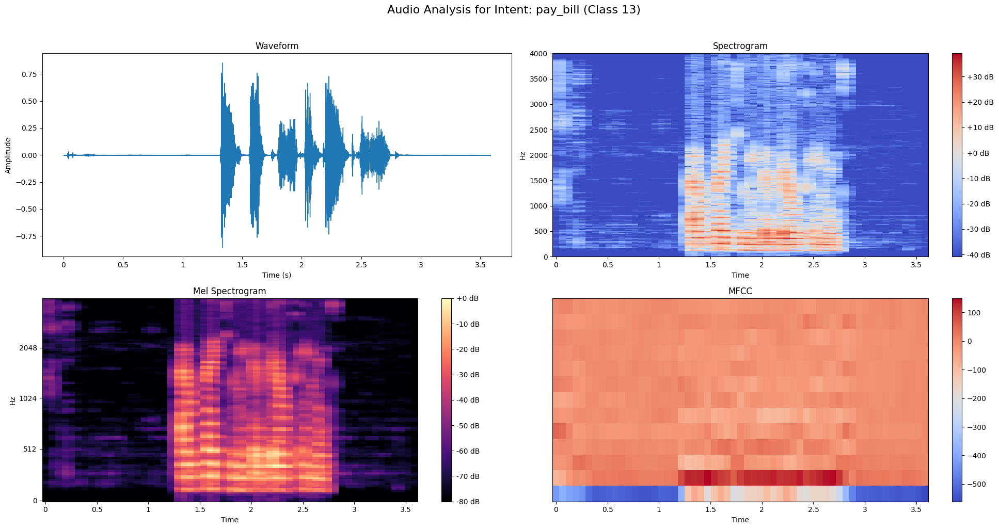

In [ ]:
def plot_waveform_and_spectrogram(dataset, intent_class, name_intent, figsize=(20, 10)):
    """
    Create comprehensive audio visualizations for a given intent class

    Args:
        dataset: Dataset containing audio samples
        intent_class: Intent class index
        name_intent: Name of the intent class
        figsize: Figure size for plots

    Creates:
        - Waveform plot (time domain representation)
        - Spectrogram (frequency domain over time)
        - Mel Spectrogram (perceptual frequency scale)
        - MFCC (Mel-frequency cepstral coefficients)
    """
    # Get samples for specific intent
    filtered_data = dataset.filter(lambda example: example['intent_class'] == intent_class)

    if len(filtered_data) == 0:
        print(f"No samples found for intent class {intent_class} ({name_intent})")
        return

    # Get first sample's audio data
    sample = filtered_data[0]
    audio_array = sample['audio']['array']
    sr = sample['audio']['sampling_rate']

    # Create main figure
    fig = plt.figure(figsize=figsize)
    fig.suptitle(f'Audio Analysis for Intent: {name_intent} (Class {intent_class})',
                fontsize=16, y=1.02)
    # 1. Waveform visualization
    plt.subplot(2, 2, 1)
    librosa.display.waveshow(audio_array, sr=sr)
    plt.title('Waveform')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')

    # 2. Standard Spectrogram
    plt.subplot(2, 2, 2)
    X = librosa.stft(audio_array)  # Short-time Fourier transform
    Xdb = librosa.amplitude_to_db(abs(X))  # Convert to decibels
    librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Spectrogram')

    # 3. Mel Spectrogram
    plt.subplot(2, 2, 3)
    mel_spect = librosa.feature.melspectrogram(y=audio_array, sr=sr)
    mel_spect_db = librosa.power_to_db(mel_spect, ref=np.max)
    librosa.display.specshow(mel_spect_db, sr=sr, x_axis='time', y_axis='mel')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Mel Spectrogram')

    # 4. MFCC (Mel-frequency cepstral coefficients)
    plt.subplot(2, 2, 4)
    mfccs = librosa.feature.mfcc(y=audio_array, sr=sr, n_mfcc=13)
    librosa.display.specshow(mfccs, sr=sr, x_axis='time')
    plt.colorbar()
    plt.title('MFCC')

    plt.tight_layout()

    # Print transcription
    print("\nTranscription:", sample['transcription'])
    print("English Transcription:", sample['english_transcription'])
    print("Duration:", len(audio_array)/sr, "seconds")

    # Display audio player
    display(ipd.Audio(data=audio_array, rate=sr))

    plt.show()

def analyze_all_intents(dataset, intent_classes):
    """
    Analyze audio samples for all intent classes

    Args:
        dataset: The dataset containing audio samples
        intent_classes: List of intent class dictionaries
    """
    print("=== Starting Waveform and Spectogram Analysis for All Intents ===\n")

    for intent in intent_classes:
        print(f"\n{'='*50}")
        print(f"Analyzing Intent: {intent['name']} (Class {intent['index']})")
        print(f"{'='*50}")

        plot_waveform_and_spectrogram(dataset,
                                    intent['index'],
                                    intent['name'])

        # Add a small delay to prevent display issues
        plt.close('all')

# Define intent classes
intent_classes = [
    {'index': 0, 'name': 'abroad'},
    {'index': 1, 'name': 'adress'},
    {'index': 2, 'name': 'app_error'},
    {'index': 3, 'name': 'atm_limit'},
    {'index': 4, 'name': 'balance'},
    {'index': 5, 'name': 'business_loan'},
    {'index': 6, 'name': 'card_issues'},
    {'index': 7, 'name': 'cash_deposite'},
    {'index': 8, 'name': 'direct_debit'},
    {'index': 9, 'name': 'freeze'},
    {'index': 10, 'name': 'latest_transactions'},
    {'index': 11, 'name': 'joint_account'},
    {'index': 12, 'name': 'high_value_payment'},
    {'index': 13, 'name': 'pay_bill'}
]

# Analyze all intents
if merged_dataset:
    analyze_all_intents(merged_dataset, intent_classes)

## 5c. Audio Feature Analysis with Chroma and FFT

=== Starting Audio Feature Analysis with Chroma and FFT for All Intents ===


Analyzing Intent: abroad (Class 0)

Audio Information:
Duration: 17.83 seconds
Sampling Rate: 8000 Hz
Transcription: yes I'm going to be traveling to the United Kingdom for a couple of weeks next month I need to know if I can use my card from from my bank account while I'm in Europe


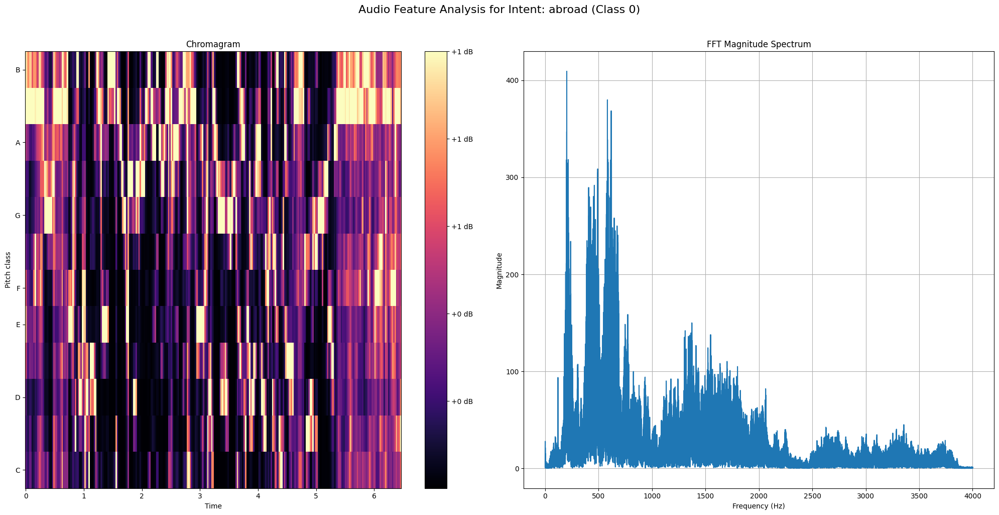


Analyzing Intent: adress (Class 1)

Audio Information:
Duration: 4.27 seconds
Sampling Rate: 8000 Hz
Transcription: hi yes I like to change my address


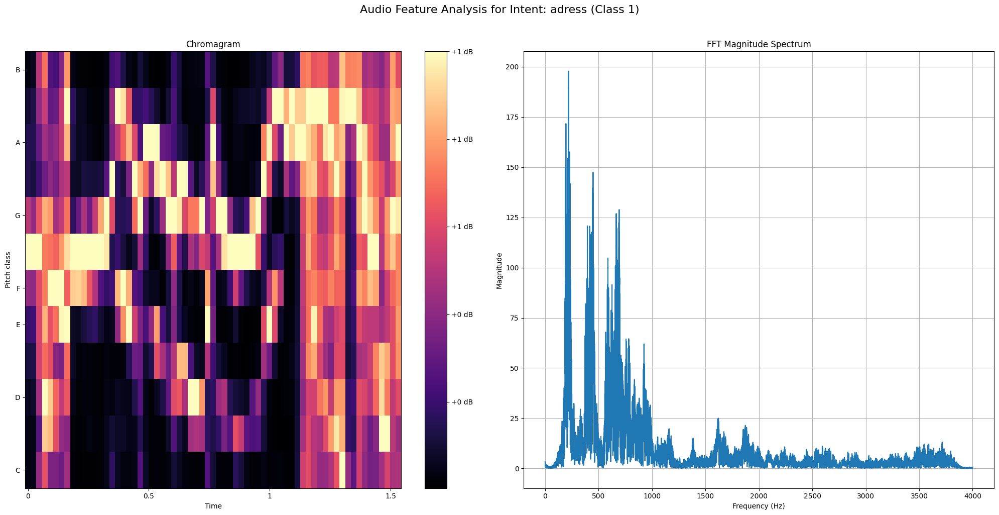


Analyzing Intent: app_error (Class 2)

Audio Information:
Duration: 5.38 seconds
Sampling Rate: 8000 Hz
Transcription: high on the app isn't loading information


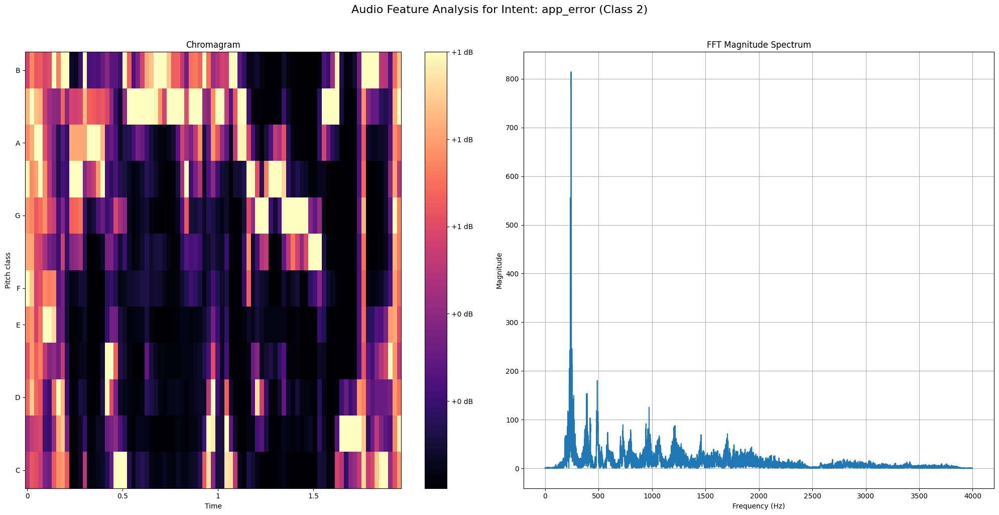


Analyzing Intent: atm_limit (Class 3)

Audio Information:
Duration: 4.55 seconds
Sampling Rate: 8000 Hz
Transcription: how much money can I withdraw per day from the ATM


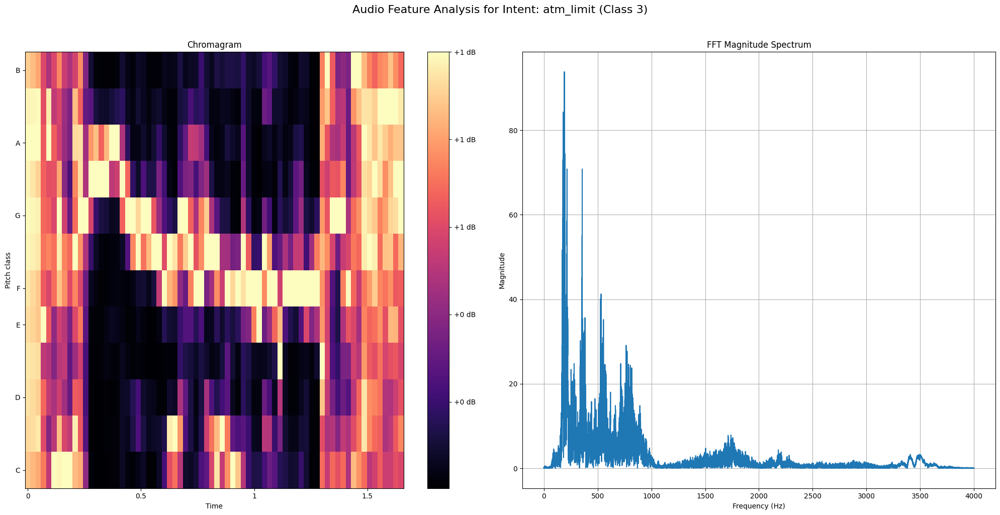


Analyzing Intent: balance (Class 4)

Audio Information:
Duration: 4.37 seconds
Sampling Rate: 8000 Hz
Transcription: what is my account balance


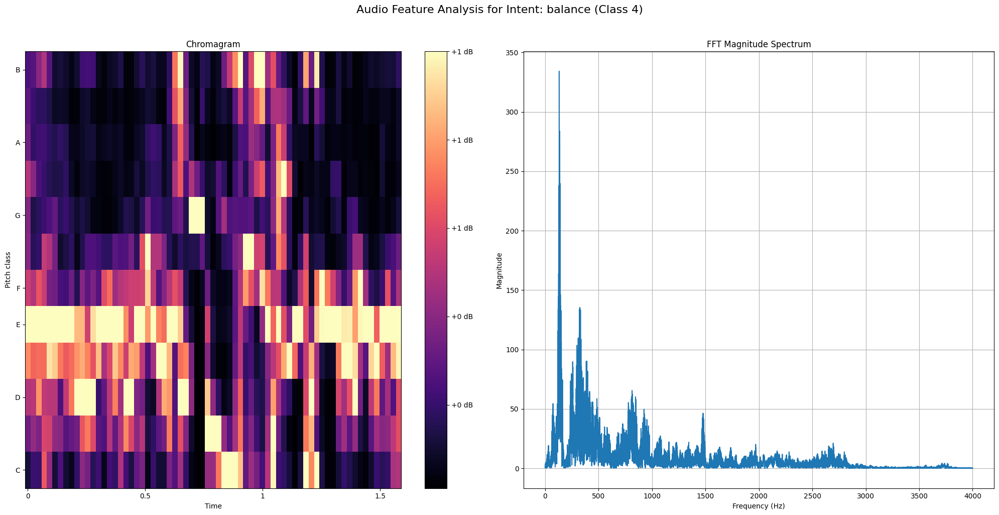


Analyzing Intent: business_loan (Class 5)

Audio Information:
Duration: 6.49 seconds
Sampling Rate: 8000 Hz
Transcription: I'm calling to inquire about a business loan


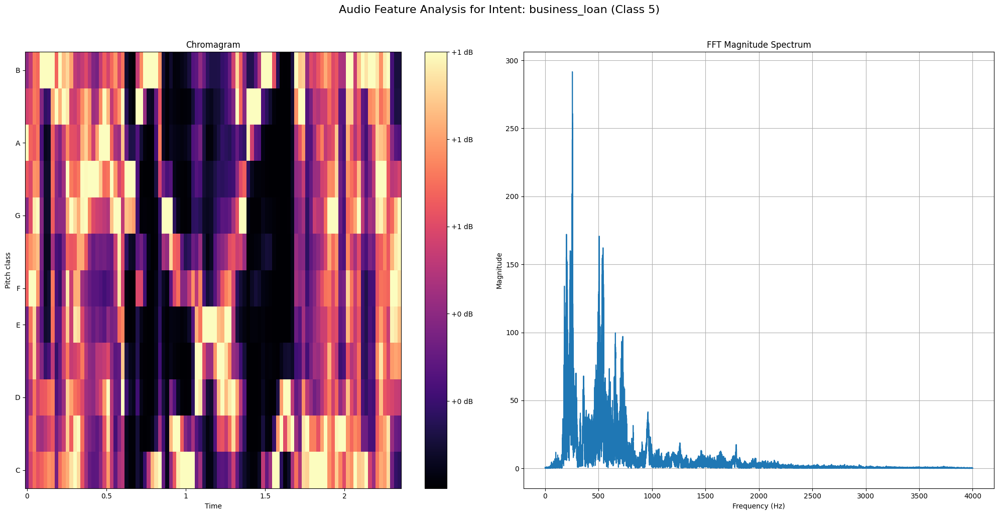


Analyzing Intent: card_issues (Class 6)

Audio Information:
Duration: 13.65 seconds
Sampling Rate: 8000 Hz
Transcription: I'm trying to say something is my car doesn't seem to work whenever I called do it it doesn't actually work


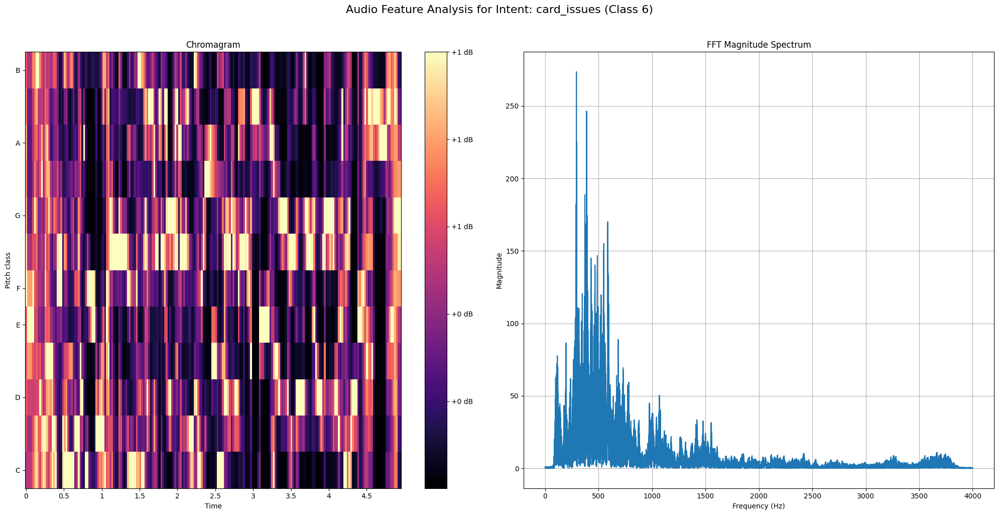


Analyzing Intent: cash_deposite (Class 7)

Audio Information:
Duration: 4.44 seconds
Sampling Rate: 8000 Hz
Transcription: transfer money to the account


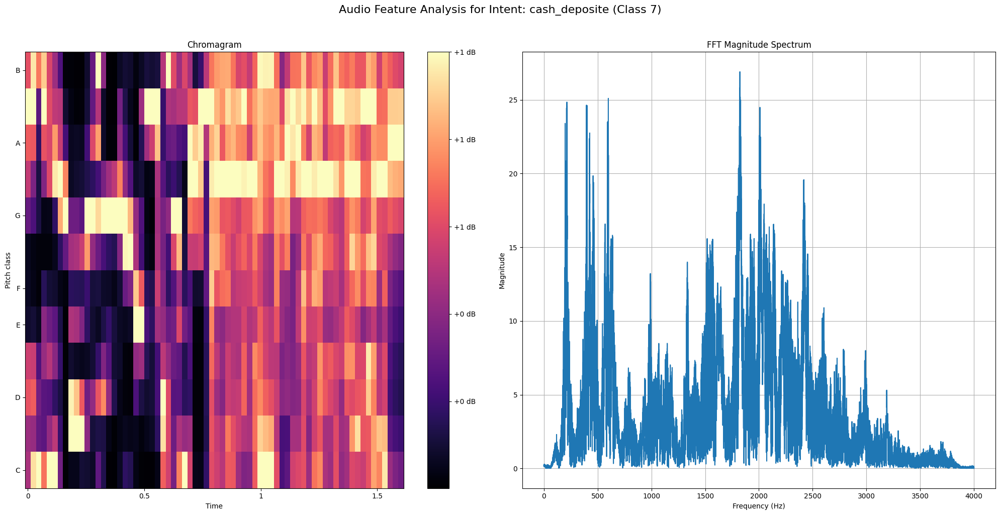


Analyzing Intent: direct_debit (Class 8)

Audio Information:
Duration: 8.87 seconds
Sampling Rate: 8000 Hz
Transcription: I'm having trouble understanding what a direct debit is to provide through Clarity and information for me


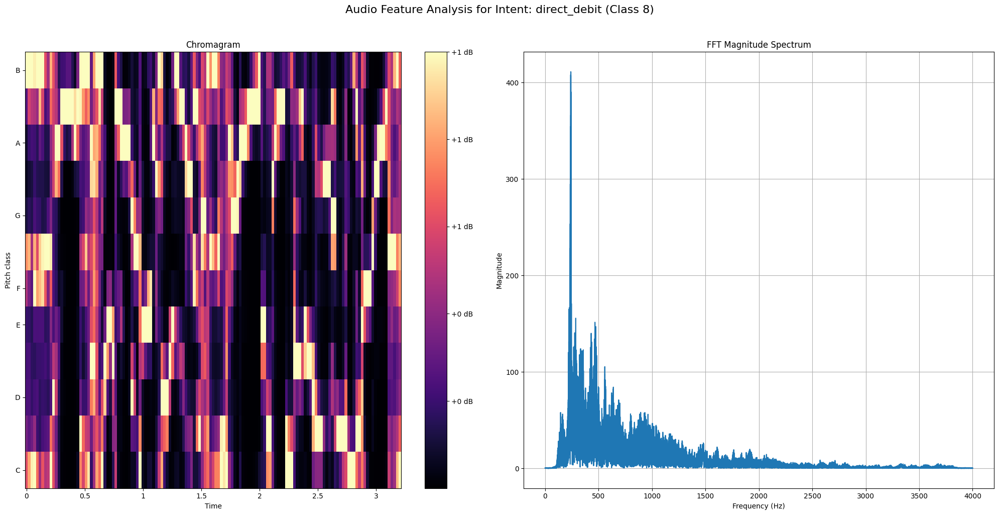


Analyzing Intent: freeze (Class 9)

Audio Information:
Duration: 8.96 seconds
Sampling Rate: 8000 Hz
Transcription: oh yeah hi I need fastest topical transactions on my card freeze my card block my card or something


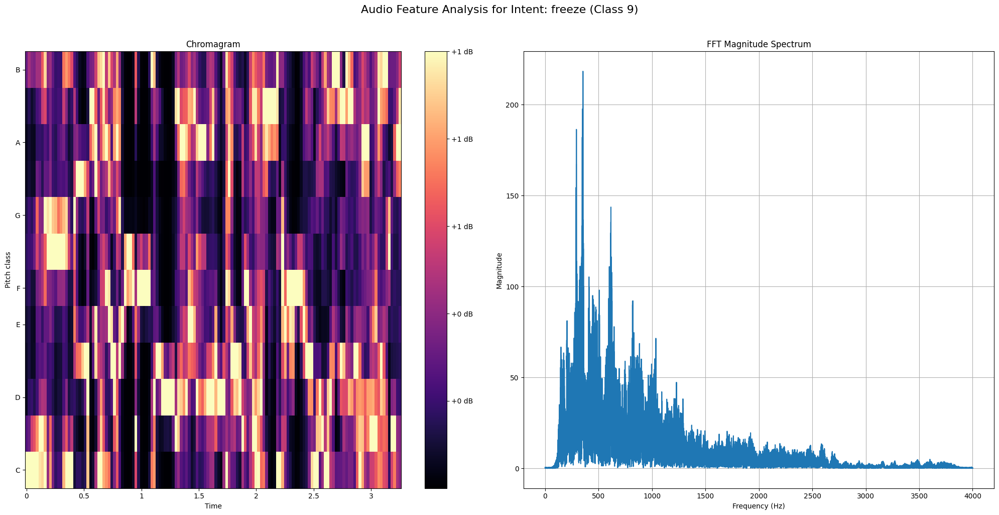


Analyzing Intent: latest_transactions (Class 10)

Audio Information:
Duration: 4.78 seconds
Sampling Rate: 8000 Hz
Transcription: how do I confirm a large email with a text message


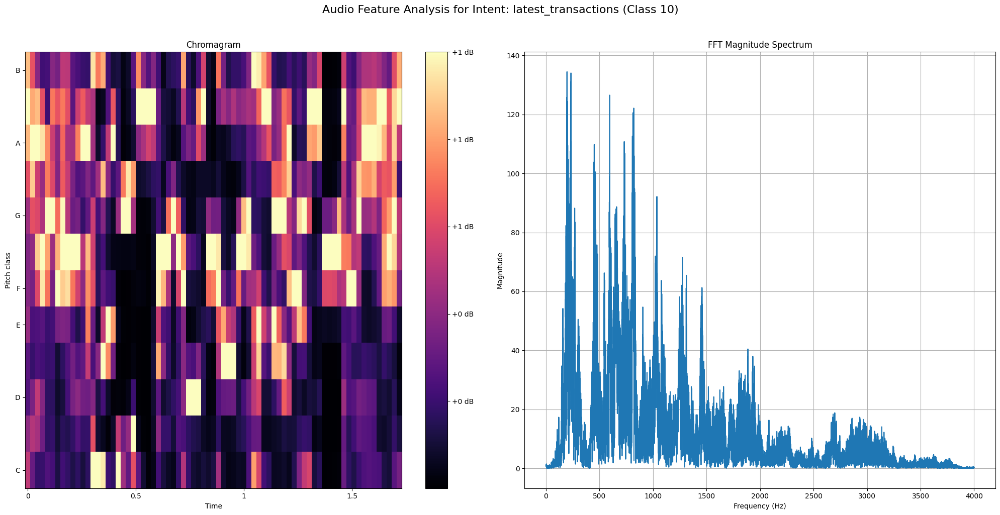


Analyzing Intent: joint_account (Class 11)

Audio Information:
Duration: 10.84 seconds
Sampling Rate: 8000 Hz
Transcription: I would like to set up a joint account with my partner


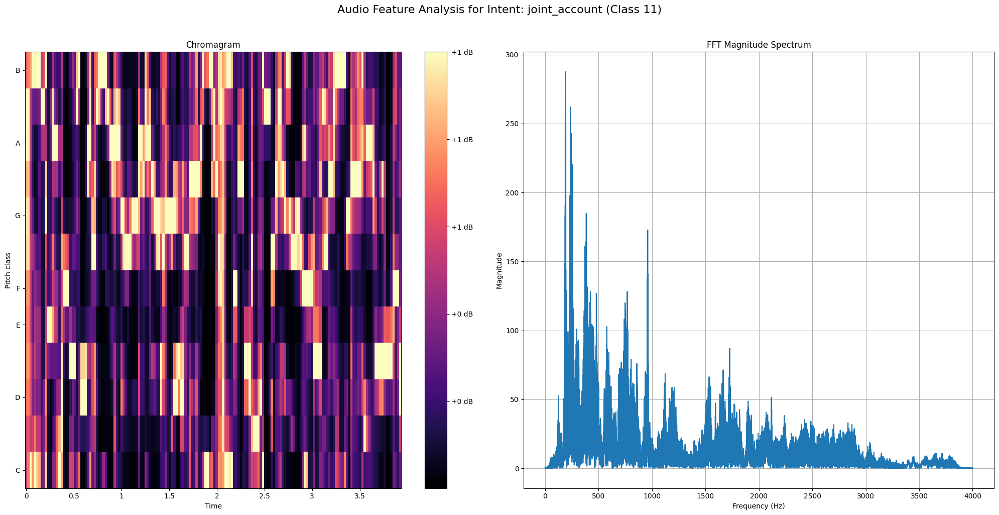


Analyzing Intent: high_value_payment (Class 12)

Audio Information:
Duration: 3.93 seconds
Sampling Rate: 8000 Hz
Transcription: tell me about recent transactions on my card


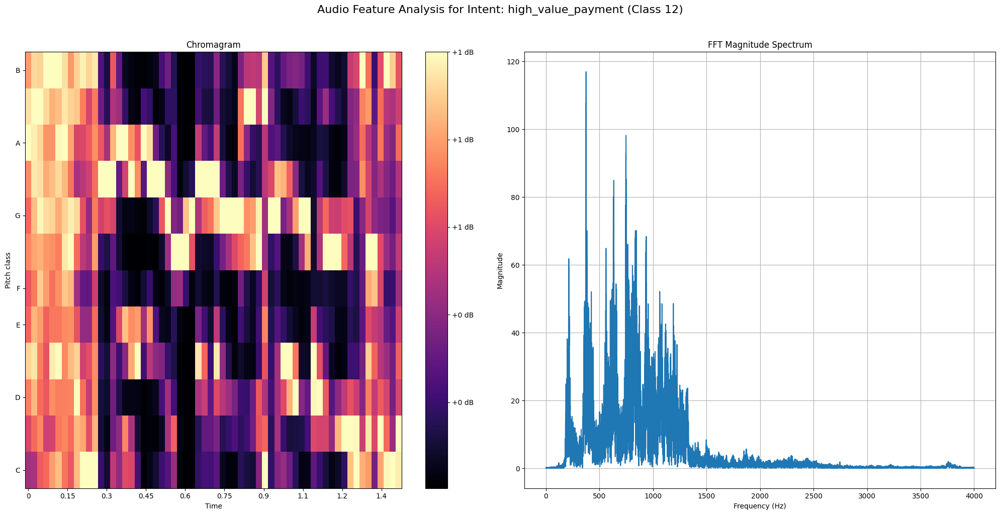


Analyzing Intent: pay_bill (Class 13)

Audio Information:
Duration: 3.58 seconds
Sampling Rate: 8000 Hz
Transcription: I would like to make a down payment


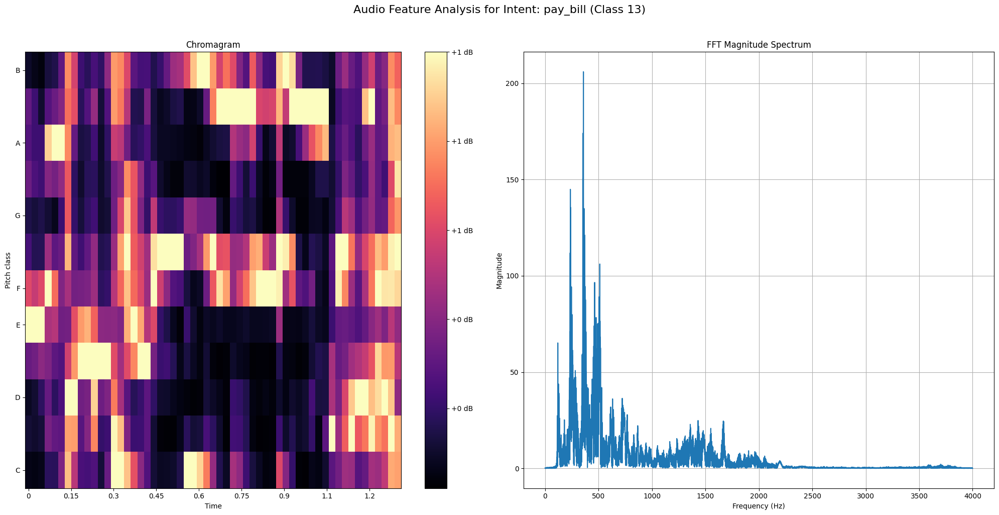

In [ ]:
def plot_chroma_and_fft(dataset, intent_class, name_intent, figsize=(20, 10)):
    """
    Create chromagram and FFT analysis for a given intent class

    Args:
        dataset: Dataset containing audio samples
        intent_class: Intent class index
        name_intent: Name of the intent class
        figsize: Figure size for plots

    Creates:
        - Chromagram (pitch class distribution)
        - FFT magnitude spectrum
    """
    # Filter for specific intent
    filtered_data = dataset.filter(lambda example: example['intent_class'] == intent_class)

    if len(filtered_data) == 0:
        print(f"No samples found for intent class {intent_class} ({name_intent})")
        return

    # Get audio data
    sample = filtered_data[0]
    audio_array = sample['audio']['array']
    sr = sample['audio']['sampling_rate']

    # Create figure with two subplots side by side
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=figsize)
    fig.suptitle(f'Audio Feature Analysis for Intent: {name_intent} (Class {intent_class})',
                fontsize=16, y=1.02)

    # 1. Chromagram
    chroma = librosa.feature.chroma_stft(y=audio_array, sr=sr)
    img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time', ax=ax1)
    fig.colorbar(img, ax=ax1, format='%+2.0f dB')
    ax1.set_title('Chromagram')

    # 2. FFT Magnitude Spectrum
    fft = np.abs(np.fft.rfft(audio_array))
    freq = np.fft.rfftfreq(len(audio_array), 1/sr)
    ax2.plot(freq, fft)
    ax2.set_xlabel('Frequency (Hz)')
    ax2.set_ylabel('Magnitude')
    ax2.set_title('FFT Magnitude Spectrum')
    ax2.grid(True)

    # Adjust layout to prevent overlap
    plt.tight_layout()

    # Print audio information
    print("\nAudio Information:")
    print(f"Duration: {len(audio_array)/sr:.2f} seconds")
    print(f"Sampling Rate: {sr} Hz")
    print(f"Transcription: {sample['transcription']}")

    # Display the figure
    plt.show()

def analyze_all_intents(dataset, intent_classes):
    """
    Perform comprehensive audio analysis for all intent classes

    Args:
        dataset: Dataset containing audio samples
        intent_classes: List of intent class information
    """
    print("=== Starting Audio Feature Analysis with Chroma and FFT for All Intents ===\n")

    for intent in intent_classes:
        print(f"\n{'='*50}")
        print(f"Analyzing Intent: {intent['name']} (Class {intent['index']})")
        print(f"{'='*50}")

        # Advanced audio analysis
        plot_chroma_and_fft(dataset, intent['index'], intent['name'])

        # Ensure all plots are closed before next iteration
        plt.close('all')

# Define intent classes for banking domain
intent_classes = [
    {'index': 0, 'name': 'abroad'},
    {'index': 1, 'name': 'adress'},
    {'index': 2, 'name': 'app_error'},
    {'index': 3, 'name': 'atm_limit'},
    {'index': 4, 'name': 'balance'},
    {'index': 5, 'name': 'business_loan'},
    {'index': 6, 'name': 'card_issues'},
    {'index': 7, 'name': 'cash_deposite'},
    {'index': 8, 'name': 'direct_debit'},
    {'index': 9, 'name': 'freeze'},
    {'index': 10, 'name': 'latest_transactions'},
    {'index': 11, 'name': 'joint_account'},
    {'index': 12, 'name': 'high_value_payment'},
    {'index': 13, 'name': 'pay_bill'}
]

# Run analysis if dataset is available
if merged_dataset:
    analyze_all_intents(merged_dataset, intent_classes)

## 5d. Null Value Check

In [ ]:
merged_dataset.features  # Display all available features in dataset

{'path': Value(dtype='string', id=None),
 'audio': Audio(sampling_rate=8000, mono=True, decode=True, id=None),
 'transcription': Value(dtype='string', id=None),
 'english_transcription': Value(dtype='string', id=None),
 'intent_class': ClassLabel(names=['abroad', 'address', 'app_error', 'atm_limit', 'balance', 'business_loan', 'card_issues', 'cash_deposit', 'direct_debit', 'freeze', 'high_value_payment', 'joint_account', 'latest_transactions', 'pay_bill'], id=None),
 'lang_id': ClassLabel(names=['cs-CZ', 'de-DE', 'en-AU', 'en-GB', 'en-US', 'es-ES', 'fr-FR', 'it-IT', 'ko-KR', 'nl-NL', 'pl-PL', 'pt-PT', 'ru-RU', 'zh-CN'], id=None)}

In [ ]:
# Print details of first item in dataset to understand structure
print(merged_dataset['path'][0])               # File path of audio
print(merged_dataset['audio'][0])              # Audio data (array and sampling rate)
print(merged_dataset['transcription'][0])      # Original transcription
print(merged_dataset['english_transcription'][0])  # Standardized English version
print(merged_dataset['intent_class'][0])       # Intent classification number
print(merged_dataset['lang_id'][0])            # Language identifier

/storage/hf-datasets-cache/all/datasets/51125457981586-config-parquet-and-info-PolyAI-minds14-efce24e3/downloads/extracted/cfd42a9443ffb9548ee39e3c64f8b512ca72b9ce5e2ea6b981d44ba6c7265ae8/en-US~JOINT_ACCOUNT/602ba55abb1e6d0fbce92065.wav
{'path': '602ba55abb1e6d0fbce92065.wav', 'array': array([ 0.        ,  0.00024414, -0.00024414, ..., -0.00024414,
        0.        ,  0.        ]), 'sampling_rate': 8000}
I would like to set up a joint account with my partner
I would like to set up a joint account with my partner
11
4


In [ ]:
def count_feature_lengths(dataset):
    """
    Count lengths of features in dataset

    Args:
        dataset: Dataset to analyze

    Returns:
        dict: Dictionary of feature lengths
    """
    feature_lengths = {}

    # Iterate through each feature and count lengths
    for feature in dataset.features:
        values = dataset[feature]
        # Convert to string length unless numeric/complex type
        lengths = [len(str(value)) if not isinstance(value, (int, float, dict, list))
                  else 1 for value in values]
        feature_lengths[feature] = lengths
    return feature_lengths

# Analyze feature lengths for different datasets
# Merged dataset analysis
feature_lengths = count_feature_lengths(merged_dataset)
print("\nMerged Dataset Feature Lengths:")
for feature, lengths in feature_lengths.items():
    print(f"{feature}: {len(lengths)}")  # Print count for each feature


Merged Dataset Feature Lengths:
path: 1809
audio: 1809
transcription: 1809
english_transcription: 1809
intent_class: 1809
lang_id: 1809


In [ ]:
# US English dataset analysis
feature_lengths = count_feature_lengths(us_data)
print("\nUS English Dataset Feature Lengths:")
for feature, lengths in feature_lengths.items():
    print(f"{feature}: {len(lengths)}")


US English Dataset Feature Lengths:
path: 563
audio: 563
transcription: 563
english_transcription: 563
intent_class: 563
lang_id: 563


In [ ]:
# Australian English dataset analysis
feature_lengths = count_feature_lengths(au_data)
print("\nAustralian English Dataset Feature Lengths:")
for feature, lengths in feature_lengths.items():
    print(f"{feature}: {len(lengths)}")


Australian English Dataset Feature Lengths:
path: 654
audio: 654
transcription: 654
english_transcription: 654
intent_class: 654
lang_id: 654


In [ ]:
# British English dataset analysis
feature_lengths = count_feature_lengths(gb_data)
print("\nBritish English Dataset Feature Lengths:")
for feature, lengths in feature_lengths.items():
    print(f"{feature}: {len(lengths)}")


British English Dataset Feature Lengths:
path: 592
audio: 592
transcription: 592
english_transcription: 592
intent_class: 592
lang_id: 592


In [ ]:
def check_null_values(dataset):
    """
    Check for null values in dataset

    Args:
        dataset: Dataset to check

    Returns:
        dict: Count of null values per feature
    """
    # Convert to pandas for null checking
    df = dataset.to_pandas()

    # Return count of nulls per column
    return df.isnull().sum().to_dict()

# Check null values in merged dataset
null_counts = check_null_values(merged_dataset)
print("\nNull Value Counts:")
print(null_counts)


Null Value Counts:
{'path': 0, 'audio': 0, 'transcription': 0, 'english_transcription': 0, 'intent_class': 0, 'lang_id': 0}


## 5e. Duplicate Analysis

In [ ]:
merged_dataset

Dataset({
    features: ['path', 'audio', 'transcription', 'english_transcription', 'intent_class', 'lang_id'],
    num_rows: 1809
})

In [ ]:
def check_duplicate_transcriptions(dataset):
    """
    Find duplicate transcriptions in dataset

    Args:
        dataset: Dataset to check

    Returns:
        dict: Transcriptions with counts > 1
    """
    # Get all transcriptions
    transcriptions = dataset['transcription']

    # Count occurrences
    transcription_counts = Counter(transcriptions)

    # Filter for duplicates (count > 1)
    duplicates = {transcription: count
                 for transcription, count in transcription_counts.items()
                 if count > 1}

    return duplicates

# Find and count duplicates
duplicates = check_duplicate_transcriptions(merged_dataset)
print("\nDuplicate Transcriptions:")
print(duplicates)
print(f"Total unique duplicates: {len(duplicates)}")


Duplicate Transcriptions:
{'how do I set up a joint account': 8, "I'd like to set up a joint account": 2, 'what is my account balance': 7, 'account balance': 4, 'show me my account balance please': 3, 'show me my account balance': 9, 'show me my current account balance': 2, "what's my account balance": 2, 'please show me my account balance': 4, 'I would like to make a payment': 3, 'make a bill payment': 2, 'I need to make a payment': 3, 'I need to pay my credit card bill': 2, 'I have to pay a bill': 3, 'freeze my card please': 2, "I'd like to freeze my card": 2, 'I need to freeze my card': 3, 'freeze my card': 5, 'please stop all transactions on my card': 3, 'the app is not working': 2, 'I would like to change my address': 7, 'how do I change my address': 2, 'I need to change my address': 3, 'I want to change my address': 15, "I'd like to change my address": 2, 'I wanted to change my address': 2, 'my address I want to change my address': 2, 'how do I set up a direct debit': 3, 'can yo

# 6. Dataset Preprocessing

## 6a. Dataset Splitting and Cleanup

In [ ]:
# Split into train/test sets with 80/20 ratio
merged_dataset = merged_dataset.train_test_split(test_size=0.2)
print("split: ", merged_dataset)

# Remove columns we won't use for training
merged_dataset = merged_dataset.remove_columns([
    "english_transcription",  # Standardized version not needed
    "intent_class",          # Intent classification not needed
    "lang_id",              # Language identifier not needed
])
print("remove column: ", merged_dataset)

# Verify structure of remaining data
print(merged_dataset['train']['path'][0])                    # Audio file path
print(merged_dataset['train']['audio'][0]['array'])          # Audio data
print(merged_dataset['train']['audio'][0]['sampling_rate'])  # Audio sample rate
print(merged_dataset['train']['transcription'][0])           # Text transcription


split:  DatasetDict({
    train: Dataset({
        features: ['path', 'audio', 'transcription', 'english_transcription', 'intent_class', 'lang_id'],
        num_rows: 1447
    })
    test: Dataset({
        features: ['path', 'audio', 'transcription', 'english_transcription', 'intent_class', 'lang_id'],
        num_rows: 362
    })
})
remove column:  DatasetDict({
    train: Dataset({
        features: ['path', 'audio', 'transcription'],
        num_rows: 1447
    })
    test: Dataset({
        features: ['path', 'audio', 'transcription'],
        num_rows: 362
    })
})
/storage/hf-datasets-cache/all/datasets/46605081036535-config-parquet-and-info-PolyAI-minds14-2fc358f6/downloads/extracted/04d650baad204d68e912181ad5c520726fbd63ac2da4145ba3fd0f8bf489dcc5/en-GB~FREEZE/60268f8ac7abb7f832138ca7.wav
[0.         0.         0.         ... 0.00048828 0.00024414 0.00048828]
8000
freeze my card please


## 6b. Transcription Verification

In [ ]:
# 6b. Check Transcription Quality
def show_random_elements(dataset, num_examples=10):
    """
    Display random samples from dataset

    Args:
        dataset: Dataset to sample from
        num_examples: Number of examples to show
    """
    assert num_examples <= len(dataset), "Can't pick more elements than there are in the dataset."
    picks = []
    # Get random unique indices
    for _ in range(num_examples):
        pick = random.randint(0, len(dataset)-1)
        while pick in picks:
            pick = random.randint(0, len(dataset)-1)
        picks.append(pick)

    # Convert to DataFrame for display
    df = pd.DataFrame(dataset[picks])
    display(HTML(df.to_html()))

# Show samples without audio data
show_random_elements(dataset=merged_dataset['train'].remove_columns(['audio', 'path']), num_examples=10)

,transcription
0,tell me about my business and I have to see it
1,hi Alexa Dr John account with my partner please
2,hi I'm trying to find out more about direct debits basically I am trying to find out if you could tell me about how direct debits work on my account and show me where I can see my direct debits on my account
3,hello I like to change my address please
4,hi I've lost my bank card and please stop all transactions I don't want anybody using my card for anything I don't know where it is can you do this for me thank you
5,hi hello I'm just calling those wondering about I have and whether I be able to use it abroad or I need a I'm going to America and I just wanted to know if I can use it to pay the stuff while I'm out there thanks
6,could you tell me about direct debit please
7,see I'm calling to see why my debit card was climbing I tried to pay for groceries and pick up the climbing at Red like four times and up having to use a different debit card is there a problem with my balance at the app isn't showing or is it like is do I need a new card is it what's the reason my payment declined
8,I was calling to ask about a business loan
9,please block my card


## 6c. Text Cleaning

In [ ]:
# 6c. Clean Text Data
# Define characters to remove
chars_to_ignore_regex = '[\,\?\.\!\-\;\:\"]'

def remove_special_characters(batch):
    """
    Clean transcription text

    Args:
        batch: Dataset batch

    Returns:
        batch: Cleaned batch
    """
    # Remove special characters and convert to lowercase
    batch["transcription"] = re.sub(chars_to_ignore_regex, '', batch["transcription"]).lower() + " "
    # Remove trailing whitespace
    batch["transcription"] = batch['transcription'].rstrip()
    return batch

# Apply cleaning to all data
merged_dataset = merged_dataset.map(remove_special_characters)

# Show cleaned samples
show_random_elements(dataset=merged_dataset['train'].remove_columns(['audio', 'path']), num_examples=10)

Map:   0%|          | 0/1447 [00:00<?, ? examples/s]

Map:   0%|          | 0/362 [00:00<?, ? examples/s]

,transcription
0,show me my account balance
1,i want to open a joint account
2,i want to change my address
3,i want to stop all transactions this card
4,hi i am trying to make a big payment online and it says i'll get a text message from you guys to confirm my identity so i guess i'm standing by whenever you send it i'll be
5,i am calling about a recent transaction
6,i like to know how to send a large payment can go through after i use
7,hi i was just wondering what is the maximum limit for withdrawal of cash at the atm and i was wondering whether i can increase the withdrawal limit from the standard price
8,could you please tell me what the maximum amount of money i can withdraw from a atm in one day would be
9,hello i'm calling for technical difficulties i cannot access my bank account and i was wondering what the problem is thank you


## 6d. Vocabulary Creation

In [ ]:
# 6d. Create Vocabulary
def extract_all_chars(batch):
    """
    Extract unique characters for vocabulary

    Args:
        batch: Dataset batch

    Returns:
        dict: Vocabulary and full text
    """
    all_text = " ".join(batch["transcription"])
    vocab = list(set(all_text))
    return {"vocab": [vocab], "all_text": [all_text]}

# Extract vocabulary from both train and test sets
vocabs = merged_dataset.map(
    extract_all_chars,
    batched=True,
    batch_size=1,
    keep_in_memory=True,
    remove_columns=merged_dataset.column_names['train']
)

# Create vocabulary dictionary
vocab_list = list(set(vocabs["train"]["vocab"][0]) | set(vocabs["test"]["vocab"][0]))
vocab_dict = {v: k for k, v in enumerate(vocab_list)}
print(vocab_dict)

# Replace space with pipe symbol
vocab_dict["|"] = vocab_dict[" "]
del vocab_dict[" "]

# Add special tokens
vocab_dict["[UNK]"] = len(vocab_dict)  # Unknown token
vocab_dict["[PAD]"] = len(vocab_dict)  # Padding token
print(len(vocab_dict))

Map:   0%|          | 0/1447 [00:00<?, ? examples/s]

Map:   0%|          | 0/362 [00:00<?, ? examples/s]

{'t': 0, 'v': 1, 'r': 2, 'n': 3, 'p': 4, 'l': 5, 'g': 6, 'i': 7, 'a': 8, 'w': 9, 'z': 10, ' ': 11, 'c': 12, 'f': 13, 'o': 14, 'm': 15, 'u': 16, 'y': 17, 'd': 18, 'k': 19, 'h': 20, "'": 21, 'b': 22, 'e': 23, 'j': 24, 's': 25}
28


## 6e. Audio Standardization

In [ ]:
# 6e. Standardize Audio Sampling Rate
# Check original audio
rand_int = random.randint(0, len(merged_dataset['train']))
print(merged_dataset['train'][rand_int]['transcription'])
ipd.Audio(data=np.asarray(merged_dataset['train'][rand_int]['audio']['array']), autoplay=True, rate=8000)

yes i recognise the payment


In [ ]:
# Convert all audio to 16kHz
merged_dataset = merged_dataset.cast_column("audio", Audio(sampling_rate=16_000))
merged_dataset['train'][0]

{'path': '/storage/hf-datasets-cache/all/datasets/46605081036535-config-parquet-and-info-PolyAI-minds14-2fc358f6/downloads/extracted/04d650baad204d68e912181ad5c520726fbd63ac2da4145ba3fd0f8bf489dcc5/en-GB~FREEZE/60268f8ac7abb7f832138ca7.wav',
 'audio': {'path': '60268f8ac7abb7f832138ca7.wav',
  'array': array([-1.04974024e-05, -2.38753855e-05,  9.61497426e-06, ...,
          3.77799792e-04,  4.51977801e-04,  3.08385817e-04]),
  'sampling_rate': 16000},
 'transcription': 'freeze my card please'}

In [ ]:
# Verify new sampling rate
rand_int = random.randint(0, len(merged_dataset['train']))
print(merged_dataset['train'][rand_int]['transcription'])
ipd.Audio(data=np.asarray(merged_dataset['train'][rand_int]['audio']['array']), autoplay=True, rate=16000)

can i deposit the money


# 7. Extract Dataset

## 7a. Processor Testing

### Initializes Whisper components (tokenizer, feature extractor, processor)

In [ ]:
# Initialize Whisper models and processors
whisper = 'openai/whisper-tiny'  # Using the smallest Whisper model

# Initialize components
tokenizer = WhisperTokenizer.from_pretrained(whisper, language="english")  # Text tokenization
feature_extractor = WhisperFeatureExtractor.from_pretrained(whisper)       # Audio feature extraction
processor = WhisperProcessor(                                              # Combined processor
    feature_extractor=feature_extractor,
    tokenizer=tokenizer,
)

# Load pretrained model
model = WhisperForConditionalGeneration.from_pretrained(whisper)
model.config.forced_decoder_ids = None  # Disable forced decoder IDs

### Get Sample Data and Process

In [ ]:
# Get sample data from first training example
merged_dataset['train']['audio'][0]['sampling_rate']  # Check sampling rate

16000

In [ ]:
audio_array = merged_dataset['train']['audio'][0]['array']         # Get audio data
audio_sr = merged_dataset['train']['audio'][0]['sampling_rate']    # Get sampling rate
audio_text = merged_dataset['train']['transcription'][0]           # Get transcription

# Process audio input
encoded_input = processor(
    audio_array,
    sampling_rate=audio_sr,
    return_tensors='pt',  # Return PyTorch tensors
).input_features

# Process text label
encoded_label = processor(
    text=audio_text,
    return_tensors='pt',
).input_ids

# Print raw and processed data
print("array: ", audio_array)           # Raw audio array
print("text: ", audio_text)            # Original text
print("#"*50)
print("feature: ", encoded_input)      # Processed audio features
print("label: ", encoded_label)        # Encoded text

array:  [-1.04974024e-05 -2.38753855e-05  9.61497426e-06 ...  3.77799792e-04
  4.51977801e-04  3.08385817e-04]
text:  freeze my card please
##################################################
feature:  tensor([[[-0.6699, -0.6792, -0.1756,  ..., -0.6792, -0.6792, -0.6792],
         [-0.6792, -0.6298, -0.1753,  ..., -0.6792, -0.6792, -0.6792],
         [-0.6792, -0.6792, -0.2146,  ..., -0.6792, -0.6792, -0.6792],
         ...,
         [-0.6792, -0.6792, -0.6792,  ..., -0.6792, -0.6792, -0.6792],
         [-0.6792, -0.6792, -0.6792,  ..., -0.6792, -0.6792, -0.6792],
         [-0.6792, -0.6792, -0.6792,  ..., -0.6792, -0.6792, -0.6792]]])
label:  tensor([[50258, 50259, 50363, 10792,  1381,   452,  2920,  1767, 50257]])


### Test Model Prediction

In [ ]:
# Test model prediction
predicted_ids = model.generate(encoded_input)                              # Generate prediction
decoded_predict = processor.batch_decode(predicted_ids, skip_special_tokens=True)  # Decode prediction
decoded_label = processor.batch_decode(encoded_label, skip_special_tokens=True)    # Decode true label

print("decoded predict: ", decoded_predict)  # Model's prediction
print("decoded label: ", decoded_label)      # True transcription

decoded predict:  [' Freeze my card please.']
decoded label:  ['freeze my card please']


## 7b. Extract Features for Full Dataset
If the processor work, next we can extract all features.

In [ ]:
def prepare_datasets(batch):
    """
    Process a batch of the dataset

    Args:
        batch: Dictionary containing audio and transcription

    Returns:
        batch: Processed features and labels
    """
    audio = batch['audio']

    # Process both audio and text
    batch = processor(
        audio=audio['array'],           # Audio data
        sampling_rate=audio['sampling_rate'],  # Audio sampling rate
        text=batch['transcription'],    # Text transcription
    )

    # Add audio length in seconds
    batch['input_length'] = len(audio['array']) / audio['sampling_rate']

    return batch

# Process entire dataset
encoded_datasets = merged_dataset.map(
    prepare_datasets,
    remove_columns=merged_dataset.column_names['train'],  # Remove original columns
    num_proc=4,  # Use 4 processes for parallel processing
)

Map (num_proc=4):   0%|          | 0/1447 [00:00<?, ? examples/s]

Map (num_proc=4):   0%|          | 0/362 [00:00<?, ? examples/s]

Check the output

In [ ]:
# Check processed dataset
print(encoded_datasets)

DatasetDict({
    train: Dataset({
        features: ['input_features', 'labels', 'input_length'],
        num_rows: 1447
    })
    test: Dataset({
        features: ['input_features', 'labels', 'input_length'],
        num_rows: 362
    })
})


In [ ]:
# Optional shape checks
print(np.shape([len(x) for x in encoded_datasets['test']['input_features']])) # Get the shape of the lengths of input_features
print(np.shape([len(x) for x in encoded_datasets['test']['labels']])) # Get the shape of the lengths of labels

(362,)
(362,)


# 8. Whisper Model Building and Metrics

## 8a. Custom Data Collator for seq2seq with padding

In [ ]:
@dataclass
class DataCollatorSpeechSeq2SeqWithPadding:
    """
    Custom data collator for speech-to-text batch processing
    Handles padding and preparation of features and labels
    """
    processor: Any

    def __call__(
        self, features: List[Dict[str, Union[List[int], torch.Tensor]]]
    ) -> Dict[str, torch.Tensor]:

        # Process input features (audio)
        input_features = [
            {"input_features": feature["input_features"][0]} for feature in features
        ]
         # Pad audio features
        batch = self.processor.feature_extractor.pad(input_features, return_tensors="pt")

         # Process labels (text)
        label_features = [{"input_ids": feature["labels"]} for feature in features]
        # Pad text labels
        labels_batch = self.processor.tokenizer.pad(label_features, return_tensors="pt")

        # Mask padding tokens with -100 (ignored in loss calculation)
        labels = labels_batch["input_ids"].masked_fill(
            labels_batch.attention_mask.ne(1), -100
        )

        # Remove BOS token if present at start of all sequences
        if (labels[:, 0] == self.processor.tokenizer.bos_token_id).all().cpu().item():
            labels = labels[:, 1:]

        batch["labels"] = labels

        return batch

# Initialize data collator
data_collator = DataCollatorSpeechSeq2SeqWithPadding(processor=processor)

## 8b. Metrics

### WER Metric

In [ ]:
#Downloading the wer metric
wer_metric = evaluate.load("wer")

### BLEU Score

In [ ]:
def compute_bleu_score(pred):
    pred_ids = pred.predictions
    label_ids = pred.label_ids

    pred_str = processor.batch_decode(pred_ids, skip_special_tokens=True)
    label_str = processor.batch_decode(label_ids, skip_special_tokens=True)

    bleu_score = [sentence_bleu([ref], pred) for pred, ref in zip(pred_str, label_str)]
    return {"bleu": np.mean(bleu_score)}

### ROUGE Score

In [ ]:
def compute_rouge_score(pred):
    rouge = Rouge()
    pred_ids = pred.predictions
    label_ids = pred.label_ids

    pred_str = processor.batch_decode(pred_ids, skip_special_tokens=True)
    label_str = processor.batch_decode(label_ids, skip_special_tokens=True)

    rouge_scores = [rouge.get_scores(pred, ref)[0]['rouge-1'] for pred, ref in zip(pred_str, label_str)]
    rouge_f = np.mean([score['f'] for score in rouge_scores])
    rouge_p = np.mean([score['p'] for score in rouge_scores])
    rouge_r = np.mean([score['r'] for score in rouge_scores])
    return {"rouge_f": rouge_f, "rouge_p": rouge_p, "rouge_r": rouge_r}

### CER

In [ ]:
def compute_cer(pred_str, label_str):
    """
    Compute Character Error Rate
    """
    total_chars = sum(len(ref) for ref in label_str)
    char_errors = sum(levenshtein_distance(pred, ref)
                     for pred, ref in zip(pred_str, label_str))
    return 100 * (char_errors / total_chars if total_chars > 0 else 0)

### SER

In [ ]:
def compute_ser(pred_str, label_str):
    """
    Compute Sentence Error Rate
    """
    total_sentences = len(label_str)
    incorrect_sentences = sum(1 for pred, ref in zip(pred_str, label_str) if pred != ref)
    return 100 * (incorrect_sentences / total_sentences if total_sentences > 0 else 0)


### Function to use Metrics

In [ ]:
from transformers.models.whisper.english_normalizer import BasicTextNormalizer
from nltk.translate.bleu_score import corpus_bleu
from nltk.translate.bleu_score import SmoothingFunction
# from nltk.translate import rouge_score
from rouge import Rouge
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import f1_score, r2_score

#Defining a function to use the metric
normalizer = BasicTextNormalizer()
smoother = SmoothingFunction()

rouge_score = Rouge()

def compute_f1(preds, labels):
    # Convert predictions and labels to binary (0 or 1)
    preds_binary = [1 if p == l else 0 for p, l in zip(preds, labels)]
    labels_binary = [1 if l != processor.tokenizer.pad_token_id else 0 for l in labels]  # Assuming padding token ID is used for no label

    return f1_score(labels_binary, preds_binary)

def compute_r2(preds, labels):
    return r2_score(labels, preds)

def compute_metrics(pred):
    pred_ids = pred.predictions
    label_ids = pred.label_ids

    label_ids[label_ids == -100] = processor.tokenizer.pad_token_id

    pred_str = processor.batch_decode(pred_ids, skip_special_tokens=True)
    label_str = processor.batch_decode(label_ids, skip_special_tokens=True)

    # Word Error Rate (WER)
    wer_ortho = 100 * metric_wer.compute(predictions=pred_str, references=label_str)

    # Normalized WER
    pred_str_norm = [normalizer(pred) for pred in pred_str]
    label_str_norm = [normalizer(label) for label in label_str]

    wer = metric_wer.compute(predictions=pred_str_norm, references=label_str_norm)

    # Accuracy
    correct_preds = sum(1 for p, l in zip(pred_str_norm, label_str_norm) if p == l)
    total_preds = len(pred_str_norm)
    accuracy = correct_preds / total_preds

    # ROUGE Metrics
    rouge_scores = rouge_score.get_scores(pred_str_norm, label_str_norm, avg=True)

    # F1 Score, R2,
    # (Assuming you have the necessary functions or metrics for these calculations)
    f1_score = compute_f1(pred_str_norm, label_str_norm)
    r2_score = compute_r2(pred_ids, label_ids)

    # BLEU Score
    references = [[ref.split()] for ref in label_str_norm]
    predictions = [pred.split() for pred in pred_str_norm]
    bleu_score = corpus_bleu(references, predictions, smoothing_function=smoother.method1)

    # New metrics
    cer = compute_cer(pred_str_norm, label_str_norm)
    ser = compute_ser(pred_str_norm, label_str_norm)

    return {
        "wer_ortho": wer_ortho,
        "wer": wer,
        "accuracy": accuracy,
        "f1_score": f1_score,
        "r2_score": r2_score,
        "bleu_score": bleu_score,
        "Rouge 1 r": rouge_scores['rouge-1']['r'],
        "Rouge 1 p": rouge_scores['rouge-1']['p'],
        "Rouge 1 f": rouge_scores['rouge-1']['f'],
        "cer": cer,
        "ser": ser
    }

## 8c. Defined the model

In [ ]:
from functools import partial

model.config.use_cache = False
model.generate = partial(
    model.generate,
    language="english",
    task="transcribe",
    use_cache=True,
)

# Training

In [ ]:
# Check GPU availability
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Check GPU availability
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

if torch.cuda.is_available():
    print(f"GPU Name: {torch.cuda.get_device_name(0)}")
    print(f"Available GPU Memory: {torch.cuda.get_device_properties(0).total_memory / 1024**3:.2f} GB")


Using device: cuda
Using device: cuda
GPU Name: Tesla T4
Available GPU Memory: 14.75 GB


In [ ]:
training_args = Seq2SeqTrainingArguments(
    output_dir="./whisper-tiny-minds14-english",
    # num_train_epochs=4,
    per_device_train_batch_size=16,
    gradient_accumulation_steps=1,  # increase by 2x for every 2x decrease in batch size
    learning_rate=3e-5,
    lr_scheduler_type="constant_with_warmup",
    warmup_steps=400,
    max_steps=4000,
    gradient_checkpointing=True,
    fp16=True,
    fp16_full_eval=True,
    evaluation_strategy="steps",
    per_device_eval_batch_size=8,
    predict_with_generate=True,
    generation_max_length=225,
    save_steps=400,
    eval_steps=400,
    logging_steps=400,
    report_to=["tensorboard"],
    load_best_model_at_end=True,
    metric_for_best_model="wer",
    greater_is_better=False,
)

trainer = Seq2SeqTrainer(
    args= training_args,
    model=model,
    train_dataset=encoded_datasets['train'],
    eval_dataset=encoded_datasets['test'],
    data_collator=data_collator,
    compute_metrics=compute_metrics,
    tokenizer=processor,
    # optimizers=optimizer, # default optimizer is AdamW
)


/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
max_steps is given, it will override any value given in num_train_epochs


In [ ]:
trainer.train()

/usr/local/lib/python3.10/dist-packages/torch/_dynamo/eval_frame.py:632: UserWarning: torch.utils.checkpoint: the use_reentrant parameter should be passed explicitly. In version 2.5 we will raise an exception if use_reentrant is not passed. use_reentrant=False is recommended, but if you need to preserve the current default behavior, you can pass use_reentrant=True. Refer to docs for more details on the differences between the two variants.
  return fn(*args, **kwargs)


Step,Training Loss,Validation Loss,Wer Ortho,Wer,Accuracy,F1 Score,R2 Score,Bleu Score,Rouge 1 r,Rouge 1 p,Rouge 1 f,Cer,Ser
400,0.007000,0.688022,21.750256,0.218353,0.359116,0.528455,0.235858,0.713570,0.897348,0.873094,0.880645,15.292417,64.088398
800,0.017300,0.723781,21.989082,0.221445,0.348066,0.516393,0.489788,0.711965,0.893173,0.870939,0.877530,15.500405,65.193370
1200,0.009100,0.758817,21.238485,0.213635,0.348066,0.516393,0.244383,0.713062,0.898646,0.874051,0.882085,14.809462,65.193370
1600,0.004900,0.765297,23.404981,0.236089,0.359116,0.528455,0.456749,0.717979,0.888270,0.878782,0.878465,17.439278,64.088398
2000,0.004500,0.813020,22.773797,0.229255,0.334254,0.501035,0.550945,0.699148,0.882141,0.870481,0.871543,15.937533,66.574586
2400,0.002800,0.829074,21.750256,0.218353,0.328729,0.494802,0.273589,0.710923,0.881192,0.870666,0.871793,15.655515,67.127072
2800,0.005200,0.855708,23.251450,0.234950,0.348066,0.516393,0.577916,0.715034,0.871336,0.873779,0.865570,17.118483,65.193370
3200,0.004100,0.845220,26.953258,0.268793,0.353591,0.522449,-0.411504,0.671624,0.884932,0.871449,0.873303,19.952762,64.640884
3600,0.004300,0.878660,27.550324,0.275952,0.339779,0.507216,-0.055441,0.681703,0.862418,0.873424,0.860479,20.188952,66.022099
4000,0.003400,0.866351,21.443193,0.215425,0.375691,0.546185,0.562294,0.719583,0.886143,0.879841,0.878057,15.436951,62.430939


Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be raised to an exception in v4.41.
Non-default generation parameters: {'max_length': 448, 'suppress_tokens': [1, 2, 7, 8, 9, 10, 14, 25, 26, 27, 28, 29, 31, 58, 59, 60, 61, 62, 63, 90, 91, 92, 93, 359, 503, 522, 542, 873, 893, 902, 918, 922, 931, 1350, 1853, 1982, 2460, 2627, 3246, 3253, 3268, 3536, 3846, 3961, 4183, 4667, 6585, 6647, 7273, 9061, 9383, 10428, 10929, 11938, 12033, 12331, 12562, 13793, 14157, 14635, 15265, 15618, 16553, 16604, 18362, 18956, 20075, 21675, 22520, 26130, 26161, 26435, 28279, 29464, 31650, 32302, 32470, 36865, 42863, 47425, 49870, 50254, 50258, 50358, 50359, 50360, 50361, 50362], 'begin_suppress_tokens': [220, 50257]}
/usr/local/lib/python3.10/dist-packages/torch/_dynamo/eval_frame.py:632: UserWarning: torch.

TrainOutput(global_step=4000, training_loss=0.00625341185927391, metrics={'train_runtime': 10737.2783, 'train_samples_per_second': 5.961, 'train_steps_per_second': 0.373, 'total_flos': 1.56608113913856e+18, 'train_loss': 0.00625341185927391, 'epoch': 43.956043956043956})

In [ ]:
saved_model_pt = "whisper-tiny-minds14-en"

trainer.save_model(saved_model_pt)

Some non-default generation parameters are set in the model config. These should go into a GenerationConfig file (https://huggingface.co/docs/transformers/generation_strategies#save-a-custom-decoding-strategy-with-your-model) instead. This warning will be raised to an exception in v4.41.
Non-default generation parameters: {'max_length': 448, 'suppress_tokens': [1, 2, 7, 8, 9, 10, 14, 25, 26, 27, 28, 29, 31, 58, 59, 60, 61, 62, 63, 90, 91, 92, 93, 359, 503, 522, 542, 873, 893, 902, 918, 922, 931, 1350, 1853, 1982, 2460, 2627, 3246, 3253, 3268, 3536, 3846, 3961, 4183, 4667, 6585, 6647, 7273, 9061, 9383, 10428, 10929, 11938, 12033, 12331, 12562, 13793, 14157, 14635, 15265, 15618, 16553, 16604, 18362, 18956, 20075, 21675, 22520, 26130, 26161, 26435, 28279, 29464, 31650, 32302, 32470, 36865, 42863, 47425, 49870, 50254, 50258, 50358, 50359, 50360, 50361, 50362], 'begin_suppress_tokens': [220, 50257]}


# 9. Predict & Evaluate

## 9a. Plot Training Results

In [ ]:
# !tensorboard --logdir runs
%load_ext tensorboard
%tensorboard --logdir="./whisper-tiny-minds14-english"

<IPython.core.display.Javascript object>

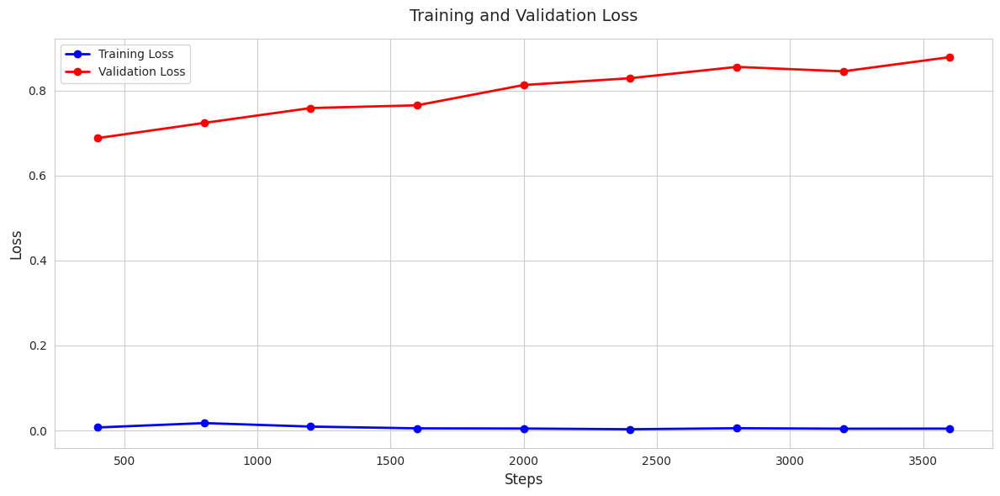

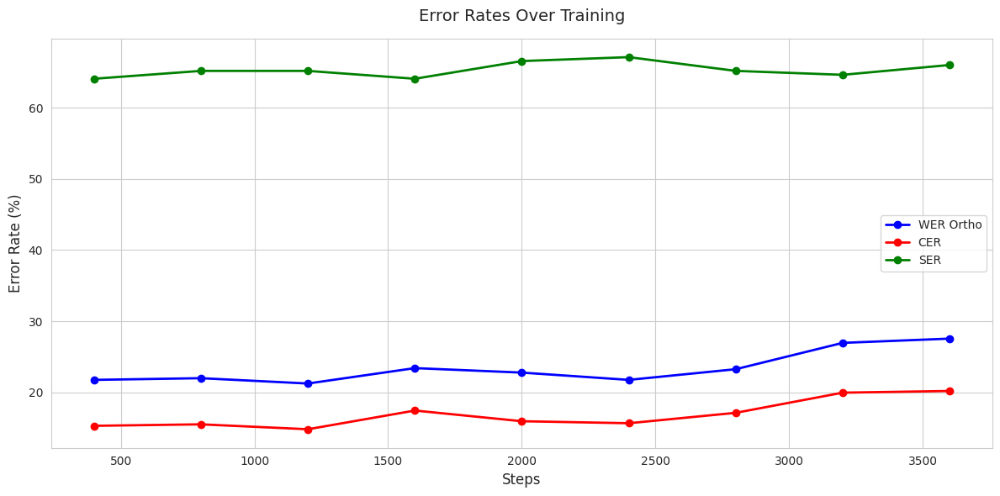

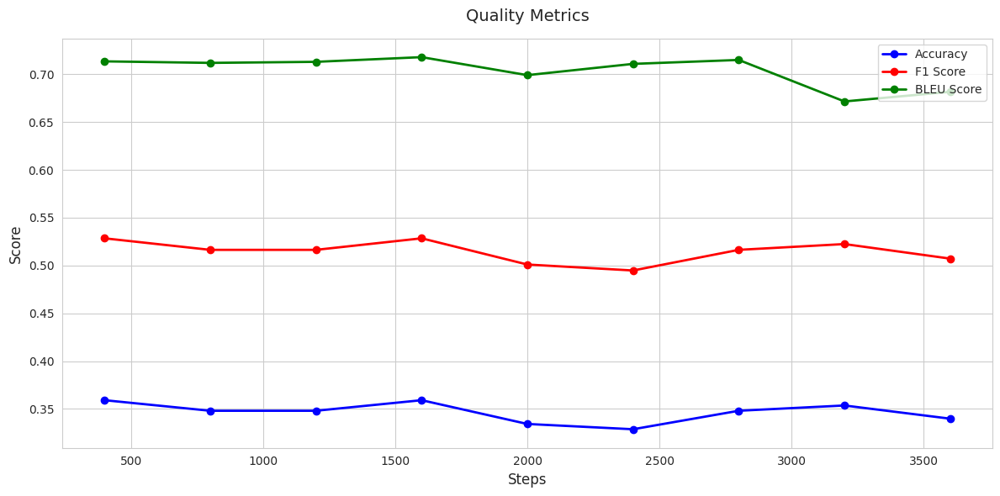

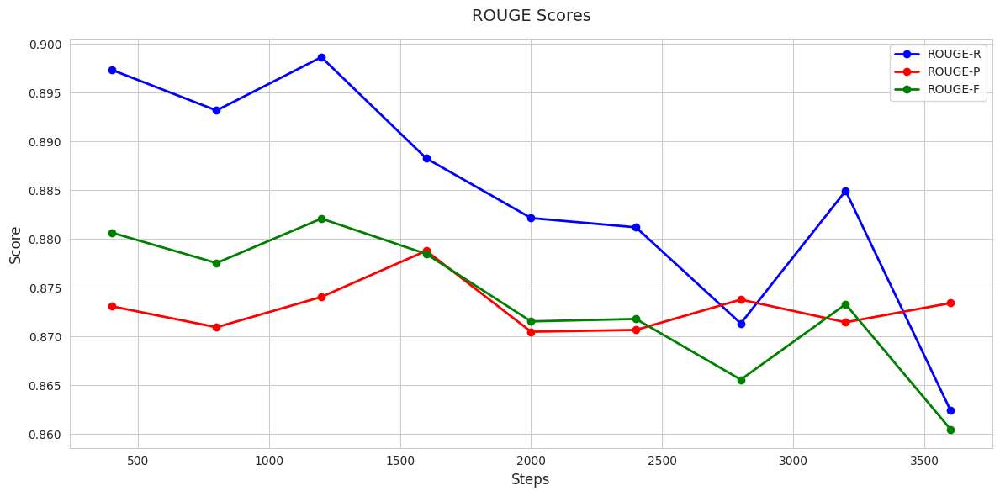

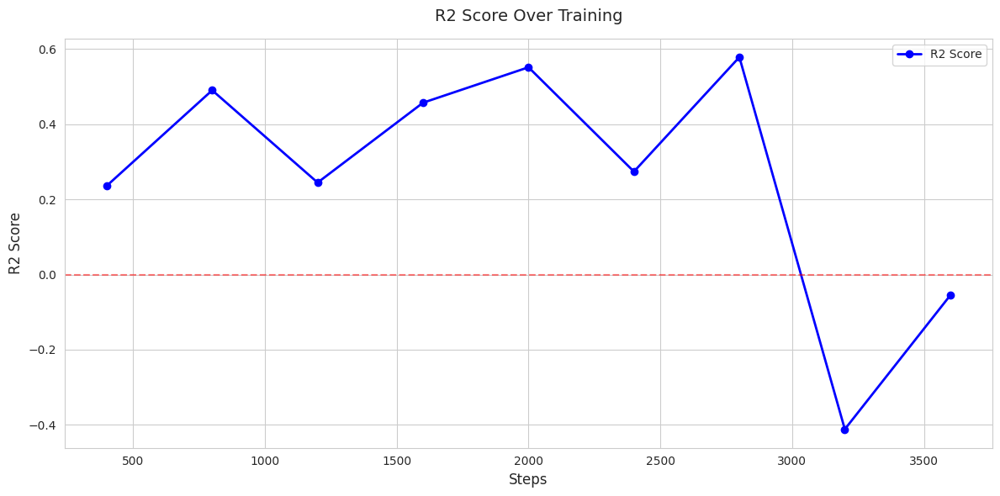


=== Best Metrics ===
Best WER: 21.24% (Step 1200)
Best CER: 14.81% (Step 1200)
Best BLEU: 0.718 (Step 1600)
Best Accuracy: 35.91% (Step 400)
Best F1 Score: 0.528 (Step 400)
Best ROUGE-F: 0.882 (Step 1200)
Best R2 Score: 0.578 (Step 2800)

=== Final Metrics (Step 3600) ===
Final WER: 27.55%
Final CER: 20.19%
Final SER: 66.02%
Final Accuracy: 33.98%
Final F1 Score: 0.507


In [ ]:
# Set the style using seaborn
sns.set_style("whitegrid")

# Training data
data = {
    'step': [400, 800, 1200, 1600, 2000, 2400, 2800, 3200, 3600],
    'train_loss': [0.007000, 0.017300, 0.009100, 0.004900, 0.004500, 0.002800, 0.005200, 0.004100, 0.004300],
    'val_loss': [0.688022, 0.723781, 0.758817, 0.765297, 0.813020, 0.829074, 0.855708, 0.845220, 0.878660],
    'wer_ortho': [21.750256, 21.989082, 21.238485, 23.404981, 22.773797, 21.750256, 23.251450, 26.953258, 27.550324],
    'wer': [0.218353, 0.221445, 0.213635, 0.236089, 0.229255, 0.218353, 0.234950, 0.268793, 0.275952],
    'accuracy': [0.359116, 0.348066, 0.348066, 0.359116, 0.334254, 0.328729, 0.348066, 0.353591, 0.339779],
    'f1': [0.528455, 0.516393, 0.516393, 0.528455, 0.501035, 0.494802, 0.516393, 0.522449, 0.507216],
    'r2': [0.235858, 0.489788, 0.244383, 0.456749, 0.550945, 0.273589, 0.577916, -0.411504, -0.055441],
    'bleu': [0.713570, 0.711965, 0.713062, 0.717979, 0.699148, 0.710923, 0.715034, 0.671624, 0.681703],
    'rouge_r': [0.897348, 0.893173, 0.898646, 0.888270, 0.882141, 0.881192, 0.871336, 0.884932, 0.862418],
    'rouge_p': [0.873094, 0.870939, 0.874051, 0.878782, 0.870481, 0.870666, 0.873779, 0.871449, 0.873424],
    'rouge_f': [0.880645, 0.877530, 0.882085, 0.878465, 0.871543, 0.871793, 0.865570, 0.873303, 0.860479],
    'cer': [15.292417, 15.500405, 14.809462, 17.439278, 15.937533, 15.655515, 17.118483, 19.952762, 20.188952],
    'ser': [64.088398, 65.193370, 65.193370, 64.088398, 66.574586, 67.127072, 65.193370, 64.640884, 66.022099]
}

def plot_training_loss():
    """Plot training and validation loss"""
    plt.figure(figsize=(12, 6))
    plt.plot(data['step'], data['train_loss'], 'b-o', label='Training Loss', linewidth=2)
    plt.plot(data['step'], data['val_loss'], 'r-o', label='Validation Loss', linewidth=2)
    plt.xlabel('Steps', fontsize=12)
    plt.ylabel('Loss', fontsize=12)
    plt.title('Training and Validation Loss', fontsize=14, pad=15)
    plt.legend(fontsize=10)
    plt.tight_layout()
    plt.show()

def plot_error_rates():
    """Plot WER, CER, and SER"""
    plt.figure(figsize=(12, 6))
    plt.plot(data['step'], data['wer_ortho'], 'b-o', label='WER Ortho', linewidth=2)
    plt.plot(data['step'], data['cer'], 'r-o', label='CER', linewidth=2)
    plt.plot(data['step'], data['ser'], 'g-o', label='SER', linewidth=2)
    plt.xlabel('Steps', fontsize=12)
    plt.ylabel('Error Rate (%)', fontsize=12)
    plt.title('Error Rates Over Training', fontsize=14, pad=15)
    plt.legend(fontsize=10)
    plt.tight_layout()
    plt.show()

def plot_quality_metrics():
    """Plot accuracy, F1, and BLEU scores"""
    plt.figure(figsize=(12, 6))
    plt.plot(data['step'], data['accuracy'], 'b-o', label='Accuracy', linewidth=2)
    plt.plot(data['step'], data['f1'], 'r-o', label='F1 Score', linewidth=2)
    plt.plot(data['step'], data['bleu'], 'g-o', label='BLEU Score', linewidth=2)
    plt.xlabel('Steps', fontsize=12)
    plt.ylabel('Score', fontsize=12)
    plt.title('Quality Metrics', fontsize=14, pad=15)
    plt.legend(fontsize=10)
    plt.tight_layout()
    plt.show()

def plot_rouge_scores():
    """Plot ROUGE scores"""
    plt.figure(figsize=(12, 6))
    plt.plot(data['step'], data['rouge_r'], 'b-o', label='ROUGE-R', linewidth=2)
    plt.plot(data['step'], data['rouge_p'], 'r-o', label='ROUGE-P', linewidth=2)
    plt.plot(data['step'], data['rouge_f'], 'g-o', label='ROUGE-F', linewidth=2)
    plt.xlabel('Steps', fontsize=12)
    plt.ylabel('Score', fontsize=12)
    plt.title('ROUGE Scores', fontsize=14, pad=15)
    plt.legend(fontsize=10)
    plt.tight_layout()
    plt.show()

def plot_r2_score():
    """Plot R2 score"""
    plt.figure(figsize=(12, 6))
    plt.plot(data['step'], data['r2'], 'b-o', label='R2 Score', linewidth=2)
    plt.axhline(y=0, color='r', linestyle='--', alpha=0.5)
    plt.xlabel('Steps', fontsize=12)
    plt.ylabel('R2 Score', fontsize=12)
    plt.title('R2 Score Over Training', fontsize=14, pad=15)
    plt.legend(fontsize=10)
    plt.tight_layout()
    plt.show()

def print_best_metrics():
    """Print best values for each metric"""
    print("\n=== Best Metrics ===")
    print(f"Best WER: {min(data['wer_ortho']):.2f}% (Step {data['step'][np.argmin(data['wer_ortho'])]})")
    print(f"Best CER: {min(data['cer']):.2f}% (Step {data['step'][np.argmin(data['cer'])]})")
    print(f"Best BLEU: {max(data['bleu']):.3f} (Step {data['step'][np.argmax(data['bleu'])]})")
    print(f"Best Accuracy: {max(data['accuracy'])*100:.2f}% (Step {data['step'][np.argmax(data['accuracy'])]})")
    print(f"Best F1 Score: {max(data['f1']):.3f} (Step {data['step'][np.argmax(data['f1'])]})")
    print(f"Best ROUGE-F: {max(data['rouge_f']):.3f} (Step {data['step'][np.argmax(data['rouge_f'])]})")
    print(f"Best R2 Score: {max(data['r2']):.3f} (Step {data['step'][np.argmax(data['r2'])]})")
    print("\n=== Final Metrics (Step 3600) ===")
    print(f"Final WER: {data['wer_ortho'][-1]:.2f}%")
    print(f"Final CER: {data['cer'][-1]:.2f}%")
    print(f"Final SER: {data['ser'][-1]:.2f}%")
    print(f"Final Accuracy: {data['accuracy'][-1]*100:.2f}%")
    print(f"Final F1 Score: {data['f1'][-1]:.3f}")

def main():
    """Main function to generate all plots and metrics"""
    # Create all plots
    plot_training_loss()
    plot_error_rates()
    plot_quality_metrics()
    plot_rouge_scores()
    plot_r2_score()

    # Print best metrics
    print_best_metrics()

if __name__ == "__main__":
    main()

## 9b. Predict & Evaluate

In [ ]:
import torch
from transformers import pipeline
import evaluate
from datasets import load_dataset, Audio
import numpy as np
from nltk.translate.bleu_score import corpus_bleu, SmoothingFunction
from rouge import Rouge
from sklearn.metrics import f1_score

# Initialize metrics
metric_wer = evaluate.load("wer")
smoother = SmoothingFunction()
rouge_score = Rouge()

# 1. Model Loading
def load_model(model_path):
    """Load the saved model and initialize transcriber"""
    device = "cuda:0" if torch.cuda.is_available() else "cpu"
    print(f"Using device: {device}")

    transcriber = pipeline(
        "automatic-speech-recognition",
        model=model_path,
        chunk_length_s=30,
        device=device,
    )
    return transcriber

# 2. Single Prediction - Fixed WER computation
def predict_single_sample(audio_file, target, transcriber):
    """Make prediction for a single audio file"""
    prediction = transcriber(
        audio_file,
        batch_size=8,
        return_timestamps=True,
    )['chunks']

    pred_text = prediction[0]['text']

    print("=== Single Sample Prediction ===")
    print("Timestamp:", prediction[0]['timestamp'])
    print("Prediction:", pred_text)
    print("Target:", target)

    # Calculate WER using full text strings
    wer = metric_wer.compute(predictions=[pred_text], references=[target])
    wer_percentage = wer * 100
    print(f"WER: {wer_percentage:.2f}%")

    # Print word-by-word comparison
    pred_words = pred_text.split()
    ref_words = target.split()
    print("\nWord-by-word comparison:")
    max_len = max(len(pred_words), len(ref_words))
    for i in range(max_len):
        pred = pred_words[i] if i < len(pred_words) else "___"
        ref = ref_words[i] if i < len(ref_words) else "___"
        match = "✓" if i < len(pred_words) and i < len(ref_words) and pred.lower() == ref.lower() else "✗"
        print(f"Word {i+1}: {pred:20} | {ref:20} {match}")

    return prediction[0]

# 3. Evaluation Function (keeping original logic but fixing WER computation)
def predict_eval(audio_file, target, idx, transcriber):
    """Evaluate a single prediction with multiple metrics"""
    # Get prediction
    preds = transcriber(
        audio_file,
        batch_size=8,
    )['text']

    # Calculate WER using full text
    wer = metric_wer.compute(predictions=[preds], references=[target])
    wer_percentage = wer * 100

    # Process words for other metrics
    pred_words = preds.split()
    ref_words = target.split()

    # Calculate accuracy
    min_len = min(len(pred_words), len(ref_words))
    correct = sum(1 for i in range(min_len)
                 if pred_words[i].lower() == ref_words[i].lower())
    accuracy = (correct / len(ref_words)) * 100

    # Calculate ROUGE scores
    rouge_scores = rouge_score.get_scores(preds, target, avg=True)

    # Calculate F1 score
    pred_words_padded = pred_words + ['PAD'] * (len(ref_words) - len(pred_words))
    ref_words_padded = ref_words + ['PAD'] * (len(pred_words) - len(ref_words))
    f1 = compute_f1(pred_words_padded, ref_words_padded)

    # Calculate BLEU score
    bleu = corpus_bleu([[ref_words]], [pred_words],
                       smoothing_function=smoother.method1)

    return {
        "num": idx,
        "wer": wer,
        "wer_percentage": f"{wer_percentage:.2f}%",
        "accuracy": accuracy,
        "f1_score": f1,
        "bleu_score": bleu,
        "Rouge 1 r": rouge_scores['rouge-1']['r'],
        "Rouge 1 p": rouge_scores['rouge-1']['p'],
        "Rouge 1 f": rouge_scores['rouge-1']['f'],
        "predict": preds,
        "target": target,
    }

# 4. Batch Evaluation
def evaluate_test_set(merged_dataset, transcriber):
    """Evaluate entire test set"""
    preds_eval_list = []
    total_samples = len(merged_dataset['test'])

    print(f"\nEvaluating {total_samples} test samples...")

    for idx in range(total_samples):
        if idx % 10 == 0:  # Progress update
            print(f"Processing sample {idx}/{total_samples}")

        try:
            predicted = predict_eval(
                merged_dataset['test']['audio'][idx],
                merged_dataset['test']['transcription'][idx],
                idx,
                transcriber
            )
            preds_eval_list.append(predicted)
        except Exception as e:
            print(f"Error processing sample {idx}: {str(e)}")
            continue

    return preds_eval_list

# 5. Main execution
def main():
    try:
        # Load model
        saved_model_pt = "whisper-tiny-minds14-en"
        transcriber = load_model(saved_model_pt)

        # Single sample prediction
        audio_file = merged_dataset['test']['audio'][0]
        target = merged_dataset['test']['transcription'][0]
        single_pred = predict_single_sample(audio_file, target, transcriber)

        # Batch evaluation
        print("\nStarting batch evaluation...")
        results = evaluate_test_set(merged_dataset, transcriber)

        # Calculate average metrics
        avg_wer = np.mean([float(r['wer']) for r in results])
        avg_accuracy = np.mean([r['accuracy'] for r in results])
        avg_f1 = np.mean([r['f1_score'] for r in results])
        avg_bleu = np.mean([r['bleu_score'] for r in results])

        print("\n=== Final Results ===")
        print(f"Average WER: {avg_wer:.2f}%")
        print(f"Average Accuracy: {avg_accuracy:.2f}%")
        print(f"Average F1 Score: {avg_f1:.4f}")
        print(f"Average BLEU Score: {avg_bleu:.4f}")

        return results

    except Exception as e:
        print(f"Error in main execution: {str(e)}")
        raise

# Helper function for F1 score
def compute_f1(preds, labels):
    """Compute F1 score"""
    preds_binary = [1 if p == l else 0 for p, l in zip(preds, labels)]
    labels_binary = [1 if l != 'PAD' else 0 for l in labels]
    return f1_score(labels_binary, preds_binary)

if __name__ == "__main__":
    results = main()

Using device: cuda:0


Whisper did not predict an ending timestamp, which can happen if audio is cut off in the middle of a word. Also make sure WhisperTimeStampLogitsProcessor was used during generation.


=== Single Sample Prediction ===
Timestamp: (0.0, None)
Prediction: going overseas for a holiday just wondering if i'll be able to use my debit card while i'll go to see if it'll work
Target: hi I'm going overseas for holiday just wondering if I'll be able to use my debit card while overseas if it'll work
WER: 36.36%

Word-by-word comparison:
Word 1: going                | hi                   ✗
Word 2: overseas             | I'm                  ✗
Word 3: for                  | going                ✗
Word 4: a                    | overseas             ✗
Word 5: holiday              | for                  ✗
Word 6: just                 | holiday              ✗
Word 7: wondering            | just                 ✗
Word 8: if                   | wondering            ✗
Word 9: i'll                 | if                   ✗
Word 10: be                   | I'll                 ✗
Word 11: able                 | be                   ✗
Word 12: to                   | able                 ✗
Word

/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 10/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 20/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 30/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 40/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 50/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 60/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 70/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 80/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 90/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 100/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 110/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 120/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 130/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 140/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 150/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 160/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 170/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 180/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 190/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 200/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 210/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 220/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 230/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 240/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 250/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 260/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 270/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 280/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 290/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 300/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 310/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 320/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 330/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 340/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 350/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is

Processing sample 360/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



=== Final Results ===
Average WER: 0.27%
Average Accuracy: 67.18%
Average F1 Score: 0.6778
Average BLEU Score: 0.5978


In [ ]:
import torch
from transformers import pipeline
import evaluate
import numpy as np
from nltk.translate.bleu_score import corpus_bleu, SmoothingFunction
from rouge import Rouge
from sklearn.metrics import f1_score
from pprint import pprint  # For nice formatting of results

# Initialize metrics
metric_wer = evaluate.load("wer")
smoother = SmoothingFunction()
rouge_score = Rouge()

def predict_eval(audio_file, target, idx, transcriber):
    """Evaluate a single prediction with multiple metrics"""
    # Get prediction
    prediction = transcriber(
        audio_file,
        batch_size=8,
    )
    preds = prediction['text']

    # Calculate WER using complete text
    wer = metric_wer.compute(predictions=[preds], references=[target])
    wer_percentage = wer * 100

    # Process words for other metrics
    pred_words = preds.split()
    ref_words = target.split()

    # Calculate accuracy
    min_len = min(len(pred_words), len(ref_words))
    correct = sum(1 for i in range(min_len)
                 if pred_words[i].lower() == ref_words[i].lower())
    accuracy = (correct / len(ref_words)) * 100

    # Calculate ROUGE scores
    rouge_scores = rouge_score.get_scores(preds, target, avg=True)

    # Calculate F1 score
    max_len = max(len(pred_words), len(ref_words))
    pred_words_padded = pred_words + ['PAD'] * (max_len - len(pred_words))
    ref_words_padded = ref_words + ['PAD'] * (max_len - len(ref_words))
    f1 = compute_f1(pred_words_padded, ref_words_padded)

    # Calculate BLEU score
    bleu = corpus_bleu([[ref_words]], [pred_words],
                       smoothing_function=smoother.method1)

    return {
        'num': idx,
        'wer': wer,
        'werotho': f"{wer_percentage:.2f}%",
        'accuracy': accuracy,
        'f1_score': f1,
        'bleu_score': bleu,
        'Rouge 1 r': rouge_scores['rouge-1']['r'],
        'Rouge 1 p': rouge_scores['rouge-1']['p'],
        'Rouge 1 f': rouge_scores['rouge-1']['f'],
        'predict': preds,
        'target': target,
    }

def compute_f1(preds, labels):
    """Compute F1 score between predictions and labels"""
    preds_binary = [1 if p == l else 0 for p, l in zip(preds, labels)]
    labels_binary = [1 if l != 'PAD' else 0 for l in labels]
    return f1_score(labels_binary, preds_binary)

def evaluate_test_set(merged_dataset, transcriber):
    """Evaluate entire test set"""
    preds_eval_list = []
    total_samples = len(merged_dataset['test'])

    print(f"\nEvaluating {total_samples} test samples...")

    for idx in range(total_samples):
        if idx % 10 == 0:
            print(f"Processing sample {idx}/{total_samples}")

        try:
            result = predict_eval(
                merged_dataset['test']['audio'][idx],
                merged_dataset['test']['transcription'][idx],
                idx,
                transcriber
            )
            preds_eval_list.append(result)

            # Print formatted result for each sample
            print(f"\nSample {idx} Results:")
            pprint(result)

        except Exception as e:
            print(f"Error processing sample {idx}: {str(e)}")
            continue

    return preds_eval_list

def main():
    # Load model
    device = "cuda:0" if torch.cuda.is_available() else "cpu"
    print(f"Using device: {device}")

    saved_model_pt = "whisper-tiny-minds14-en"
    transcriber = pipeline(
        "automatic-speech-recognition",
        model=saved_model_pt,
        chunk_length_s=30,
        device=device,
    )

    # Run evaluation
    results = evaluate_test_set(merged_dataset, transcriber)

    # Calculate and print averages
    avg_metrics = {
        'wer': np.mean([float(r['wer']) for r in results]),
        'accuracy': np.mean([r['accuracy'] for r in results]),
        'f1_score': np.mean([r['f1_score'] for r in results]),
        'bleu_score': np.mean([r['bleu_score'] for r in results]),
        'rouge_f1': np.mean([r['Rouge 1 f'] for r in results])
    }

    print("\n=== Average Metrics ===")
    pprint(avg_metrics)

    return results

if __name__ == "__main__":
    results = main()

    # Save results to file (optional)
    import json
    with open('prediction_results.json', 'w') as f:
        json.dump(results, f, indent=2)

Using device: cuda:0

Evaluating 362 test samples...
Processing sample 0/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 0 Results:
{'Rouge 1 f': 0.772727267768595,
 'Rouge 1 p': 0.7083333333333334,
 'Rouge 1 r': 0.85,
 'accuracy': 22.727272727272727,
 'bleu_score': 0.4079338903150469,
 'f1_score': 0.3076923076923077,
 'num': 0,
 'predict': "hi i'm going overseas for a holiday just wondering if i'll be "
            "able to use my debit card while i'll go to see if it would work",
 'target': "hi I'm going overseas for holiday just wondering if I'll be able "
           "to use my debit card while overseas if it'll work",
 'wer': 0.4090909090909091,
 'werotho': '40.91%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 1 Results:
{'Rouge 1 f': 0.7857142807142857,
 'Rouge 1 p': 0.7857142857142857,
 'Rouge 1 r': 0.7857142857142857,
 'accuracy': 92.85714285714286,
 'bleu_score': 0.6162607099729586,
 'f1_score': 0.88,
 'num': 1,
 'predict': 'i would like to make a large payment and receive confirmation '
            'code via sms',
 'target': 'I would like to make the large payment and receive confirmation '
           'code via SMS',
 'wer': 0.21428571428571427,
 'werotho': '21.43%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 2 Results:
{'Rouge 1 f': 0.6666666617283951,
 'Rouge 1 p': 0.6,
 'Rouge 1 r': 0.75,
 'accuracy': 0.0,
 'bleu_score': 0.26591479484724945,
 'f1_score': 0.0,
 'num': 2,
 'predict': "there's the card work abroad",
 'target': 'sister card work abroad',
 'wer': 0.5,
 'werotho': '50.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 3 Results:
{'Rouge 1 f': 0.5999999950000001,
 'Rouge 1 p': 0.6,
 'Rouge 1 r': 0.6,
 'accuracy': 68.75,
 'bleu_score': 0.11330849383575524,
 'f1_score': 0.6666666666666666,
 'num': 3,
 'predict': "hi i'm going on holiday i want to know if my card or where i'm "
            'abroad',
 'target': "hi I'm going on holiday I want to know my car don't work when I'm "
           'abroad',
 'wer': 0.5,
 'werotho': '50.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 4 Results:
{'Rouge 1 f': 0.9090909040909091,
 'Rouge 1 p': 0.9090909090909091,
 'Rouge 1 r': 0.9090909090909091,
 'accuracy': 100.0,
 'bleu_score': 0.6815757064066384,
 'f1_score': 0.92,
 'num': 4,
 'predict': "i'm trying to pay a large amount and i'm supposed to get a "
            "confirmation code via sms but i'm not too sure what to do with it",
 'target': "I'm trying to pay a large amount and I'm supposed to get a "
           "confirmation code via SMS but I'm not too sure what to do with it",
 'wer': 0.14814814814814814,
 'werotho': '14.81%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 5 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 5,
 'predict': 'the app does not load',
 'target': 'the app does not load',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 6 Results:
{'Rouge 1 f': 0.8771929774576792,
 'Rouge 1 p': 0.8620689655172413,
 'Rouge 1 r': 0.8928571428571429,
 'accuracy': 91.17647058823529,
 'bleu_score': 0.7873242045666595,
 'f1_score': 0.9375,
 'num': 6,
 'predict': "i am just calling about a technical issue with your bank app i'm "
            "trying to get on at the moment and it says the app can't contact "
            'the bank server and require my details',
 'target': "hi I'm just calling about a technical issue with your bank app I'm "
           "trying to get on at the moment and it says the app can't contact "
           'the bank server and retrieve my details',
 'wer': 0.11764705882352941,
 'werotho': '11.76%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 7 Results:
{'Rouge 1 f': 0.8571428521428571,
 'Rouge 1 p': 0.8571428571428571,
 'Rouge 1 r': 0.8571428571428571,
 'accuracy': 100.0,
 'bleu_score': 0.8091067115702212,
 'f1_score': 0.9230769230769231,
 'num': 7,
 'predict': 'i have a question about business loan',
 'target': 'I have a question about business loan',
 'wer': 0.14285714285714285,
 'werotho': '14.29%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 8 Results:
{'Rouge 1 f': 0.7999999950080001,
 'Rouge 1 p': 0.7692307692307693,
 'Rouge 1 r': 0.8333333333333334,
 'accuracy': 8.333333333333332,
 'bleu_score': 0.5783569866465142,
 'f1_score': 0.0,
 'num': 8,
 'predict': 'i just want to change the address of my account please thank you',
 'target': 'I want to change the address on my account please thank you',
 'wer': 0.25,
 'werotho': '25.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 9 Results:
{'Rouge 1 f': 0.8333333283333335,
 'Rouge 1 p': 0.8333333333333334,
 'Rouge 1 r': 0.8333333333333334,
 'accuracy': 91.66666666666666,
 'bleu_score': 0.7292571723872933,
 'f1_score': 0.9090909090909091,
 'num': 9,
 'predict': 'how can i see a history of my most recent transactions please',
 'target': 'hey can I see a history of my most recent transactions please',
 'wer': 0.16666666666666666,
 'werotho': '16.67%'}
Processing sample 10/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 10 Results:
{'Rouge 1 f': 0.8571428521441169,
 'Rouge 1 p': 0.8709677419354839,
 'Rouge 1 r': 0.84375,
 'accuracy': 50.0,
 'bleu_score': 0.5685580667834785,
 'f1_score': 0.5964912280701754,
 'num': 10,
 'predict': "hello i'm trying to pay a large amount into an account and i'm "
            'not entirely sure what i supposed to do with the confirmation '
            'code that i get via sms could you help me with that',
 'target': "hello I'm trying to pay a large amount into an account and I'm not "
           'entirely sure what I supposed to you supposed to do with the '
           'confirmation code that I get for your SMS could you help me with '
           'that',
 'wer': 0.25,
 'werotho': '25.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 11 Results:
{'Rouge 1 f': 0.6666666617283951,
 'Rouge 1 p': 0.6,
 'Rouge 1 r': 0.75,
 'accuracy': 0.0,
 'bleu_score': 0.26591479484724945,
 'f1_score': 0.0,
 'num': 11,
 'predict': 'can i access the app',
 'target': 'cannot access the app',
 'wer': 0.5,
 'werotho': '50.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 12 Results:
{'Rouge 1 f': 0.6666666616735254,
 'Rouge 1 p': 0.6428571428571429,
 'Rouge 1 r': 0.6923076923076923,
 'accuracy': 42.857142857142854,
 'bleu_score': 0.2722589423069702,
 'f1_score': 0.5263157894736842,
 'num': 12,
 'predict': "i'm just wondering what the maximum amount is that i can withdraw "
            'from the atm',
 'target': "I'm just wondering what's the maximum amount that I can withdraw "
           'from the ATM',
 'wer': 0.35714285714285715,
 'werotho': '35.71%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 13 Results:
{'Rouge 1 f': 0.49999999501033066,
 'Rouge 1 p': 0.4782608695652174,
 'Rouge 1 r': 0.5238095238095238,
 'accuracy': 32.0,
 'bleu_score': 0.13651897290525358,
 'f1_score': 0.48484848484848486,
 'num': 13,
 'predict': 'hi good morning please i would like to make a company if i have a '
            "joint and my heart and i've been loading i don't know if i can",
 'target': "hi good morning to you don't like to make a complaint I've been "
           "trying to look up my house I don't know why thank you",
 'wer': 0.76,
 'werotho': '76.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 14 Results:
{'Rouge 1 f': 0.645161285369407,
 'Rouge 1 p': 0.5882352941176471,
 'Rouge 1 r': 0.7142857142857143,
 'accuracy': 3.7037037037037033,
 'bleu_score': 0.2104933123411413,
 'f1_score': 0.07142857142857142,
 'num': 14,
 'predict': "hi what do if you can help me please i've got an issue with my "
            "car i'm trying to use it and it's just not letting me get money "
            "out if not letting me pay in short it's just declining i don't "
            "know the problem with the chick or what the issue is it's going "
            'to be closing comes in the end of the problem so i would really '
            'like to help me',
 'target': "hi what you can help me please I can't issue with my car I'm "
           "trying to use that and it's just not letting me money out the car "
           "I don't know if there's a problem with check on what issue is he "
           "called me I'm not a problem I would really like some company",
 'wer': 0.7777777777777778,
 'we

/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 15 Results:
{'Rouge 1 f': 0.937499995,
 'Rouge 1 p': 0.9375,
 'Rouge 1 r': 0.9375,
 'accuracy': 100.0,
 'bleu_score': 0.8843946454355334,
 'f1_score': 0.9696969696969697,
 'num': 15,
 'predict': "hi i need some help with my card it's not working and my payments "
            "won't go through",
 'target': "hi I need some help with my card it's not working and my payments "
           "won't go through",
 'wer': 0.058823529411764705,
 'werotho': '5.88%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 16 Results:
{'Rouge 1 f': 0.8749999950195313,
 'Rouge 1 p': 0.8235294117647058,
 'Rouge 1 r': 0.9333333333333333,
 'accuracy': 100.0,
 'bleu_score': 0.6028817681965138,
 'f1_score': 0.9333333333333333,
 'num': 16,
 'predict': 'hello i just wanted to know how much money i currently have in my '
            'bank account thank you',
 'target': 'hello I just wanted to know how much money I currently have in my '
           'bank account',
 'wer': 0.25,
 'werotho': '25.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 17 Results:
{'Rouge 1 f': 0.8333333283333335,
 'Rouge 1 p': 0.8333333333333334,
 'Rouge 1 r': 0.8333333333333334,
 'accuracy': 3.0303030303030303,
 'bleu_score': 0.5314277357337872,
 'f1_score': 0.058823529411764705,
 'num': 17,
 'predict': "hi i'm calling about some recent transactions on my bank account "
            "i just wanted to check her last few transactions because i wasn't "
            'sure if they going through properly or not thanks',
 'target': 'I am calling you about some recent transactions on my bank account '
           "I just wanted to check the last few transactions because I wasn't "
           'sure if they gone through properly or not thanks',
 'wer': 0.21212121212121213,
 'werotho': '21.21%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 18 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 0.5623413251903491,
 'f1_score': 1.0,
 'num': 18,
 'predict': 'freeze my card',
 'target': 'freeze my card',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 19 Results:
{'Rouge 1 f': 0.7999999950000002,
 'Rouge 1 p': 0.8,
 'Rouge 1 r': 0.8,
 'accuracy': 100.0,
 'bleu_score': 0.5253819788848316,
 'f1_score': 0.8888888888888888,
 'num': 19,
 'predict': 'how much money can i take out of the atm',
 'target': 'how much money can I take out of the ATM',
 'wer': 0.2,
 'werotho': '20.00%'}
Processing sample 20/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 20 Results:
{'Rouge 1 f': 0.5999999950500001,
 'Rouge 1 p': 0.5454545454545454,
 'Rouge 1 r': 0.6666666666666666,
 'accuracy': 0.0,
 'bleu_score': 0.11094660471566163,
 'f1_score': 0.0,
 'num': 20,
 'predict': 'hi id like to know how to set up a joint account',
 'target': "I'd like to have set off a joint account",
 'wer': 0.6666666666666666,
 'werotho': '66.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 21 Results:
{'Rouge 1 f': 0.888888883888889,
 'Rouge 1 p': 0.8888888888888888,
 'Rouge 1 r': 0.8888888888888888,
 'accuracy': 100.0,
 'bleu_score': 0.8633400213704505,
 'f1_score': 0.9411764705882353,
 'num': 21,
 'predict': "i'd like to check my most recent transactions please",
 'target': "I'd like to check my most recent transactions please",
 'wer': 0.1111111111111111,
 'werotho': '11.11%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 22 Results:
{'Rouge 1 f': 0.7222222172376543,
 'Rouge 1 p': 0.6842105263157895,
 'Rouge 1 r': 0.7647058823529411,
 'accuracy': 76.19047619047619,
 'bleu_score': 0.11961013580789268,
 'f1_score': 0.8,
 'num': 22,
 'predict': "hello i'm calling up some having trouble with my card it's not "
            "working and i'm unable to make payment with it",
 'target': "hello I'm pulling up I'm having troubles with my card and not "
           "working and I'm unable to meet payment with it",
 'wer': 0.3333333333333333,
 'werotho': '33.33%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 23 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 23,
 'predict': 'show me my account balance please',
 'target': 'show me my account balance please',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 24 Results:
{'Rouge 1 f': 0.8823529361764706,
 'Rouge 1 p': 0.8823529411764706,
 'Rouge 1 r': 0.8823529411764706,
 'accuracy': 100.0,
 'bleu_score': 0.6899302125555485,
 'f1_score': 0.9411764705882353,
 'num': 24,
 'predict': "hello hi i'd like to deposit money into my account how would i be "
            'able to do this',
 'target': "hello hi I'd like to deposit money into my account how would I be "
           'able to do this',
 'wer': 0.1111111111111111,
 'werotho': '11.11%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 25 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 13.333333333333334,
 'bleu_score': 0.652298419755502,
 'f1_score': 0.2,
 'num': 25,
 'predict': 'hello i was wondering something on pay on amazon but my card '
            'declined and literally it does not work at all even for other '
            'apps such as like e bay or any any any transactions i was '
            'wondering if you can look into this matter for me',
 'target': 'hello I was ordering something on Amazon but my card declined and '
           'literally Trinity it does not work at all even for other apps such '
           'as like Ebay or any any any transactions I was wondering if you '
           'can look into this matter for me',
 'wer': 0.2,
 'werotho': '20.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 26 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 26,
 'predict': "hi my debit card isn't working it's not letting me use it can you "
            'please help',
 'target': "hi my debit card isn't working it's not letting me use it can you "
           'please help',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 27 Results:
{'Rouge 1 f': 0.6666666616780046,
 'Rouge 1 p': 0.7,
 'Rouge 1 r': 0.6363636363636364,
 'accuracy': 72.72727272727273,
 'bleu_score': 0.4861555413051454,
 'f1_score': 0.7777777777777778,
 'num': 27,
 'predict': 'hi i just need to change my address today please',
 'target': 'hi I just need to change my address as a pain',
 'wer': 0.36363636363636365,
 'werotho': '36.36%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 28 Results:
{'Rouge 1 f': 0.9032258014568159,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.9333333333333333,
 'accuracy': 6.666666666666667,
 'bleu_score': 0.8065008590125561,
 'f1_score': 0.125,
 'num': 28,
 'predict': "hi just doesn't have some questions about direct debits can you "
            'please help me with that',
 'target': 'I just have some questions about direct debits can you please help '
           'me with that',
 'wer': 0.13333333333333333,
 'werotho': '13.33%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 29 Results:
{'Rouge 1 f': 0.9333333283333335,
 'Rouge 1 p': 0.9333333333333333,
 'Rouge 1 r': 0.9333333333333333,
 'accuracy': 93.75,
 'bleu_score': 0.8153551038173115,
 'f1_score': 0.967741935483871,
 'num': 29,
 'predict': 'the app does not load and i is not working for me can you please '
            'help',
 'target': 'the app does not load and it is not working for me can you please '
           'help',
 'wer': 0.0625,
 'werotho': '6.25%'}
Processing sample 30/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 30 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 30,
 'predict': 'can you give me some information about a new business loan',
 'target': 'can you give me some information about a new business loan',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 31 Results:
{'Rouge 1 f': 0.8666666616666667,
 'Rouge 1 p': 0.8666666666666667,
 'Rouge 1 r': 0.8666666666666667,
 'accuracy': 100.0,
 'bleu_score': 0.6865890479690393,
 'f1_score': 0.9285714285714286,
 'num': 31,
 'predict': "hi i'd like to make a deposit into my account how can i do that",
 'target': "hi I'd like to make a deposit into my account how can I do that",
 'wer': 0.13333333333333333,
 'werotho': '13.33%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 32 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 100.0,
 'bleu_score': 0.8408964152537145,
 'f1_score': 0.9333333333333333,
 'num': 32,
 'predict': 'i am going to change my address thanks',
 'target': 'I am going to change my address thanks',
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 33 Results:
{'Rouge 1 f': 0.699999995,
 'Rouge 1 p': 0.7,
 'Rouge 1 r': 0.7,
 'accuracy': 78.26086956521739,
 'bleu_score': 0.5194247346787363,
 'f1_score': 0.85,
 'num': 33,
 'predict': "hi i'm looking for some help please i've got me up for my account "
            "but it's currently not working with my account number",
 'target': "I am looking for some help please I've got the app for my account "
           "but it's probably not working with my account number",
 'wer': 0.2608695652173913,
 'werotho': '26.09%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 34 Results:
{'Rouge 1 f': 0.6349206299218948,
 'Rouge 1 p': 0.625,
 'Rouge 1 r': 0.6451612903225806,
 'accuracy': 13.513513513513514,
 'bleu_score': 0.21262894476209016,
 'f1_score': 0.1951219512195122,
 'num': 34,
 'predict': 'hello i was just calling up because i was taking me on my bank '
            "and there was there's a payment put through that but i don't know "
            "a way to know where it's just wondering if i could get a curler",
 'target': 'hello I was just because I was taking the online banking and there '
           "was a payment put through that but I don't know about when I'm "
           "about so it's just wondering where you get it cleared up",
 'wer': 0.5675675675675675,
 'werotho': '56.76%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 35 Results:
{'Rouge 1 f': 0.9230769180769233,
 'Rouge 1 p': 0.9230769230769231,
 'Rouge 1 r': 0.9230769230769231,
 'accuracy': 100.0,
 'bleu_score': 0.9193227152249185,
 'f1_score': 0.9629629629629629,
 'num': 35,
 'predict': "i'm using my banking app and it's not working the way it's "
            'supposed to',
 'target': "I'm using my banking app and it's not working the way it's "
           'supposed to',
 'wer': 0.07142857142857142,
 'werotho': '7.14%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 36 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 100.0,
 'bleu_score': 0.5946035575013605,
 'f1_score': 0.9333333333333333,
 'num': 36,
 'predict': 'how do i transfer money to my account',
 'target': 'how do I transfer money to my account',
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 37 Results:
{'Rouge 1 f': 0.8571428521469389,
 'Rouge 1 p': 0.8823529411764706,
 'Rouge 1 r': 0.8333333333333334,
 'accuracy': 84.21052631578947,
 'bleu_score': 0.5108636942731495,
 'f1_score': 0.8125,
 'num': 37,
 'predict': "i'm making a large purchase and i'm trying to use the "
            'confirmation code that i received to a text message',
 'target': "I'm making a large purchase and I'm trying to use the confirmation "
           'code that I received through text message',
 'wer': 0.2631578947368421,
 'werotho': '26.32%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 38 Results:
{'Rouge 1 f': 0.84848484348944,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.8235294117647058,
 'accuracy': 40.0,
 'bleu_score': 0.5481726838605793,
 'f1_score': 0.5185185185185185,
 'num': 38,
 'predict': "hi i'm trying to make a large payment online and it says i'm "
            'going to get a text message',
 'target': "hi I'm trying to make a large payment on mine and it says I'm "
           'going to get a text message',
 'wer': 0.2,
 'werotho': '20.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 39 Results:
{'Rouge 1 f': 0.7619047569160999,
 'Rouge 1 p': 0.7272727272727273,
 'Rouge 1 r': 0.8,
 'accuracy': 80.0,
 'bleu_score': 0.6786502681586727,
 'f1_score': 0.8888888888888888,
 'num': 39,
 'predict': 'is it possible to use my card when doing a board',
 'target': 'is it possible to use my card when going abroad',
 'wer': 0.3,
 'werotho': '30.00%'}
Processing sample 40/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 40 Results:
{'Rouge 1 f': 0.8181818131818183,
 'Rouge 1 p': 0.8181818181818182,
 'Rouge 1 r': 0.8181818181818182,
 'accuracy': 90.9090909090909,
 'bleu_score': 0.4832697830906221,
 'f1_score': 0.9,
 'num': 40,
 'predict': 'hi i need to put some money in my account please',
 'target': 'hi I need to put the money in my account please',
 'wer': 0.18181818181818182,
 'werotho': '18.18%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 41 Results:
{'Rouge 1 f': 0.5882352891349482,
 'Rouge 1 p': 0.5555555555555556,
 'Rouge 1 r': 0.625,
 'accuracy': 10.526315789473683,
 'bleu_score': 0.2232308651732177,
 'f1_score': 0.19047619047619047,
 'num': 41,
 'predict': "i'm calling about a tree existing business loan that i have with "
            "you guys i've been questioned about it",
 'target': 'sampling about a pre-existing a business loan that I have with you '
           "guys let's have some questions about it",
 'wer': 0.47368421052631576,
 'werotho': '47.37%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 42 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 42,
 'predict': "what's my account balance",
 'target': "what's my account balance",
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 43 Results:
{'Rouge 1 f': 0.7692307642603551,
 'Rouge 1 p': 0.8333333333333334,
 'Rouge 1 r': 0.7142857142857143,
 'accuracy': 57.14285714285714,
 'bleu_score': 0.21506254256566312,
 'f1_score': 0.6,
 'num': 43,
 'predict': 'i want to return direct debit',
 'target': 'I want to return a direct debit',
 'wer': 0.2857142857142857,
 'werotho': '28.57%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 44 Results:
{'Rouge 1 f': 0.9166666616666667,
 'Rouge 1 p': 0.9166666666666666,
 'Rouge 1 r': 0.9166666666666666,
 'accuracy': 100.0,
 'bleu_score': 0.7795149903947967,
 'f1_score': 0.9387755102040817,
 'num': 44,
 'predict': "hi i was wondering if there's any way to increase my withdrawal "
            "limit what's the maximum amount of money that i can withdraw from "
            'the atm',
 'target': "hi I was wondering if there's any way to increase my withdrawal "
           "limit what's the maximum amount of money that I can withdraw from "
           'the ATM',
 'wer': 0.11538461538461539,
 'werotho': '11.54%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 45 Results:
{'Rouge 1 f': 0.8648648598685172,
 'Rouge 1 p': 0.8888888888888888,
 'Rouge 1 r': 0.8421052631578947,
 'accuracy': 73.07692307692307,
 'bleu_score': 0.6687975934090665,
 'f1_score': 0.7906976744186046,
 'num': 45,
 'predict': "i'm going to make a large payment but i'm going to receive a text "
            'message from my bank to an sms code to confirm payment',
 'target': "I'm going to make a large payment but I'm going to receive a text "
           'message from my bank to get an SMS code to confirm payment',
 'wer': 0.15384615384615385,
 'werotho': '15.38%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 46 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 100.0,
 'bleu_score': 0.8408964152537145,
 'f1_score': 0.9333333333333333,
 'num': 46,
 'predict': "i'd like to deposit money into my account",
 'target': "I'd like to deposit money into my account",
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 47 Results:
{'Rouge 1 f': 0.8333333283333335,
 'Rouge 1 p': 0.8333333333333334,
 'Rouge 1 r': 0.8333333333333334,
 'accuracy': 100.0,
 'bleu_score': 0.7598356856515925,
 'f1_score': 0.9090909090909091,
 'num': 47,
 'predict': 'i want to pay my bills',
 'target': 'I want to pay my bills',
 'wer': 0.16666666666666666,
 'werotho': '16.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 48 Results:
{'Rouge 1 f': 0.7878787828833793,
 'Rouge 1 p': 0.8125,
 'Rouge 1 r': 0.7647058823529411,
 'accuracy': 11.76470588235294,
 'bleu_score': 0.6545654390989608,
 'f1_score': 0.21052631578947367,
 'num': 48,
 'predict': "there's a payment i'm not too sure about can you please show me "
            'my latest transactions',
 'target': "there's a pain in I'm not too sure about can you please show me my "
           'latest transaction',
 'wer': 0.23529411764705882,
 'werotho': '23.53%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 49 Results:
{'Rouge 1 f': 0.8571428521428571,
 'Rouge 1 p': 0.8571428571428571,
 'Rouge 1 r': 0.8571428571428571,
 'accuracy': 100.0,
 'bleu_score': 0.8091067115702212,
 'f1_score': 0.9230769230769231,
 'num': 49,
 'predict': "i'd like to cancel a direct debit",
 'target': "I'd like to cancel a direct debit",
 'wer': 0.14285714285714285,
 'werotho': '14.29%'}
Processing sample 50/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 50 Results:
{'Rouge 1 f': 0.5853658491612137,
 'Rouge 1 p': 0.4444444444444444,
 'Rouge 1 r': 0.8571428571428571,
 'accuracy': 60.0,
 'bleu_score': 0.27363397234863907,
 'f1_score': 0.6956521739130435,
 'num': 50,
 'predict': "i'm trying to pay a large amount for a loan and you keep sending "
            "me a confirmation through my sms to my message in it and i don't "
            "know what i'm supposed to do",
 'target': "I'm trying to pay a large amount for a alone you keep sending me "
           'confirmation',
 'wer': 1.4,
 'werotho': '140.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 51 Results:
{'Rouge 1 f': 0.888888883888889,
 'Rouge 1 p': 0.8888888888888888,
 'Rouge 1 r': 0.8888888888888888,
 'accuracy': 100.0,
 'bleu_score': 0.8801117367933934,
 'f1_score': 0.9473684210526315,
 'num': 51,
 'predict': 'i lost my card and need to freeze my account',
 'target': 'I lost my card and need to freeze my account',
 'wer': 0.1,
 'werotho': '10.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 52 Results:
{'Rouge 1 f': 0.8235294067647059,
 'Rouge 1 p': 0.8235294117647058,
 'Rouge 1 r': 0.8235294117647058,
 'accuracy': 94.44444444444444,
 'bleu_score': 0.4806604068305994,
 'f1_score': 0.875,
 'num': 52,
 'predict': 'hi i have a card i want to know whether it works overseas when '
            "i'm going on vacation",
 'target': "hi I have a card I want to know whether it works overseas but I'm "
           'going on vacation',
 'wer': 0.2222222222222222,
 'werotho': '22.22%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 53 Results:
{'Rouge 1 f': 0.6666666622222223,
 'Rouge 1 p': 0.5,
 'Rouge 1 r': 1.0,
 'accuracy': 0.0,
 'bleu_score': 0.345720784641941,
 'f1_score': 0.0,
 'num': 53,
 'predict': 'hello i like to freeze my card please',
 'target': 'freeze my card please',
 'wer': 1.0,
 'werotho': '100.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 54 Results:
{'Rouge 1 f': 0.49999999531250006,
 'Rouge 1 p': 0.4,
 'Rouge 1 r': 0.6666666666666666,
 'accuracy': 0.0,
 'bleu_score': 0.11362193664674995,
 'f1_score': 0.0,
 'num': 54,
 'predict': 'can i change my address',
 'target': 'change my dress',
 'wer': 1.0,
 'werotho': '100.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 55 Results:
{'Rouge 1 f': 0.9166666616666667,
 'Rouge 1 p': 0.9166666666666666,
 'Rouge 1 r': 0.9166666666666666,
 'accuracy': 100.0,
 'bleu_score': 0.7611606003349892,
 'f1_score': 0.96,
 'num': 55,
 'predict': 'can you tell me how i can deposit money into my bank account',
 'target': 'can you tell me how I can deposit money into my bank account',
 'wer': 0.07692307692307693,
 'werotho': '7.69%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 56 Results:
{'Rouge 1 f': 0.7999999950000002,
 'Rouge 1 p': 0.8,
 'Rouge 1 r': 0.8,
 'accuracy': 100.0,
 'bleu_score': 0.5253819788848316,
 'f1_score': 0.8888888888888888,
 'num': 56,
 'predict': 'how much in total can i withdraw from the atm',
 'target': 'how much in total can I withdraw from the ATM',
 'wer': 0.2,
 'werotho': '20.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 57 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 57,
 'predict': 'trying to figure out why my payment was declined',
 'target': 'trying to figure out why my payment was declined',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 58 Results:
{'Rouge 1 f': 0.9473684160526316,
 'Rouge 1 p': 0.9473684210526315,
 'Rouge 1 r': 0.9473684210526315,
 'accuracy': 100.0,
 'bleu_score': 0.7389984311706962,
 'f1_score': 0.9523809523809523,
 'num': 58,
 'predict': 'what is the maximum amount of money that i can withdraw how can i '
            'increase my withdrawal limit at the cash machine',
 'target': 'what is the maximum amount of money that I can withdraw how can I '
           'increase my withdrawal limit at the cash machine',
 'wer': 0.09090909090909091,
 'werotho': '9.09%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 59 Results:
{'Rouge 1 f': 0.6896551674197384,
 'Rouge 1 p': 0.6666666666666666,
 'Rouge 1 r': 0.7142857142857143,
 'accuracy': 6.25,
 'bleu_score': 0.3538995029906511,
 'f1_score': 0.0,
 'num': 59,
 'predict': "i please me help me i'm trying to pay with my card but my card is "
            'not working',
 'target': "I Disney help me I'm trying to pay with my card on my card not "
           'working',
 'wer': 0.375,
 'werotho': '37.50%'}
Processing sample 60/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 60 Results:
{'Rouge 1 f': 0.7804877998810233,
 'Rouge 1 p': 0.7619047619047619,
 'Rouge 1 r': 0.8,
 'accuracy': 0.0,
 'bleu_score': 0.5194247346787363,
 'f1_score': 0.0,
 'num': 60,
 'predict': "i mean i usually use the app for my bank services and today it's "
            'not working can you help me access my account',
 'target': "I'm usually asleep use the app for my big services and today it's "
           'not working any help me access my account',
 'wer': 0.3333333333333333,
 'werotho': '33.33%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 61 Results:
{'Rouge 1 f': 0.5853658486615111,
 'Rouge 1 p': 0.6,
 'Rouge 1 r': 0.5714285714285714,
 'accuracy': 19.230769230769234,
 'bleu_score': 0.29931950156101245,
 'f1_score': 0.20689655172413793,
 'num': 61,
 'predict': "hi i wonder if you'd be showing me my account balance i'm trying "
            'to see it and i need to be able to rectify my account',
 'target': "hi I want you to tell me my account balance until I'm just see it "
           'and I need to be able to reconcile a my account',
 'wer': 0.46153846153846156,
 'werotho': '46.15%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 62 Results:
{'Rouge 1 f': 0.5833333283333335,
 'Rouge 1 p': 0.5833333333333334,
 'Rouge 1 r': 0.5833333333333334,
 'accuracy': 66.66666666666666,
 'bleu_score': 0.3448444257953326,
 'f1_score': 0.7368421052631579,
 'num': 62,
 'predict': "clue i was ring up because i'd like to change my address",
 'target': 'play I was bringing up kids ID like to change my address',
 'wer': 0.4166666666666667,
 'werotho': '41.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 63 Results:
{'Rouge 1 f': 0.699999995,
 'Rouge 1 p': 0.7,
 'Rouge 1 r': 0.7,
 'accuracy': 25.0,
 'bleu_score': 0.2819665911730608,
 'f1_score': 0.3333333333333333,
 'num': 63,
 'predict': "i have a question to direct there i'm just trying to explain the "
            "interest rates on them i'm just trying to hire a go about it",
 'target': 'I have a question with direct debits can you explain the interest '
           'rates on them and just go about it',
 'wer': 0.6,
 'werotho': '60.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 64 Results:
{'Rouge 1 f': 0.8372092973282856,
 'Rouge 1 p': 0.8181818181818182,
 'Rouge 1 r': 0.8571428571428571,
 'accuracy': 83.87096774193549,
 'bleu_score': 0.6989029944247108,
 'f1_score': 0.8727272727272727,
 'num': 64,
 'predict': 'i could you stop all transactions on my card could you please '
            'freeze my card i need you to block my card from any payments all '
            "proceed to direct debit i'm going",
 'target': 'I could you stop all transactions on my card could you please '
           'freeze my card I need you to block my card from any payments all '
           'proceeded direct debits on going',
 'wer': 0.1935483870967742,
 'werotho': '19.35%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 65 Results:
{'Rouge 1 f': 0.4999999950000001,
 'Rouge 1 p': 0.5,
 'Rouge 1 r': 0.5,
 'accuracy': 50.0,
 'bleu_score': 0.1495348781221221,
 'f1_score': 0.6666666666666666,
 'num': 65,
 'predict': 'you loan',
 'target': 'new loan',
 'wer': 0.5,
 'werotho': '50.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 66 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 100.0,
 'bleu_score': 0.5946035575013605,
 'f1_score': 0.9333333333333333,
 'num': 66,
 'predict': 'how do i set up a joint account',
 'target': 'how do I set up a joint account',
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 67 Results:
{'Rouge 1 f': 0.9333333283333335,
 'Rouge 1 p': 0.9333333333333333,
 'Rouge 1 r': 0.9333333333333333,
 'accuracy': 100.0,
 'bleu_score': 0.8666415730847504,
 'f1_score': 0.9655172413793104,
 'num': 67,
 'predict': 'hi i would like to get my most recent bank transaction thank you '
            'very much',
 'target': 'hi I would like to get my most recent bank transaction thank you '
           'very much',
 'wer': 0.06666666666666667,
 'werotho': '6.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 68 Results:
{'Rouge 1 f': 0.699999995,
 'Rouge 1 p': 0.7,
 'Rouge 1 r': 0.7,
 'accuracy': 57.14285714285714,
 'bleu_score': 0.36857838224116973,
 'f1_score': 0.6451612903225806,
 'num': 68,
 'predict': "i hi there i want to find out if the card i've got some of the "
            "banks can work when i'm overseas",
 'target': "oh hi there I want to find out if the card I've got from the bank "
           "can work when I'm overseas",
 'wer': 0.3333333333333333,
 'werotho': '33.33%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 69 Results:
{'Rouge 1 f': 0.888888883888889,
 'Rouge 1 p': 0.8888888888888888,
 'Rouge 1 r': 0.8888888888888888,
 'accuracy': 100.0,
 'bleu_score': 0.8633400213704505,
 'f1_score': 0.9411764705882353,
 'num': 69,
 'predict': 'i would like to pay my credit card bill',
 'target': 'I would like to pay my credit card bill',
 'wer': 0.1111111111111111,
 'werotho': '11.11%'}
Processing sample 70/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 70 Results:
{'Rouge 1 f': 0.5405405355441928,
 'Rouge 1 p': 0.5263157894736842,
 'Rouge 1 r': 0.5555555555555556,
 'accuracy': 22.22222222222222,
 'bleu_score': 0.19835441454182887,
 'f1_score': 0.36363636363636365,
 'num': 70,
 'predict': 'hello my card has been declined at the check out i need to work '
            'out once not working thank you',
 'target': 'hello my card is being declined The Checkout I need to work out '
           "why it's not working thanks",
 'wer': 0.6111111111111112,
 'werotho': '61.11%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 71 Results:
{'Rouge 1 f': 0.8333333283333335,
 'Rouge 1 p': 0.8333333333333334,
 'Rouge 1 r': 0.8333333333333334,
 'accuracy': 90.47619047619048,
 'bleu_score': 0.5642499050012735,
 'f1_score': 0.8648648648648649,
 'num': 71,
 'predict': 'hi i wanted to deposit some money into my account i was just '
            'wondering how i can transfer that into there',
 'target': 'hey I want to deposit some money into my account I was just '
           'wondering how I can transfer that into there',
 'wer': 0.23809523809523808,
 'werotho': '23.81%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 72 Results:
{'Rouge 1 f': 0.7999999950000002,
 'Rouge 1 p': 0.8,
 'Rouge 1 r': 0.8,
 'accuracy': 100.0,
 'bleu_score': 0.28574404296988,
 'f1_score': 0.8888888888888888,
 'num': 72,
 'predict': 'can i freeze my card',
 'target': 'can I freeze my card',
 'wer': 0.2,
 'werotho': '20.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 73 Results:
{'Rouge 1 f': 0.7777777727777778,
 'Rouge 1 p': 0.7777777777777778,
 'Rouge 1 r': 0.7777777777777778,
 'accuracy': 88.88888888888889,
 'bleu_score': 0.7259795291154771,
 'f1_score': 0.875,
 'num': 73,
 'predict': 'i would like to start a new business sorry',
 'target': 'I would like to start a new business loan',
 'wer': 0.2222222222222222,
 'werotho': '22.22%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 74 Results:
{'Rouge 1 f': 0.8936170162788593,
 'Rouge 1 p': 0.9130434782608695,
 'Rouge 1 r': 0.875,
 'accuracy': 92.3076923076923,
 'bleu_score': 0.7914194256246622,
 'f1_score': 0.9387755102040817,
 'num': 74,
 'predict': 'hello id like to why about my recent transactions could you '
            "please check if there's been any payments or transactions that "
            "isn't familiar to previous transactions",
 'target': 'hello ID like to enquire about my recent transactions could you '
           "please check if there's been any payments or transactions that "
           "isn't familiar to previous transaction",
 'wer': 0.11538461538461539,
 'werotho': '11.54%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 75 Results:
{'Rouge 1 f': 0.823529406782007,
 'Rouge 1 p': 0.7777777777777778,
 'Rouge 1 r': 0.875,
 'accuracy': 75.0,
 'bleu_score': 0.6104735835807844,
 'f1_score': 0.8571428571428571,
 'num': 75,
 'predict': "what's the maximum amount of money i can withdraw",
 'target': "what's the maximum amount of money actor withdraw",
 'wer': 0.25,
 'werotho': '25.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 76 Results:
{'Rouge 1 f': 0.8431372499019608,
 'Rouge 1 p': 0.8431372549019608,
 'Rouge 1 r': 0.8431372549019608,
 'accuracy': 66.15384615384615,
 'bleu_score': 0.6097144129523584,
 'f1_score': 0.7378640776699029,
 'num': 76,
 'predict': 'so hey i was wondering if you could help me with this enquiry i '
            "have so i'm eat i'm actually paying a large amount of money to "
            "buy something from the store and it says that i'm i'll be getting "
            "a text message but i don't really know the payment code and will "
            'i need to do could you help me on that my top please',
 'target': 'hey I was wondering if you could help me with this enquiry or '
           "enquiry I have so I'm I'm actually paying a large amount of money "
           "to buy something from the store and it says that I'm I'll be "
           "getting a text message but I don't really know these payment goes "
           'and what I need to do could you help me on that my puppie

/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 77 Results:
{'Rouge 1 f': 0.8695652124007562,
 'Rouge 1 p': 0.8333333333333334,
 'Rouge 1 r': 0.9090909090909091,
 'accuracy': 100.0,
 'bleu_score': 0.6340466277046861,
 'f1_score': 0.9523809523809523,
 'num': 77,
 'predict': "hi what's the maximum amount of money i can withdraw from atm",
 'target': "hi what's the maximum amount of money I can withdraw from",
 'wer': 0.18181818181818182,
 'werotho': '18.18%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 78 Results:
{'Rouge 1 f': 0.9411764655882354,
 'Rouge 1 p': 0.9411764705882353,
 'Rouge 1 r': 0.9411764705882353,
 'accuracy': 77.77777777777779,
 'bleu_score': 0.6289868866690355,
 'f1_score': 0.8,
 'num': 78,
 'predict': 'i have a card from the bank and i would like to know whether to '
            'work overseas or not',
 'target': 'I have a card from the bank and I would like to know whether work '
           'overseas or not',
 'wer': 0.16666666666666666,
 'werotho': '16.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 79 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 79,
 'predict': 'show me my recent transactions',
 'target': 'show me my recent transactions',
 'wer': 0.0,
 'werotho': '0.00%'}
Processing sample 80/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 80 Results:
{'Rouge 1 f': 0.7999999950000002,
 'Rouge 1 p': 0.8,
 'Rouge 1 r': 0.8,
 'accuracy': 100.0,
 'bleu_score': 0.5253819788848316,
 'f1_score': 0.8888888888888888,
 'num': 80,
 'predict': "what's the maximum amount i can withdraw from an atm",
 'target': "what's the maximum amount I can withdraw from an ATM",
 'wer': 0.2,
 'werotho': '20.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 81 Results:
{'Rouge 1 f': 0.8666666616666667,
 'Rouge 1 p': 0.8666666666666667,
 'Rouge 1 r': 0.8666666666666667,
 'accuracy': 93.75,
 'bleu_score': 0.6147881529512643,
 'f1_score': 0.896551724137931,
 'num': 81,
 'predict': 'what do i keep getting these text messages i just want to pay off '
            'my balance',
 'target': 'why do I keep getting these text messages I just want to pay off '
           'my balance',
 'wer': 0.1875,
 'werotho': '18.75%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 82 Results:
{'Rouge 1 f': 0.8474576221200805,
 'Rouge 1 p': 0.8620689655172413,
 'Rouge 1 r': 0.8333333333333334,
 'accuracy': 20.51282051282051,
 'bleu_score': 0.5467180016810231,
 'f1_score': 0.30434782608695654,
 'num': 82,
 'predict': "hi i'm going to be traveling abroad and going to pay me and i "
            "just wondered if i'm going to be able to use my bank card when "
            "i'm there if you could let me know that was be great thank you",
 'target': "hi I'm going to be traveling abroad in Japan and I just wondered "
           "if I'm going to be able to use my bank card when I'm there if you "
           'could let me know that would be great thank you',
 'wer': 0.2564102564102564,
 'werotho': '25.64%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 83 Results:
{'Rouge 1 f': 0.899999995,
 'Rouge 1 p': 0.9,
 'Rouge 1 r': 0.9,
 'accuracy': 100.0,
 'bleu_score': 0.8801117367933934,
 'f1_score': 0.9473684210526315,
 'num': 83,
 'predict': "i need help figuring out what's wrong with my card",
 'target': "I need help figuring out what's wrong with my card",
 'wer': 0.1,
 'werotho': '10.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 84 Results:
{'Rouge 1 f': 0.5999999950320001,
 'Rouge 1 p': 0.6521739130434783,
 'Rouge 1 r': 0.5555555555555556,
 'accuracy': 9.375,
 'bleu_score': 0.38908674355308764,
 'f1_score': 0.11764705882352941,
 'num': 84,
 'predict': "hi i'm just calling you this is i need to change the address on "
            'my card in regards to the details i link to that card and you '
            'please',
 'target': "hi I'm just going with I need to change the address on my card in "
           'terms of the details are linked to that card and you did not do '
           'that thank you',
 'wer': 0.5,
 'werotho': '50.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 85 Results:
{'Rouge 1 f': 0.7164179054488752,
 'Rouge 1 p': 0.7272727272727273,
 'Rouge 1 r': 0.7058823529411765,
 'accuracy': 37.2093023255814,
 'bleu_score': 0.2924042338093282,
 'f1_score': 0.4642857142857143,
 'num': 85,
 'predict': "hi yes i'm going to see my mummy who live in spain and i just "
            "want to know whether my card which i've got which is link to my "
            "bank account whether that work abroad when i'm out in spain thank "
            'you',
 'target': "hi yes I'm going to see my mother who lives in Spain and I just "
           "want to know where the my card which I've got which is linked to "
           "my bank account where does that work abroad when I'm in Spain "
           'thank you',
 'wer': 0.32558139534883723,
 'werotho': '32.56%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 86 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 86,
 'predict': 'the app is not working',
 'target': 'the app is not working',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 87 Results:
{'Rouge 1 f': 0.8923076873088758,
 'Rouge 1 p': 0.90625,
 'Rouge 1 r': 0.8787878787878788,
 'accuracy': 46.0,
 'bleu_score': 0.6510295095886093,
 'f1_score': 0.5507246376811594,
 'num': 87,
 'predict': "i'm on your app and my husband and i are trying to set up a joint "
            'account i can see where i set up a joint account by myself but '
            "i'm not sure where to go to set up a joint account can you help "
            'me with this please thank you',
 'target': "I'm on your ass and my husband and I are trying to set up a joint "
           "account I can see where I set up an account by myself but I'm not "
           'sure where to go to set up a joint account can you help me with '
           'this please thank you',
 'wer': 0.16,
 'werotho': '16.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 88 Results:
{'Rouge 1 f': 0.7777777727777778,
 'Rouge 1 p': 0.7777777777777778,
 'Rouge 1 r': 0.7777777777777778,
 'accuracy': 100.0,
 'bleu_score': 0.6104735835807844,
 'f1_score': 0.875,
 'num': 88,
 'predict': 'i would like to know more about direct debits',
 'target': 'I would like to know more about Direct debits',
 'wer': 0.2222222222222222,
 'werotho': '22.22%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 89 Results:
{'Rouge 1 f': 0.7692307642603551,
 'Rouge 1 p': 0.8333333333333334,
 'Rouge 1 r': 0.7142857142857143,
 'accuracy': 0.0,
 'bleu_score': 0.6431870218238024,
 'f1_score': 0.0,
 'num': 89,
 'predict': "i'd like to pay bill please",
 'target': 'I would like to pay bill please',
 'wer': 0.2857142857142857,
 'werotho': '28.57%'}
Processing sample 90/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 90 Results:
{'Rouge 1 f': 0.7777777727777778,
 'Rouge 1 p': 0.7777777777777778,
 'Rouge 1 r': 0.7777777777777778,
 'accuracy': 88.88888888888889,
 'bleu_score': 0.6104735835807844,
 'f1_score': 0.875,
 'num': 90,
 'predict': 'please could i deposit some money in my bank',
 'target': 'please can I deposit some money in my bank',
 'wer': 0.2222222222222222,
 'werotho': '22.22%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 91 Results:
{'Rouge 1 f': 0.8771929774576792,
 'Rouge 1 p': 0.8620689655172413,
 'Rouge 1 r': 0.8928571428571429,
 'accuracy': 95.34883720930233,
 'bleu_score': 0.6331781750901947,
 'f1_score': 0.9113924050632911,
 'num': 91,
 'predict': 'i am attempting to make a large payment however it is saying that '
            "i am receiving a text message with a code i do not know where i'm "
            'supposed to put this code all what i am supposed to do with his '
            'code',
 'target': 'I am attempting to make a large payment however it is saying that '
           "I am receiving a text message with a code I do not know where I'm "
           'supposed to put this code or what I am supposed to do with this '
           'code',
 'wer': 0.16279069767441862,
 'werotho': '16.28%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 92 Results:
{'Rouge 1 f': 0.9166666616666667,
 'Rouge 1 p': 0.9166666666666666,
 'Rouge 1 r': 0.9166666666666666,
 'accuracy': 91.66666666666666,
 'bleu_score': 0.7348889200874658,
 'f1_score': 0.9565217391304348,
 'num': 92,
 'predict': "hello is this the bank i'd like to change my address please",
 'target': 'hello is this the bank ID like to change my address please',
 'wer': 0.08333333333333333,
 'werotho': '8.33%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 93 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 100.0,
 'bleu_score': 0.8408964152537145,
 'f1_score': 0.9333333333333333,
 'num': 93,
 'predict': "i'm calling about taking out a business loan",
 'target': "I'm calling about taking out a business loan",
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 94 Results:
{'Rouge 1 f': 0.2051282015779093,
 'Rouge 1 p': 0.4444444444444444,
 'Rouge 1 r': 0.13333333333333333,
 'accuracy': 5.714285714285714,
 'bleu_score': 0.003355374872165104,
 'f1_score': 0.05555555555555555,
 'num': 94,
 'predict': "hello i'm just wondering if my debit cardi needi",
 'target': "hello I'm want to know if my visa card America the purchases on "
           'let me know the next two weeks from 50 February 2021 and stayed '
           'for two weeks and I just checked with you',
 'wer': 0.9142857142857143,
 'werotho': '91.43%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 95 Results:
{'Rouge 1 f': 0.722222217469136,
 'Rouge 1 p': 0.5909090909090909,
 'Rouge 1 r': 0.9285714285714286,
 'accuracy': 100.0,
 'bleu_score': 0.41374412020518814,
 'f1_score': 0.9375,
 'num': 95,
 'predict': " says i'm trying to make a large payment and i'm going to be "
            "getting a text message i'll take these codes and i'll payment in "
            'there looking for',
 'target': "says I'm trying to make a large payment and I'm going to be "
           'getting a text message',
 'wer': 0.7647058823529411,
 'werotho': '76.47%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 96 Results:
{'Rouge 1 f': 0.8421052581717452,
 'Rouge 1 p': 0.8888888888888888,
 'Rouge 1 r': 0.8,
 'accuracy': 8.823529411764707,
 'bleu_score': 0.6667147446024853,
 'f1_score': 0.1111111111111111,
 'num': 96,
 'predict': 'hi i have direct debit set up to pay my electricity bill and '
            "today it's bail he please check and tell me that my direct debit "
            'are ok and still in place',
 'target': 'hi I have a direct debit set up to pay my electricity bill and '
           "today it's failed can you please check and tell me that my direct "
           'debits are ok and still in place',
 'wer': 0.17647058823529413,
 'werotho': '17.65%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 97 Results:
{'Rouge 1 f': 0.14285713877551035,
 'Rouge 1 p': 0.25,
 'Rouge 1 r': 0.1,
 'accuracy': 0.0,
 'bleu_score': 0.004470346785554713,
 'f1_score': 0.0,
 'num': 97,
 'predict': 'i am crying on myself a joint account',
 'target': "hi I'm sorry I'm out herself a drink account and if I could have a "
           'partner with this so yeah this figure out doctor',
 'wer': 0.9166666666666666,
 'werotho': '91.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 98 Results:
{'Rouge 1 f': 0.8235294067666282,
 'Rouge 1 p': 0.8076923076923077,
 'Rouge 1 r': 0.84,
 'accuracy': 0.0,
 'bleu_score': 0.4473701007191882,
 'f1_score': 0.0,
 'num': 98,
 'predict': "i got afternoon to know in look i've got my credit card bill due "
            'in the statements coming in the statements coming in and i just '
            'like to make a payment on that thank you',
 'target': "good afternoon look I've got my credit card bill due in statements "
           'come in and I just like to make a payment on that thank you',
 'wer': 0.5,
 'werotho': '50.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 99 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 99,
 'predict': 'hello please could you freeze my card',
 'target': 'hello please could you freeze my card',
 'wer': 0.0,
 'werotho': '0.00%'}
Processing sample 100/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 100 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 100,
 'predict': 'show me my most recent transactions',
 'target': 'show me my most recent transactions',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 101 Results:
{'Rouge 1 f': 0.9333333283333335,
 'Rouge 1 p': 0.9333333333333333,
 'Rouge 1 r': 0.9333333333333333,
 'accuracy': 93.75,
 'bleu_score': 0.8153551038173115,
 'f1_score': 0.967741935483871,
 'num': 101,
 'predict': 'hi please please stop both the transactions on my card and '
            'completely freeze it thank you',
 'target': 'hi please please stop all the transactions on my card and '
           'completely freeze it thank you',
 'wer': 0.0625,
 'werotho': '6.25%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 102 Results:
{'Rouge 1 f': 0.7169811271199715,
 'Rouge 1 p': 0.7916666666666666,
 'Rouge 1 r': 0.6551724137931034,
 'accuracy': 8.823529411764707,
 'bleu_score': 0.4347104183080163,
 'f1_score': 0.16216216216216217,
 'num': 102,
 'predict': "yes so i'm going to the europe in like a month i was wondering if "
            'my card would work over there as well as here',
 'target': "yes I'm going to Europe in like a month I was wondering if my card "
           'would work over there as well as here as soon as head of time to '
           'make sure that work',
 'wer': 0.47058823529411764,
 'werotho': '47.06%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 103 Results:
{'Rouge 1 f': 0.6666666616666668,
 'Rouge 1 p': 0.6666666666666666,
 'Rouge 1 r': 0.6666666666666666,
 'accuracy': 66.66666666666666,
 'bleu_score': 0.21711852081087685,
 'f1_score': 0.8,
 'num': 103,
 'predict': "i'd like to pay a bill",
 'target': 'ID like to pay the bill',
 'wer': 0.3333333333333333,
 'werotho': '33.33%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 104 Results:
{'Rouge 1 f': 0.7826086906521741,
 'Rouge 1 p': 0.782608695652174,
 'Rouge 1 r': 0.782608695652174,
 'accuracy': 8.51063829787234,
 'bleu_score': 0.407132071772026,
 'f1_score': 0.12,
 'num': 104,
 'predict': "i'm wanting to transfer someone into my account and i don't know "
            'how to deposit the money can you show me how to transfer them on '
            'my account or how i can deposit my account',
 'target': "I'm wanting to transfer some money to my account and I don't know "
           'how to deposit the money can you show me how to transfer the money '
           'into my account or how I can deposit but I need to transfer some '
           'money and deposit into my account',
 'wer': 0.40425531914893614,
 'werotho': '40.43%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 105 Results:
{'Rouge 1 f': 0.84848484348944,
 'Rouge 1 p': 0.8235294117647058,
 'Rouge 1 r': 0.875,
 'accuracy': 92.0,
 'bleu_score': 0.580855347112618,
 'f1_score': 0.8888888888888888,
 'num': 105,
 'predict': "i've wanted to deposit money in my account and so how can i go "
            'about how can i go about how do i do that',
 'target': 'I want to deposit money in my account and so how can I go about '
           'how can I go about how do I do that',
 'wer': 0.2,
 'werotho': '20.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 106 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 106,
 'predict': 'show me my direct debit',
 'target': 'show me my direct debit',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 107 Results:
{'Rouge 1 f': 0.899999995,
 'Rouge 1 p': 0.9,
 'Rouge 1 r': 0.9,
 'accuracy': 100.0,
 'bleu_score': 0.8801117367933934,
 'f1_score': 0.9473684210526315,
 'num': 107,
 'predict': 'i would like to deposit money into my bank account',
 'target': 'I would like to deposit money into my bank account',
 'wer': 0.1,
 'werotho': '10.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 108 Results:
{'Rouge 1 f': 0.7804877998810233,
 'Rouge 1 p': 0.7619047619047619,
 'Rouge 1 r': 0.8,
 'accuracy': 15.0,
 'bleu_score': 0.4303767738122004,
 'f1_score': 0.2608695652173913,
 'num': 108,
 'predict': "hi there's a payment that i don't recognise on my transaction "
            "history and i'd like to investigate the further thank you",
 'target': "hi it's a payment I don't recognise on my transaction history and "
           "I'd like to investigate this further thank you",
 'wer': 0.25,
 'werotho': '25.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 109 Results:
{'Rouge 1 f': 0.8333333283333335,
 'Rouge 1 p': 0.8333333333333334,
 'Rouge 1 r': 0.8333333333333334,
 'accuracy': 100.0,
 'bleu_score': 0.6340466277046861,
 'f1_score': 0.9090909090909091,
 'num': 109,
 'predict': 'what is the maximum amount that i can withdraw from an atm',
 'target': 'what is the maximum amount that I can withdraw from an ATM',
 'wer': 0.16666666666666666,
 'werotho': '16.67%'}
Processing sample 110/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 110 Results:
{'Rouge 1 f': 0.6666666617283951,
 'Rouge 1 p': 0.6,
 'Rouge 1 r': 0.75,
 'accuracy': 75.0,
 'bleu_score': 0.26591479484724945,
 'f1_score': 0.8571428571428571,
 'num': 110,
 'predict': 'the app is now functioning',
 'target': 'the app is malfunctioning',
 'wer': 0.5,
 'werotho': '50.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 111 Results:
{'Rouge 1 f': 0.8749999950195313,
 'Rouge 1 p': 0.8235294117647058,
 'Rouge 1 r': 0.9333333333333333,
 'accuracy': 0.0,
 'bleu_score': 0.6736041912625804,
 'f1_score': 0.0,
 'num': 111,
 'predict': 'hi there i was hoping to find out the current balance of my '
            'account if i could please',
 'target': 'I was hoping to find out the current balance of my account if I '
           'could please',
 'wer': 0.25,
 'werotho': '25.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 112 Results:
{'Rouge 1 f': 0.6428571379145409,
 'Rouge 1 p': 0.5806451612903226,
 'Rouge 1 r': 0.72,
 'accuracy': 31.03448275862069,
 'bleu_score': 0.24501024982389294,
 'f1_score': 0.43243243243243246,
 'num': 112,
 'predict': 'i leave my car abroad can you pay things in the mail can you pay '
            "things on america hi yes i'm going on vacation for a few weeks "
            'and wanted to ask you if you have got anything',
 'target': "I leave my car abroad can you buy things in a basic hi yes I'm "
           'going out for a few weeks I want to ask you to do anything',
 'wer': 0.6551724137931034,
 'werotho': '65.52%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 113 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 100.0,
 'bleu_score': 0.5946035575013605,
 'f1_score': 0.9333333333333333,
 'num': 113,
 'predict': 'where can i see my most recent transactions',
 'target': 'where can I see my most recent transactions',
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 114 Results:
{'Rouge 1 f': 0.5714285664285715,
 'Rouge 1 p': 0.5714285714285714,
 'Rouge 1 r': 0.5714285714285714,
 'accuracy': 71.42857142857143,
 'bleu_score': 0.41113361690051975,
 'f1_score': 0.7272727272727273,
 'num': 114,
 'predict': 'i unlock it change my address please',
 'target': 'I like to change my address please',
 'wer': 0.42857142857142855,
 'werotho': '42.86%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 115 Results:
{'Rouge 1 f': 0.8705882302948097,
 'Rouge 1 p': 0.8809523809523809,
 'Rouge 1 r': 0.8604651162790697,
 'accuracy': 28.000000000000004,
 'bleu_score': 0.6054548234544204,
 'f1_score': 0.4126984126984127,
 'num': 115,
 'predict': "hello yes i've just been looking at my bank account online and "
            "there's a payment transaction that i'm not too sure about could "
            "you let me know where it was or where it's going to as i do not "
            'recognise the person that it says thank you',
 'target': "hello yes I've just been looking at my bank account online and "
           "there's a there's a payment transaction that I'm not too sure "
           "about could you let me know who it was or where it where it's gone "
           'so as I do not recognise the person that says thank you',
 'wer': 0.22,
 'werotho': '22.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 116 Results:
{'Rouge 1 f': 0.6956521689130435,
 'Rouge 1 p': 0.6956521739130435,
 'Rouge 1 r': 0.6956521739130435,
 'accuracy': 80.76923076923077,
 'bleu_score': 0.3603212181157101,
 'f1_score': 0.8181818181818182,
 'num': 116,
 'predict': "hi i'm going abroad in an ex few weeks and i just wanted to check "
            "whether my car was be working i'm going to tell me",
 'target': "hi I'm going abroad in the next few weeks and I just wanted to "
           "check whether my car has be working I'm going to Thailand thanks",
 'wer': 0.3076923076923077,
 'werotho': '30.77%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 117 Results:
{'Rouge 1 f': 0.8333333283487654,
 'Rouge 1 p': 0.8823529411764706,
 'Rouge 1 r': 0.7894736842105263,
 'accuracy': 40.909090909090914,
 'bleu_score': 0.5976834971004282,
 'f1_score': 0.5333333333333333,
 'num': 117,
 'predict': 'hello i wanted to check what my current account balance at the '
            'moment and what the balances of my savings account',
 'target': 'hello I like to check what my current account balance is at the '
           "moment and what's the balances of my savings account",
 'wer': 0.18181818181818182,
 'werotho': '18.18%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 118 Results:
{'Rouge 1 f': 0.7272727223140496,
 'Rouge 1 p': 0.6666666666666666,
 'Rouge 1 r': 0.8,
 'accuracy': 0.0,
 'bleu_score': 0.21711852081087685,
 'f1_score': 0.0,
 'num': 118,
 'predict': 'how can i change my address',
 'target': 'can I change my address',
 'wer': 0.4,
 'werotho': '40.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 119 Results:
{'Rouge 1 f': 0.7647058773529413,
 'Rouge 1 p': 0.7647058823529411,
 'Rouge 1 r': 0.7647058823529411,
 'accuracy': 76.47058823529412,
 'bleu_score': 0.7403418011389237,
 'f1_score': 0.8666666666666667,
 'num': 119,
 'predict': "good day i'm looking to set up a joint account with my partner "
            'can you help me',
 'target': "g'day I'm not going to set up a joint account with my partner can "
           'you help me',
 'wer': 0.23529411764705882,
 'werotho': '23.53%'}
Processing sample 120/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 120 Results:
{'Rouge 1 f': 0.6956521691493385,
 'Rouge 1 p': 0.5714285714285714,
 'Rouge 1 r': 0.8888888888888888,
 'accuracy': 100.0,
 'bleu_score': 0.3934995962231127,
 'f1_score': 0.9411764705882353,
 'num': 120,
 'predict': 'hello yes i would like to make a payment out of my checking '
            'accountyes',
 'target': 'hello yes I would like to make a payment',
 'wer': 0.6666666666666666,
 'werotho': '66.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 121 Results:
{'Rouge 1 f': 0.36666666193888897,
 'Rouge 1 p': 0.4782608695652174,
 'Rouge 1 r': 0.2972972972972973,
 'accuracy': 4.651162790697675,
 'bleu_score': 0.04965805444889118,
 'f1_score': 0.08888888888888889,
 'num': 121,
 'predict': "hi i'm just wondering if i could get a set up a whole of my "
            "latest transaction i'm just making a joint account look at the "
            'latest transaction just making it',
 'target': 'hi I was just wondering if I could get a hold of my latest '
           "transactions just make sure everything's ok on my account not sure "
           "if there's any payment iPad recently have not been able to justify "
           'but hopefully you can help me',
 'wer': 0.813953488372093,
 'werotho': '81.40%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 122 Results:
{'Rouge 1 f': 0.888888883888889,
 'Rouge 1 p': 0.8888888888888888,
 'Rouge 1 r': 0.8888888888888888,
 'accuracy': 100.0,
 'bleu_score': 0.8633400213704505,
 'f1_score': 0.9411764705882353,
 'num': 122,
 'predict': "i'd like to put a stop on my card",
 'target': "I'd like to put a stop on my card",
 'wer': 0.1111111111111111,
 'werotho': '11.11%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 123 Results:
{'Rouge 1 f': 0.9310344777586208,
 'Rouge 1 p': 0.9310344827586207,
 'Rouge 1 r': 0.9310344827586207,
 'accuracy': 100.0,
 'bleu_score': 0.8333354838626431,
 'f1_score': 0.9666666666666667,
 'num': 123,
 'predict': "oh hi i'm just calling about some recent transactions that are "
            "showing up on my statement there's a payment there that i don't "
            'recognise can you help me with that please',
 'target': "oh hi I'm just calling about some recent transactions that are "
           "showing up on my statement there's a payment there that I don't "
           'recognise can you help me with that please',
 'wer': 0.06451612903225806,
 'werotho': '6.45%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 124 Results:
{'Rouge 1 f': 0.9230769180769233,
 'Rouge 1 p': 0.9230769230769231,
 'Rouge 1 r': 0.9230769230769231,
 'accuracy': 92.3076923076923,
 'bleu_score': 0.7611606003349892,
 'f1_score': 0.96,
 'num': 124,
 'predict': 'hi can you please stop all the transactions that happening on my '
            'card',
 'target': 'hi can you please stop all the transactions that happen on my card',
 'wer': 0.07692307692307693,
 'werotho': '7.69%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 125 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 125,
 'predict': 'please block my card',
 'target': 'please block my card',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 126 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 0.316227766016838,
 'f1_score': 1.0,
 'num': 126,
 'predict': 'account balance',
 'target': 'account balance',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 127 Results:
{'Rouge 1 f': 0.879999995008,
 'Rouge 1 p': 0.8461538461538461,
 'Rouge 1 r': 0.9166666666666666,
 'accuracy': 0.0,
 'bleu_score': 0.8242367502646054,
 'f1_score': 0.0,
 'num': 127,
 'predict': 'hi i would like you to freeze all transactions on my card please',
 'target': 'I would like you to freeze all transactions on my card please',
 'wer': 0.16666666666666666,
 'werotho': '16.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 128 Results:
{'Rouge 1 f': 0.9166666617013889,
 'Rouge 1 p': 0.8461538461538461,
 'Rouge 1 r': 1.0,
 'accuracy': 0.0,
 'bleu_score': 0.8242367502646054,
 'f1_score': 0.0,
 'num': 128,
 'predict': 'i was wondering if you could help me with changing my address '
            'please',
 'target': 'wondering if you could help me with changing my address please',
 'wer': 0.18181818181818182,
 'werotho': '18.18%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 129 Results:
{'Rouge 1 f': 0.7692307642319527,
 'Rouge 1 p': 0.7575757575757576,
 'Rouge 1 r': 0.78125,
 'accuracy': 0.0,
 'bleu_score': 0.5083133533895111,
 'f1_score': 0.0,
 'num': 129,
 'predict': "hiya i'm trying to make a large payment online and it keeps "
            "saying again sms message but i'm not and i'm not sure where i've "
            'got over the limit so can you tell me through the process thanks',
 'target': "I'm trying to make a large payment online and it keeps on getting "
           "better message but I'm not and I'm not sure where I've gone over "
           'the limit so can you talk me through the process thanks',
 'wer': 0.2702702702702703,
 'werotho': '27.03%'}
Processing sample 130/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 130 Results:
{'Rouge 1 f': 0.8444444394469136,
 'Rouge 1 p': 0.8260869565217391,
 'Rouge 1 r': 0.8636363636363636,
 'accuracy': 80.76923076923077,
 'bleu_score': 0.6767045368190813,
 'f1_score': 0.8695652173913043,
 'num': 130,
 'predict': "i just got my new card and it's it's not working with the machine "
            "it's declining my purchase is going to have some help please "
            'thanks',
 'target': "I just got my new card and it's it's not working with the machine "
           "it's it's declining my purchases going to have some milk please "
           'thanks',
 'wer': 0.19230769230769232,
 'werotho': '19.23%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 131 Results:
{'Rouge 1 f': 0.8524590113947864,
 'Rouge 1 p': 0.8387096774193549,
 'Rouge 1 r': 0.8666666666666667,
 'accuracy': 15.384615384615385,
 'bleu_score': 0.46545678475728924,
 'f1_score': 0.22727272727272727,
 'num': 131,
 'predict': "hey i'm just calling in to see it to ask you if i have any direct "
            'debits that i hate find up for and could i be possible to see my '
            'direct debits as i want to return a direct debit',
 'target': "hey I'm just calling in to ask you if I have any direct debits "
           'that I hate her mind up for and could I be possible to see my '
           'direct debits as I want to return any direct debit',
 'wer': 0.28205128205128205,
 'werotho': '28.21%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 132 Results:
{'Rouge 1 f': 0.8571428521428571,
 'Rouge 1 p': 0.8571428571428571,
 'Rouge 1 r': 0.8571428571428571,
 'accuracy': 100.0,
 'bleu_score': 0.8091067115702212,
 'f1_score': 0.9230769230769231,
 'num': 132,
 'predict': 'i would like to freeze my card',
 'target': 'I would like to freeze my card',
 'wer': 0.14285714285714285,
 'werotho': '14.29%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 133 Results:
{'Rouge 1 f': 0.3529411728719723,
 'Rouge 1 p': 0.23076923076923078,
 'Rouge 1 r': 0.75,
 'accuracy': 40.0,
 'bleu_score': 0.08170418210184782,
 'f1_score': 0.46153846153846156,
 'num': 133,
 'predict': 'good morning i would like to know how much i can withdraw using '
            'my card at an atm to reason i would like to know is that that i '
            "don't make it over draw on",
 'target': 'good morning I would leave I would like to know',
 'wer': 2.8,
 'werotho': '280.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 134 Results:
{'Rouge 1 f': 0.888888883888889,
 'Rouge 1 p': 0.8888888888888888,
 'Rouge 1 r': 0.8888888888888888,
 'accuracy': 100.0,
 'bleu_score': 0.803154665668484,
 'f1_score': 0.9473684210526315,
 'num': 134,
 'predict': "i'm trying to pay a large amount of money and i need to get your "
            'code sent to my phone',
 'target': "I'm trying to pay a large amount of money and I need to get your "
           'code sent to my phone',
 'wer': 0.1,
 'werotho': '10.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 135 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 135,
 'predict': 'please show me my latest transactions',
 'target': 'please show me my latest transactions',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 136 Results:
{'Rouge 1 f': 0.808510633300136,
 'Rouge 1 p': 0.8260869565217391,
 'Rouge 1 r': 0.7916666666666666,
 'accuracy': 80.76923076923077,
 'bleu_score': 0.5373309930666345,
 'f1_score': 0.8181818181818182,
 'num': 136,
 'predict': "i'm trying to pay a large sum of money into my account but i keep "
            "receiving text messages which i'm not sure to do it",
 'target': "I'm trying to pay a large sum of money into my account but I keep "
           "season text messages which I'm not sure what to do with",
 'wer': 0.23076923076923078,
 'werotho': '23.08%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 137 Results:
{'Rouge 1 f': 0.7999999950000002,
 'Rouge 1 p': 0.8,
 'Rouge 1 r': 0.8,
 'accuracy': 3.571428571428571,
 'bleu_score': 0.5637996415430047,
 'f1_score': 0.06896551724137931,
 'num': 137,
 'predict': 'the app does not load the app does not load my new account '
            'balance it says that the app is being serviced in now i cannot '
            'access my account',
 'target': 'the after start load the app does not load my new account balance '
           'is is that the app is being serviced and now I cannot access my '
           'account',
 'wer': 0.25,
 'werotho': '25.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 138 Results:
{'Rouge 1 f': 0.8571428521428571,
 'Rouge 1 p': 0.8571428571428571,
 'Rouge 1 r': 0.8571428571428571,
 'accuracy': 92.85714285714286,
 'bleu_score': 0.6997522298221912,
 'f1_score': 0.9230769230769231,
 'num': 138,
 'predict': "hi just calling to query what i'm maximum withdrawal limit is at "
            'the atm',
 'target': 'hi just calling to query what a maximum withdrawal limit is at the '
           'ATM',
 'wer': 0.14285714285714285,
 'werotho': '14.29%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 139 Results:
{'Rouge 1 f': 0.7906976694213088,
 'Rouge 1 p': 0.8095238095238095,
 'Rouge 1 r': 0.7727272727272727,
 'accuracy': 56.00000000000001,
 'bleu_score': 0.4464601191943627,
 'f1_score': 0.6111111111111112,
 'num': 139,
 'predict': "i'm going to spain in a few weeks and i was wondering if the "
            'cardless still work there if i have to change anything',
 'target': "I'm going to Spain in a few weeks and I was wondering if the card "
           'will still work there if I have to change anything',
 'wer': 0.24,
 'werotho': '24.00%'}
Processing sample 140/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 140 Results:
{'Rouge 1 f': 0.8205128155161079,
 'Rouge 1 p': 0.8,
 'Rouge 1 r': 0.8421052631578947,
 'accuracy': 47.368421052631575,
 'bleu_score': 0.5464463020975288,
 'f1_score': 0.5925925925925926,
 'num': 140,
 'predict': "hi i'm trying to use my bank card and it keeps getting declined "
            "it's not working they don't know why",
 'target': "hi I'm trying to use my bank card and keep getting declined it's "
           "not working but don't know why",
 'wer': 0.21052631578947367,
 'werotho': '21.05%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 141 Results:
{'Rouge 1 f': 0.8409090859090911,
 'Rouge 1 p': 0.8409090909090909,
 'Rouge 1 r': 0.8409090909090909,
 'accuracy': 8.16326530612245,
 'bleu_score': 0.6386710398438519,
 'f1_score': 0.11538461538461539,
 'num': 141,
 'predict': "hey mate i'm just out of the problem last night and look i've "
            "lost my card there's been no transactions on it so far but i just "
            'really need it frozen as soon as possible if you do that for me '
            'you be a bloody legend thank you so much',
 'target': "hey mate I'm just at the pub last night and look I've lost my card "
           "there's been no transaction on it so far but I just really need it "
           "frozen as soon as possible if you do that for me you'd be a bloody "
           'legend thank you so much',
 'wer': 0.16326530612244897,
 'werotho': '16.33%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 142 Results:
{'Rouge 1 f': 0.9230769180769233,
 'Rouge 1 p': 0.9230769230769231,
 'Rouge 1 r': 0.9230769230769231,
 'accuracy': 100.0,
 'bleu_score': 0.9193227152249185,
 'f1_score': 0.9629629629629629,
 'num': 142,
 'predict': "i'd like to figure out how to set up direct deposit into my "
            'account',
 'target': "I'd like to figure out how to set up direct deposit into my "
           'account',
 'wer': 0.07142857142857142,
 'werotho': '7.14%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 143 Results:
{'Rouge 1 f': 0.888888883888889,
 'Rouge 1 p': 0.8888888888888888,
 'Rouge 1 r': 0.8888888888888888,
 'accuracy': 100.0,
 'bleu_score': 0.8633400213704505,
 'f1_score': 0.9411764705882353,
 'num': 143,
 'predict': "i'd like to set up a joint account please",
 'target': "I'd like to set up a joint account please",
 'wer': 0.1111111111111111,
 'werotho': '11.11%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 144 Results:
{'Rouge 1 f': 0.8571428521428571,
 'Rouge 1 p': 0.8571428571428571,
 'Rouge 1 r': 0.8571428571428571,
 'accuracy': 93.75,
 'bleu_score': 0.6739047062564734,
 'f1_score': 0.896551724137931,
 'num': 144,
 'predict': "i'm trying to make a large payment online and it says i'm getting "
            'a text message',
 'target': "I'm trying to make a large payment online and it says I'm guessing "
           'a text message',
 'wer': 0.1875,
 'werotho': '18.75%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 145 Results:
{'Rouge 1 f': 0.3529411716262976,
 'Rouge 1 p': 0.3,
 'Rouge 1 r': 0.42857142857142855,
 'accuracy': 28.57142857142857,
 'bleu_score': 0.03986357128268015,
 'f1_score': 0.25,
 'num': 145,
 'predict': "i'm having issues with my current payment it's not it's not "
            'paying',
 'target': "I'm having an issue with my card",
 'wer': 1.4285714285714286,
 'werotho': '142.86%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 146 Results:
{'Rouge 1 f': 0.7027026977063551,
 'Rouge 1 p': 0.6842105263157895,
 'Rouge 1 r': 0.7222222222222222,
 'accuracy': 50.0,
 'bleu_score': 0.1182685015759178,
 'f1_score': 0.6153846153846154,
 'num': 146,
 'predict': "hi i'm i able to deposit some money into my bank account i'll be "
            'really fairly appreciated thank you',
 'target': 'hi am I able to get some money in my bank account be really '
           'greatly appreciated thank you',
 'wer': 0.3333333333333333,
 'werotho': '33.33%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 147 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 87.5,
 'bleu_score': 0.7071067811865475,
 'f1_score': 0.9333333333333333,
 'num': 147,
 'predict': 'could you show me my latest transactions please',
 'target': 'could you show me my latest transaction please',
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 148 Results:
{'Rouge 1 f': 0.8333333283333335,
 'Rouge 1 p': 0.8333333333333334,
 'Rouge 1 r': 0.8333333333333334,
 'accuracy': 100.0,
 'bleu_score': 0.5946035575013605,
 'f1_score': 0.9333333333333333,
 'num': 148,
 'predict': 'my address i want to change my address',
 'target': 'my address I want to change my address',
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 149 Results:
{'Rouge 1 f': 0.8181818131818183,
 'Rouge 1 p': 0.8181818181818182,
 'Rouge 1 r': 0.8181818181818182,
 'accuracy': 83.33333333333334,
 'bleu_score': 0.8070557274927982,
 'f1_score': 0.9090909090909091,
 'num': 149,
 'predict': "i'd like to find out how to look at my direct debits",
 'target': 'I like to find out how to look at my direct debit',
 'wer': 0.16666666666666666,
 'werotho': '16.67%'}
Processing sample 150/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 150 Results:
{'Rouge 1 f': 0.7777777727777778,
 'Rouge 1 p': 0.7777777777777778,
 'Rouge 1 r': 0.7777777777777778,
 'accuracy': 70.0,
 'bleu_score': 0.5114944269779494,
 'f1_score': 0.7878787878787878,
 'num': 150,
 'predict': "hi i'm going about direct debits can you tell me what those are "
            "exactly and how they're used",
 'target': "hi I'm calling about direct debit can you tell me what those are "
           'exactly and how how they are used',
 'wer': 0.3,
 'werotho': '30.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 151 Results:
{'Rouge 1 f': 0.749999995,
 'Rouge 1 p': 0.75,
 'Rouge 1 r': 0.75,
 'accuracy': 68.75,
 'bleu_score': 0.42818185319516083,
 'f1_score': 0.7692307692307693,
 'num': 151,
 'predict': "yeah hello i just wouldn't just find out what my current about "
            'account balance is thank you',
 'target': 'yeah hello I just wanted to find out what my current about account '
           'balances thank you',
 'wer': 0.3125,
 'werotho': '31.25%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 152 Results:
{'Rouge 1 f': 0.749999995,
 'Rouge 1 p': 0.75,
 'Rouge 1 r': 0.75,
 'accuracy': 87.5,
 'bleu_score': 0.38260294162784475,
 'f1_score': 0.8571428571428571,
 'num': 152,
 'predict': 'can i deposit some money into my account',
 'target': 'can I deposit the money into my account',
 'wer': 0.25,
 'werotho': '25.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 153 Results:
{'Rouge 1 f': 0.5882352891349482,
 'Rouge 1 p': 0.625,
 'Rouge 1 r': 0.5555555555555556,
 'accuracy': 44.44444444444444,
 'bleu_score': 0.1525487608028145,
 'f1_score': 0.5,
 'num': 153,
 'predict': "i'm calling about a new existing business phone",
 'target': "I'm calling about a news this thing business phone",
 'wer': 0.4444444444444444,
 'werotho': '44.44%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 154 Results:
{'Rouge 1 f': 0.899999995,
 'Rouge 1 p': 0.9,
 'Rouge 1 r': 0.9,
 'accuracy': 100.0,
 'bleu_score': 0.6147881529512643,
 'f1_score': 0.926829268292683,
 'num': 154,
 'predict': 'hello can i find out whether i need to do anything to use my card '
            "when i'm on holiday in another country",
 'target': 'hello can I find out whether I need to do anything to use my card '
           "when I'm on holiday in another country",
 'wer': 0.13636363636363635,
 'werotho': '13.64%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 155 Results:
{'Rouge 1 f': 0.7428571378938778,
 'Rouge 1 p': 0.6842105263157895,
 'Rouge 1 r': 0.8125,
 'accuracy': 0.0,
 'bleu_score': 0.44033133386391016,
 'f1_score': 0.0,
 'num': 155,
 'predict': "hi i'd like to know about my recent transactions i think there's "
            "a payment that's been made that i don't know about",
 'target': "I like to know about my recent transactions I think there's a "
           "payment method May that I don't know about",
 'wer': 0.35,
 'werotho': '35.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 156 Results:
{'Rouge 1 f': 0.8333333283333335,
 'Rouge 1 p': 0.8333333333333334,
 'Rouge 1 r': 0.8333333333333334,
 'accuracy': 100.0,
 'bleu_score': 0.5946035575013605,
 'f1_score': 0.9333333333333333,
 'num': 156,
 'predict': 'my address i want to change my address',
 'target': 'my address I want to change my address',
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 157 Results:
{'Rouge 1 f': 0.9090909040909091,
 'Rouge 1 p': 0.9090909090909091,
 'Rouge 1 r': 0.9090909090909091,
 'accuracy': 100.0,
 'bleu_score': 0.8931539818068694,
 'f1_score': 0.9523809523809523,
 'num': 157,
 'predict': 'i would like to know what my current account balance shows',
 'target': 'I would like to know what my current account balance shows',
 'wer': 0.09090909090909091,
 'werotho': '9.09%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 158 Results:
{'Rouge 1 f': 0.937499995,
 'Rouge 1 p': 0.9375,
 'Rouge 1 r': 0.9375,
 'accuracy': 100.0,
 'bleu_score': 0.848219861937046,
 'f1_score': 0.9696969696969697,
 'num': 158,
 'predict': "hi there i'm trying to use the app to access my account but it's "
            'not working properly',
 'target': "hi there I'm trying to use the app to access my account but it's "
           'not working properly',
 'wer': 0.058823529411764705,
 'werotho': '5.88%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 159 Results:
{'Rouge 1 f': 0.4499999951125,
 'Rouge 1 p': 0.391304347826087,
 'Rouge 1 r': 0.5294117647058824,
 'accuracy': 5.555555555555555,
 'bleu_score': 0.06640118278040354,
 'f1_score': 0.10526315789473684,
 'num': 159,
 'predict': "hi there i'm just wondering if you can help me with my bank card "
            "please i've just been sent to the changing place which i'm just "
            "wondering if you can help me with my bank card please i've just "
            "been sent to the changing place which i'm just wondering if you "
            "can help me with my bank card please i'm just wondering if you "
            'can help me with my bank card please',
 'target': "hi I'm just wondering if you're happy with my bank card please my "
           "cash but it's not working",
 'wer': 3.4444444444444446,
 'werotho': '344.44%'}
Processing sample 160/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 160 Results:
{'Rouge 1 f': 0.8421052581717452,
 'Rouge 1 p': 0.8888888888888888,
 'Rouge 1 r': 0.8,
 'accuracy': 20.0,
 'bleu_score': 0.5911602603314157,
 'f1_score': 0.3333333333333333,
 'num': 160,
 'predict': "hi there i'd like to change my address today",
 'target': 'hi there I would like to change my address today',
 'wer': 0.2,
 'werotho': '20.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 161 Results:
{'Rouge 1 f': 0.0,
 'Rouge 1 p': 0.0,
 'Rouge 1 r': 0.0,
 'accuracy': 0.0,
 'bleu_score': 0,
 'f1_score': 0.0,
 'num': 161,
 'predict': 'log how to made it please',
 'target': 'lock card immediately',
 'wer': 2.0,
 'werotho': '200.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 162 Results:
{'Rouge 1 f': 0.9285714235714286,
 'Rouge 1 p': 0.9285714285714286,
 'Rouge 1 r': 0.9285714285714286,
 'accuracy': 96.55172413793103,
 'bleu_score': 0.8096427216101598,
 'f1_score': 0.9642857142857143,
 'num': 162,
 'predict': "oh hi there i'd like to set up a joint account with my partner "
            "and i'm not sure how to go about doing that can you help me "
            'please',
 'target': 'oh hi there ID like to set up a joint account with my partner and '
           "I'm not sure how to go about doing that can you help me please",
 'wer': 0.06896551724137931,
 'werotho': '6.90%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 163 Results:
{'Rouge 1 f': 0.8936170162788593,
 'Rouge 1 p': 0.9130434782608695,
 'Rouge 1 r': 0.875,
 'accuracy': 33.33333333333333,
 'bleu_score': 0.7551475759603,
 'f1_score': 0.5,
 'num': 163,
 'predict': "yeah hello my card doesn't seem to be working i'm trying to find "
            'out what my payment was declined can you help me out please '
            'thanks',
 'target': "yeah hello my card doesn't seem to be working and I'm trying to "
           'find out why my payment was declined can you help me out please '
           'thanks',
 'wer': 0.1111111111111111,
 'werotho': '11.11%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 164 Results:
{'Rouge 1 f': 0.8163265256143275,
 'Rouge 1 p': 0.8,
 'Rouge 1 r': 0.8333333333333334,
 'accuracy': 7.142857142857142,
 'bleu_score': 0.49972168093865427,
 'f1_score': 0.13333333333333333,
 'num': 164,
 'predict': 'hi yeah i am trying to make a large deposit of a large '
            "transaction and it doesn't go to receive a text message but i "
            "don't know what to do with it",
 'target': "hi yeah I'm trying to make a large deposit transaction and says "
           "I'm going to receive a text message but I don't know what to do "
           'with it',
 'wer': 0.32142857142857145,
 'werotho': '32.14%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 165 Results:
{'Rouge 1 f': 0.5909090861673554,
 'Rouge 1 p': 0.48148148148148145,
 'Rouge 1 r': 0.7647058823529411,
 'accuracy': 78.94736842105263,
 'bleu_score': 0.2945464364794985,
 'f1_score': 0.8484848484848485,
 'num': 165,
 'predict': 'hi there i wanted to call to make sure that you guys can stop and '
            'block my car and show off some transactions so could you please '
            'block my car for me thanks',
 'target': 'hi there I wanted to call to make sure that you got to stop and '
           'block my card store',
 'wer': 1.0,
 'werotho': '100.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 166 Results:
{'Rouge 1 f': 0.9230769181065088,
 'Rouge 1 p': 0.8571428571428571,
 'Rouge 1 r': 1.0,
 'accuracy': 0.0,
 'bleu_score': 0.8931539818068694,
 'f1_score': 0.0,
 'num': 166,
 'predict': 'the account balance current account balance show me your account '
            'balance',
 'target': 'account balance current account balance show me your account '
           'balance',
 'wer': 0.1,
 'werotho': '10.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 167 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 167,
 'predict': 'what is my current account balance',
 'target': 'what is my current account balance',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 168 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 168,
 'predict': 'please can you tell me my account balance',
 'target': 'please can you tell me my account balance',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 169 Results:
{'Rouge 1 f': 0.7142857092857143,
 'Rouge 1 p': 0.7142857142857143,
 'Rouge 1 r': 0.7142857142857143,
 'accuracy': 42.857142857142854,
 'bleu_score': 0.17286039232097053,
 'f1_score': 0.4444444444444444,
 'num': 169,
 'predict': ' cash can i i withdraw at an atm',
 'target': 'cash can I withdraw at an ATM',
 'wer': 0.42857142857142855,
 'werotho': '42.86%'}
Processing sample 170/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 170 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 170,
 'predict': ' bank account balance please',
 'target': 'bank account balance please',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 171 Results:
{'Rouge 1 f': 0.7317073120761451,
 'Rouge 1 p': 0.7142857142857143,
 'Rouge 1 r': 0.75,
 'accuracy': 58.333333333333336,
 'bleu_score': 0.4185938787651429,
 'f1_score': 0.6666666666666666,
 'num': 171,
 'predict': "do something in my account that i'm not sure about can you show "
            "me my last transaction because i'm not familiar with that payment "
            'thank you',
 'target': "did something in my account that I'm not sure. Can you show me my "
           "last turned back because I'm not familiar with that payment",
 'wer': 0.4166666666666667,
 'werotho': '41.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 172 Results:
{'Rouge 1 f': 0.9166666616666667,
 'Rouge 1 p': 0.9166666666666666,
 'Rouge 1 r': 0.9166666666666666,
 'accuracy': 100.0,
 'bleu_score': 0.9036020036098448,
 'f1_score': 0.9565217391304348,
 'num': 172,
 'predict': 'i just like to know how much money is in my account',
 'target': 'I just like to know how much money is in my account',
 'wer': 0.08333333333333333,
 'werotho': '8.33%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 173 Results:
{'Rouge 1 f': 0.9166666616666667,
 'Rouge 1 p': 0.9166666666666666,
 'Rouge 1 r': 0.9166666666666666,
 'accuracy': 100.0,
 'bleu_score': 0.9036020036098448,
 'f1_score': 0.9565217391304348,
 'num': 173,
 'predict': 'i would like to set up a joint account with my wife',
 'target': 'I would like to set up a joint account with my wife',
 'wer': 0.08333333333333333,
 'werotho': '8.33%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 174 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 174,
 'predict': 'show me my account balance',
 'target': 'show me my account balance',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 175 Results:
{'Rouge 1 f': 0.5797101399369881,
 'Rouge 1 p': 0.6060606060606061,
 'Rouge 1 r': 0.5555555555555556,
 'accuracy': 2.3255813953488373,
 'bleu_score': 0.35320233464869644,
 'f1_score': 0.045454545454545456,
 'num': 175,
 'predict': "hi yeah i've left my mobile phone so i'd like to cancel or freeze "
            "my account to make sure no payments can happen i'm probably but "
            "said a freezing case i find it but i'll do it",
 'target': "yeah I fell asleep and I'd like to cancel or freeze my account to "
           'make sure no payments can happen and probably the side of freezer '
           "in case I'll find it but otherwise can I cancel it and get a new "
           'car thanks',
 'wer': 0.5813953488372093,
 'werotho': '58.14%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 176 Results:
{'Rouge 1 f': 0.7428571378612244,
 'Rouge 1 p': 0.7647058823529411,
 'Rouge 1 r': 0.7222222222222222,
 'accuracy': 38.88888888888889,
 'bleu_score': 0.5941900332409864,
 'f1_score': 0.56,
 'num': 176,
 'predict': "yeah hi can you tell me how much money i've been my account like "
            "what's the balance",
 'target': 'hey honey can you tell me how much money I have in my account like '
           "what's the balance",
 'wer': 0.2777777777777778,
 'werotho': '27.78%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 177 Results:
{'Rouge 1 f': 0.8205128155424064,
 'Rouge 1 p': 0.7619047619047619,
 'Rouge 1 r': 0.8888888888888888,
 'accuracy': 5.263157894736842,
 'bleu_score': 0.5123350305765596,
 'f1_score': 0.1,
 'num': 177,
 'predict': "hi please help i can use the app and it doesn't look like it's "
            "working i can't seem to load my balance",
 'target': "I please use the app and it doesn't look like it's working I can't "
           'seem to know my balance',
 'wer': 0.3157894736842105,
 'werotho': '31.58%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 178 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 178,
 'predict': 'what is my account balance',
 'target': 'what is my account balance',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 179 Results:
{'Rouge 1 f': 0.4999999950000001,
 'Rouge 1 p': 0.5,
 'Rouge 1 r': 0.5,
 'accuracy': 50.0,
 'bleu_score': 0.1495348781221221,
 'f1_score': 0.6666666666666666,
 'num': 179,
 'predict': 'your payment',
 'target': 'bill payment',
 'wer': 0.5,
 'werotho': '50.00%'}
Processing sample 180/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 180 Results:
{'Rouge 1 f': 0.888888883888889,
 'Rouge 1 p': 0.8888888888888888,
 'Rouge 1 r': 0.8888888888888888,
 'accuracy': 100.0,
 'bleu_score': 0.5969491792019646,
 'f1_score': 0.9411764705882353,
 'num': 180,
 'predict': 'how much money do i have in my account',
 'target': 'how much money do I have in my account',
 'wer': 0.1111111111111111,
 'werotho': '11.11%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 181 Results:
{'Rouge 1 f': 0.7586206846611178,
 'Rouge 1 p': 0.7857142857142857,
 'Rouge 1 r': 0.7333333333333333,
 'accuracy': 13.333333333333334,
 'bleu_score': 0.536066437619863,
 'f1_score': 0.23529411764705882,
 'num': 181,
 'predict': "hello my card hasn't stolen i'd like to put a hold on all "
            'transactions',
 'target': 'hello my car has been stolen ID like to put a hold on all '
           'transactions',
 'wer': 0.26666666666666666,
 'werotho': '26.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 182 Results:
{'Rouge 1 f': 0.6956521689224953,
 'Rouge 1 p': 0.7272727272727273,
 'Rouge 1 r': 0.6666666666666666,
 'accuracy': 0.0,
 'bleu_score': 0.3566325206249313,
 'f1_score': 0.0,
 'num': 182,
 'predict': 'how me about direct debit show me about direct debit i want to '
            'return a direct debit',
 'target': 'army back direct debits show me back direct debit I want to return '
           'a direct debit',
 'wer': 0.375,
 'werotho': '37.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 183 Results:
{'Rouge 1 f': 0.8571428521428571,
 'Rouge 1 p': 0.8571428571428571,
 'Rouge 1 r': 0.8571428571428571,
 'accuracy': 100.0,
 'bleu_score': 0.8091067115702212,
 'f1_score': 0.9230769230769231,
 'num': 183,
 'predict': 'i would like to make a payment',
 'target': 'I would like to make a payment',
 'wer': 0.14285714285714285,
 'werotho': '14.29%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 184 Results:
{'Rouge 1 f': 0.835820890523502,
 'Rouge 1 p': 0.8484848484848485,
 'Rouge 1 r': 0.8235294117647058,
 'accuracy': 58.97435897435898,
 'bleu_score': 0.5376176692176426,
 'f1_score': 0.7,
 'num': 184,
 'predict': 'i tried to pay for something online with the large sum on money '
            "and i'm receiving text messages from my bank with code i'm not "
            'too sure to do it these codes can you explain it to me',
 'target': 'I tried to pay for something online with a large sum of money and '
           "am receiving text messages from my bank with codes I'm not too "
           'sure what to do with these codes can you explain it to me',
 'wer': 0.20512820512820512,
 'werotho': '20.51%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 185 Results:
{'Rouge 1 f': 0.899999995,
 'Rouge 1 p': 0.9,
 'Rouge 1 r': 0.9,
 'accuracy': 100.0,
 'bleu_score': 0.8801117367933934,
 'f1_score': 0.9473684210526315,
 'num': 185,
 'predict': 'i need to pay the bill for my savings account',
 'target': 'I need to pay the bill for my savings account',
 'wer': 0.1,
 'werotho': '10.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 186 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 0.316227766016838,
 'f1_score': 1.0,
 'num': 186,
 'predict': ' large payment',
 'target': 'large payment',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 187 Results:
{'Rouge 1 f': 0.9285714235714286,
 'Rouge 1 p': 0.9285714285714286,
 'Rouge 1 r': 0.9285714285714286,
 'accuracy': 100.0,
 'bleu_score': 0.8666415730847504,
 'f1_score': 0.9655172413793104,
 'num': 187,
 'predict': 'hi id like to see a list of my recent transactions my bank '
            'account please',
 'target': 'hi ID like to see a list of my recent transactions my bank account '
           'please',
 'wer': 0.06666666666666667,
 'werotho': '6.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 188 Results:
{'Rouge 1 f': 0.7428571378612244,
 'Rouge 1 p': 0.7222222222222222,
 'Rouge 1 r': 0.7647058823529411,
 'accuracy': 73.68421052631578,
 'bleu_score': 0.1182685015759178,
 'f1_score': 0.7333333333333333,
 'num': 188,
 'predict': "hi there i'd like to make a large payment i believe i will "
            'receive an sms code for confirmation',
 'target': "hi there I would like to Macca's large payment I believe I will "
           'receive an SMS code for confirmation',
 'wer': 0.3684210526315789,
 'werotho': '36.84%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 189 Results:
{'Rouge 1 f': 0.8571428521541952,
 'Rouge 1 p': 0.8181818181818182,
 'Rouge 1 r': 0.9,
 'accuracy': 0.0,
 'bleu_score': 0.7860753021519787,
 'f1_score': 0.0,
 'num': 189,
 'predict': 'i would like to change the address on my bank account',
 'target': "I'd like to change the address on my bank account",
 'wer': 0.2,
 'werotho': '20.00%'}
Processing sample 190/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 190 Results:
{'Rouge 1 f': 0.888888883888889,
 'Rouge 1 p': 0.8888888888888888,
 'Rouge 1 r': 0.8888888888888888,
 'accuracy': 94.73684210526315,
 'bleu_score': 0.7912619863720214,
 'f1_score': 0.9444444444444444,
 'num': 190,
 'predict': "i need to pay bill i'd like to do it on my credit card can you "
            'tell me how',
 'target': 'I need to pay bill ID like to do it on my credit card can you tell '
           'me how',
 'wer': 0.10526315789473684,
 'werotho': '10.53%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 191 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 100.0,
 'bleu_score': 0.5946035575013605,
 'f1_score': 0.9333333333333333,
 'num': 191,
 'predict': 'how do i set up a joint account',
 'target': 'how do I set up a joint account',
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 192 Results:
{'Rouge 1 f': 0.7999999950080001,
 'Rouge 1 p': 0.8333333333333334,
 'Rouge 1 r': 0.7692307692307693,
 'accuracy': 56.25,
 'bleu_score': 0.5891835375054224,
 'f1_score': 0.6666666666666666,
 'num': 192,
 'predict': "and i'm just calling into ask if i can pay my bill please because "
            'my credit bill is due right now and was wondering if i can make a '
            'payment right now',
 'target': "hello I'm just calling in to see if I can pay my bill please "
           'because my credit is due right now and was wondering if I can make '
           'a payment right now',
 'wer': 0.25,
 'werotho': '25.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 193 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 100.0,
 'bleu_score': 0.8408964152537145,
 'f1_score': 0.9333333333333333,
 'num': 193,
 'predict': 'i need to look at my recent transactions',
 'target': 'I need to look at my recent transactions',
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 194 Results:
{'Rouge 1 f': 0.6666666622222223,
 'Rouge 1 p': 0.5,
 'Rouge 1 r': 1.0,
 'accuracy': 0.0,
 'bleu_score': 0.20205155046766235,
 'f1_score': 0.0,
 'num': 194,
 'predict': "i'd like to pay a bill",
 'target': 'pay a bill',
 'wer': 1.0,
 'werotho': '100.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 195 Results:
{'Rouge 1 f': 0.6249999954882812,
 'Rouge 1 p': 0.47619047619047616,
 'Rouge 1 r': 0.9090909090909091,
 'accuracy': 0.0,
 'bleu_score': 0.3083012995502152,
 'f1_score': 0.0,
 'num': 195,
 'predict': "hello i'm trying to make the payment right now about a very high "
            "amount of money and i'm just calling to confirm it",
 'target': "I'm trying to make the payment right now a very high",
 'wer': 1.1818181818181819,
 'werotho': '118.18%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 196 Results:
{'Rouge 1 f': 0.9090909040909091,
 'Rouge 1 p': 0.9090909090909091,
 'Rouge 1 r': 0.9090909090909091,
 'accuracy': 100.0,
 'bleu_score': 0.7419446627365011,
 'f1_score': 0.9523809523809523,
 'num': 196,
 'predict': 'how do i set up a joint account with my partner',
 'target': 'how do I set up a joint account with my partner',
 'wer': 0.09090909090909091,
 'werotho': '9.09%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 197 Results:
{'Rouge 1 f': 0.8461538411834321,
 'Rouge 1 p': 0.7857142857142857,
 'Rouge 1 r': 0.9166666666666666,
 'accuracy': 0.0,
 'bleu_score': 0.6475445426291286,
 'f1_score': 0.0,
 'num': 197,
 'predict': "hello i'm calling in regards to a question that i have for a new "
            'loan',
 'target': 'calling in regards to a question that I have for a new loan',
 'wer': 0.23076923076923078,
 'werotho': '23.08%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 198 Results:
{'Rouge 1 f': 0.7924528252046993,
 'Rouge 1 p': 0.75,
 'Rouge 1 r': 0.84,
 'accuracy': 44.0,
 'bleu_score': 0.5023049672447087,
 'f1_score': 0.5714285714285714,
 'num': 198,
 'predict': "hello yes i'm calling in regards to my credit card bill i'd like "
            'to pay it a little bit earlier if i could that would be great '
            'thank you',
 'target': "hello yes I'm calling in regards to my credit card bill at a "
           'little bit early if I could that would be great thank you',
 'wer': 0.32,
 'werotho': '32.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 199 Results:
{'Rouge 1 f': 0.8571428521428571,
 'Rouge 1 p': 0.8571428571428571,
 'Rouge 1 r': 0.8571428571428571,
 'accuracy': 100.0,
 'bleu_score': 0.8091067115702212,
 'f1_score': 0.9230769230769231,
 'num': 199,
 'predict': 'i would like to change my address',
 'target': 'I would like to change my address',
 'wer': 0.14285714285714285,
 'werotho': '14.29%'}
Processing sample 200/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 200 Results:
{'Rouge 1 f': 0.8571428521428571,
 'Rouge 1 p': 0.8571428571428571,
 'Rouge 1 r': 0.8571428571428571,
 'accuracy': 100.0,
 'bleu_score': 0.6997522298221912,
 'f1_score': 0.9230769230769231,
 'num': 200,
 'predict': "i'm just wondering how i can set up a joint account with my "
            'partner',
 'target': "I'm just wondering how I can set up a joint account with my "
           'partner',
 'wer': 0.14285714285714285,
 'werotho': '14.29%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 201 Results:
{'Rouge 1 f': 0.8333333283487654,
 'Rouge 1 p': 0.7894736842105263,
 'Rouge 1 r': 0.8823529411764706,
 'accuracy': 78.94736842105263,
 'bleu_score': 0.674945488826271,
 'f1_score': 0.8823529411764706,
 'num': 201,
 'predict': "hi i'm trying to access my account by any apps but the app just "
            "doesn't load and keeps crashing",
 'target': 'I am trying to access my account by the app but the app just '
           "doesn't load and keeps crashing",
 'wer': 0.21052631578947367,
 'werotho': '21.05%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 202 Results:
{'Rouge 1 f': 0.7619047569160999,
 'Rouge 1 p': 0.7272727272727273,
 'Rouge 1 r': 0.8,
 'accuracy': 13.636363636363635,
 'bleu_score': 0.39423022212921766,
 'f1_score': 0.16666666666666666,
 'num': 202,
 'predict': "hey mate i'm calling about my bill that's due i want to know if i "
            'can i do that over the phone thank you',
 'target': 'hey mate calling about my bill that stew I want to pay it can I do '
           'that over the phone thank you',
 'wer': 0.36363636363636365,
 'werotho': '36.36%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 203 Results:
{'Rouge 1 f': 0.7777777727777778,
 'Rouge 1 p': 0.7777777777777778,
 'Rouge 1 r': 0.7777777777777778,
 'accuracy': 88.88888888888889,
 'bleu_score': 0.5133450480401704,
 'f1_score': 0.875,
 'num': 203,
 'predict': "i'd like to put a freeze on my card",
 'target': "I'd like to place a freeze on my card",
 'wer': 0.2222222222222222,
 'werotho': '22.22%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 204 Results:
{'Rouge 1 f': 0.8571428521428571,
 'Rouge 1 p': 0.8571428571428571,
 'Rouge 1 r': 0.8571428571428571,
 'accuracy': 100.0,
 'bleu_score': 0.8091067115702212,
 'f1_score': 0.9230769230769231,
 'num': 204,
 'predict': 'i want to make a large transaction',
 'target': 'I want to make a large transaction',
 'wer': 0.14285714285714285,
 'werotho': '14.29%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 205 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 100.0,
 'bleu_score': 0.8408964152537145,
 'f1_score': 0.9333333333333333,
 'num': 205,
 'predict': 'i want to deposit money into my account',
 'target': 'I want to deposit money into my account',
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 206 Results:
{'Rouge 1 f': 0.8076923027218935,
 'Rouge 1 p': 0.75,
 'Rouge 1 r': 0.875,
 'accuracy': 20.833333333333336,
 'bleu_score': 0.44348492631401004,
 'f1_score': 0.2857142857142857,
 'num': 206,
 'predict': "good morning i'm on vacation i can't seem to find a bank branch "
            'application as wondering if you could tell me where i can deposit '
            'money into my account',
 'target': "good morning I'm on vacation to find a branch location as "
           'wondering if you could tell me where I can deposit money into my',
 'wer': 0.3333333333333333,
 'werotho': '33.33%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 207 Results:
{'Rouge 1 f': 0.8421052581717452,
 'Rouge 1 p': 0.8888888888888888,
 'Rouge 1 r': 0.8,
 'accuracy': 92.0,
 'bleu_score': 0.48850982922826075,
 'f1_score': 0.8636363636363636,
 'num': 207,
 'predict': "hello i'm calling about my business loan i would like to talk "
            'about my business loan and i have a few questions i need to',
 'target': "hello I'm calling about my business loan I would like to talk "
           'about my business phone and I have a few questions I need answered',
 'wer': 0.24,
 'werotho': '24.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 208 Results:
{'Rouge 1 f': 0.9473684160526316,
 'Rouge 1 p': 0.9473684210526315,
 'Rouge 1 r': 0.9473684210526315,
 'accuracy': 100.0,
 'bleu_score': 0.8492326635760689,
 'f1_score': 0.972972972972973,
 'num': 208,
 'predict': "can you help me set up a joint account with my husband i don't "
            'know how to do it',
 'target': "can you help me set up a joint account with my husband I don't "
           'know how to do it',
 'wer': 0.05263157894736842,
 'werotho': '5.26%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 209 Results:
{'Rouge 1 f': 0.7142857092857143,
 'Rouge 1 p': 0.7142857142857143,
 'Rouge 1 r': 0.7142857142857143,
 'accuracy': 85.71428571428571,
 'bleu_score': 0.6147881529512643,
 'f1_score': 0.8333333333333334,
 'num': 209,
 'predict': 'good i set up a joint account',
 'target': 'can I set up a joint account',
 'wer': 0.2857142857142857,
 'werotho': '28.57%'}
Processing sample 210/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 210 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 0.5623413251903491,
 'f1_score': 1.0,
 'num': 210,
 'predict': 'freeze my card',
 'target': 'freeze my card',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 211 Results:
{'Rouge 1 f': 0.7619047569160999,
 'Rouge 1 p': 0.7272727272727273,
 'Rouge 1 r': 0.8,
 'accuracy': 81.81818181818183,
 'bleu_score': 0.141777136045218,
 'f1_score': 0.8421052631578947,
 'num': 211,
 'predict': 'how do i confirm a large payment with the text message',
 'target': 'how do I confirm a large email with a text message',
 'wer': 0.2727272727272727,
 'werotho': '27.27%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 212 Results:
{'Rouge 1 f': 0.8275862019024971,
 'Rouge 1 p': 0.8571428571428571,
 'Rouge 1 r': 0.8,
 'accuracy': 0.0,
 'bleu_score': 0.7807675336587018,
 'f1_score': 0.0,
 'num': 212,
 'predict': 'hiya i was wondering if you guys could help me find my account '
            'balance',
 'target': 'oh yeah I was wondering if you guys could help me find my account '
           'balance',
 'wer': 0.2,
 'werotho': '20.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 213 Results:
{'Rouge 1 f': 0.6956521689981097,
 'Rouge 1 p': 0.6153846153846154,
 'Rouge 1 r': 0.8,
 'accuracy': 0.0,
 'bleu_score': 0.48633831680799433,
 'f1_score': 0.0,
 'num': 213,
 'predict': "i'd like to deposit money into my account how can i do this",
 'target': 'deposit money into my account how can I do that',
 'wer': 0.5,
 'werotho': '50.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 214 Results:
{'Rouge 1 f': 0.8571428521428571,
 'Rouge 1 p': 0.8571428571428571,
 'Rouge 1 r': 0.8571428571428571,
 'accuracy': 100.0,
 'bleu_score': 0.6434588841607617,
 'f1_score': 0.9230769230769231,
 'num': 214,
 'predict': "hi i'd like to deposit money please",
 'target': "hi I'd like to deposit money please",
 'wer': 0.14285714285714285,
 'werotho': '14.29%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 215 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 215,
 'predict': 'what is my current account balance',
 'target': 'what is my current account balance',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 216 Results:
{'Rouge 1 f': 0.8695652124007562,
 'Rouge 1 p': 0.8333333333333334,
 'Rouge 1 r': 0.9090909090909091,
 'accuracy': 90.9090909090909,
 'bleu_score': 0.7292571723872933,
 'f1_score': 0.9,
 'num': 216,
 'predict': 'i need to freeze my card as it has been a stolen',
 'target': 'I need to freeze my card as it has been stolen',
 'wer': 0.18181818181818182,
 'werotho': '18.18%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 217 Results:
{'Rouge 1 f': 0.6422018298628062,
 'Rouge 1 p': 0.6363636363636364,
 'Rouge 1 r': 0.6481481481481481,
 'accuracy': 24.65753424657534,
 'bleu_score': 0.32806990224246185,
 'f1_score': 0.3595505617977528,
 'num': 217,
 'predict': "i go to a website with my bank and i've got to make a large "
            "payment and it comes up this little block saying it's going to "
            "send me an smith code and yeah i've got to look now for the "
            'beeping on my mobile phone in order to make a banking transaction '
            "i've got a bit kind of an billing actually not really it might be "
            "so curler but it's kind of your loc",
 'target': "I go to a webpage with my bank and I've got to make a huge payment "
           "and it comes up with you still box saying it's going to send me an "
           'SMS code then yeah I have to listen out for the beep beep on my '
           'mobile phone or to make a banking transaction I thought it a bit '
   

/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 218 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 100.0,
 'bleu_score': 0.7071067811865475,
 'f1_score': 0.9333333333333333,
 'num': 218,
 'predict': 'hi i would like to change my address',
 'target': 'hi I would like to change my address',
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 219 Results:
{'Rouge 1 f': 0.849999995,
 'Rouge 1 p': 0.85,
 'Rouge 1 r': 0.85,
 'accuracy': 95.23809523809523,
 'bleu_score': 0.6455651607183006,
 'f1_score': 0.9230769230769231,
 'num': 219,
 'predict': "what's the most amount of money i can withdraw in one time and "
            'during an entire day from an atm machine',
 'target': "what's the most amount of money I can withdraw at one time and "
           'during an entire day from an ATM machine',
 'wer': 0.14285714285714285,
 'werotho': '14.29%'}
Processing sample 220/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 220 Results:
{'Rouge 1 f': 0.749999995,
 'Rouge 1 p': 0.75,
 'Rouge 1 r': 0.75,
 'accuracy': 87.5,
 'bleu_score': 0.5410822690539396,
 'f1_score': 0.8571428571428571,
 'num': 220,
 'predict': 'i would like to make a bill payment',
 'target': 'I would like to make a down payment',
 'wer': 0.25,
 'werotho': '25.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 221 Results:
{'Rouge 1 f': 0.5714285664285715,
 'Rouge 1 p': 0.5714285714285714,
 'Rouge 1 r': 0.5714285714285714,
 'accuracy': 57.14285714285714,
 'bleu_score': 0.17567205239427922,
 'f1_score': 0.7272727272727273,
 'num': 221,
 'predict': 'where is my withdrawal in at 18th',
 'target': 'what is my withdrawal limit at ATM',
 'wer': 0.42857142857142855,
 'werotho': '42.86%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 222 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 100.0,
 'bleu_score': 0.8408964152537145,
 'f1_score': 0.9333333333333333,
 'num': 222,
 'predict': 'i want to see my last few transactions',
 'target': 'I want to see my last few transactions',
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 223 Results:
{'Rouge 1 f': 0.7272727223140496,
 'Rouge 1 p': 0.6666666666666666,
 'Rouge 1 r': 0.8,
 'accuracy': 0.0,
 'bleu_score': 0.5081327481546147,
 'f1_score': 0.0,
 'num': 223,
 'predict': 'read to check my account balance',
 'target': 'water check my account balance',
 'wer': 0.4,
 'werotho': '40.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 224 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 100.0,
 'bleu_score': 0.5946035575013605,
 'f1_score': 0.9333333333333333,
 'num': 224,
 'predict': 'how do i deposit money into my account',
 'target': 'how do I deposit money into my account',
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 225 Results:
{'Rouge 1 f': 0.7999999950000002,
 'Rouge 1 p': 0.8,
 'Rouge 1 r': 0.8,
 'accuracy': 100.0,
 'bleu_score': 0.6340466277046861,
 'f1_score': 0.9090909090909091,
 'num': 225,
 'predict': 'hi can you please block my card i want my card frozen',
 'target': 'hi can you please block my card I want my card Frozen',
 'wer': 0.16666666666666666,
 'werotho': '16.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 226 Results:
{'Rouge 1 f': 0.8181818131818183,
 'Rouge 1 p': 0.8181818181818182,
 'Rouge 1 r': 0.8181818181818182,
 'accuracy': 28.57142857142857,
 'bleu_score': 0.5349851072580352,
 'f1_score': 0.41509433962264153,
 'num': 226,
 'predict': "yes i've just told my car and the person that's taking a lot of "
            'cash can you tell me where can i deposit my money please is it in '
            'the local bank or where do i take it thank you',
 'target': "yes I've just sold my car and the person has taken a lot of cash "
           'and can you tell me where can I deposit my money please is it in '
           'the local bank for and where do I take it thank you',
 'wer': 0.21428571428571427,
 'werotho': '21.43%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 227 Results:
{'Rouge 1 f': 0.8928571378571429,
 'Rouge 1 p': 0.8928571428571429,
 'Rouge 1 r': 0.8928571428571429,
 'accuracy': 97.05882352941177,
 'bleu_score': 0.6119406318088602,
 'f1_score': 0.9206349206349206,
 'num': 227,
 'predict': 'hello i will be traveling in europe next month and i wanted to '
            "know if my card with work abroad or if there's anything i need to "
            'do in order to set that up',
 'target': 'hello I will be traveling in Europe next month and I wanted to '
           "know if my card was work abroad or if there's anything I need to "
           'do in order to set that up',
 'wer': 0.14705882352941177,
 'werotho': '14.71%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 228 Results:
{'Rouge 1 f': 0.8571428521428571,
 'Rouge 1 p': 0.8571428571428571,
 'Rouge 1 r': 0.8571428571428571,
 'accuracy': 100.0,
 'bleu_score': 0.488923022434901,
 'f1_score': 0.9230769230769231,
 'num': 228,
 'predict': 'how much money can i take out',
 'target': 'how much money can I take out',
 'wer': 0.14285714285714285,
 'werotho': '14.29%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 229 Results:
{'Rouge 1 f': 0.8421052581578947,
 'Rouge 1 p': 0.8421052631578947,
 'Rouge 1 r': 0.8421052631578947,
 'accuracy': 94.73684210526315,
 'bleu_score': 0.6503386691979853,
 'f1_score': 0.9142857142857143,
 'num': 229,
 'predict': "hi there i'm having difficulties using your app i can't get it to "
            'log on or work properly thanks',
 'target': "hi there I'm having difficulties using your ass I can't get it to "
           'log on or work properly thanks',
 'wer': 0.15789473684210525,
 'werotho': '15.79%'}
Processing sample 230/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 230 Results:
{'Rouge 1 f': 0.8571428521428571,
 'Rouge 1 p': 0.8571428571428571,
 'Rouge 1 r': 0.8571428571428571,
 'accuracy': 100.0,
 'bleu_score': 0.8091067115702212,
 'f1_score': 0.9230769230769231,
 'num': 230,
 'predict': "i'd like to make a bill payment",
 'target': "I'd like to make a bill payment",
 'wer': 0.14285714285714285,
 'werotho': '14.29%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 231 Results:
{'Rouge 1 f': 0.8363636313652894,
 'Rouge 1 p': 0.8214285714285714,
 'Rouge 1 r': 0.8518518518518519,
 'accuracy': 9.67741935483871,
 'bleu_score': 0.5583294517400156,
 'f1_score': 0.12121212121212122,
 'num': 231,
 'predict': "hello i'm i'm just calling cuz i have recently moved house and "
            'word like to change my address please i just like to know how to '
            'go about doing that thank you very much',
 'target': "hello I'm just calling cheers I have recently moved house and "
           'would like my address please I just like to know how to go about '
           'doing that thank you very much',
 'wer': 0.25806451612903225,
 'werotho': '25.81%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 232 Results:
{'Rouge 1 f': 0.7999999950000002,
 'Rouge 1 p': 0.8,
 'Rouge 1 r': 0.8,
 'accuracy': 80.0,
 'bleu_score': 0.668740304976422,
 'f1_score': 0.8888888888888888,
 'num': 232,
 'predict': 'i payment is being declined',
 'target': 'my payment is being declined',
 'wer': 0.2,
 'werotho': '20.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 233 Results:
{'Rouge 1 f': 0.9333333283333335,
 'Rouge 1 p': 0.9333333333333333,
 'Rouge 1 r': 0.9333333333333333,
 'accuracy': 100.0,
 'bleu_score': 0.7447819789879647,
 'f1_score': 0.9333333333333333,
 'num': 233,
 'predict': 'i would like to set up a joint account can i do that in the app',
 'target': 'I would like to set up a joint account can I do that in the app',
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 234 Results:
{'Rouge 1 f': 0.7999999950000002,
 'Rouge 1 p': 0.8,
 'Rouge 1 r': 0.8,
 'accuracy': 80.0,
 'bleu_score': 0.668740304976422,
 'f1_score': 0.8888888888888888,
 'num': 234,
 'predict': "i'd like to pay bill",
 'target': 'ID like to pay bill',
 'wer': 0.2,
 'werotho': '20.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 235 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 94.11764705882352,
 'bleu_score': 0.6419752245682109,
 'f1_score': 0.9032258064516129,
 'num': 235,
 'predict': 'hi i have a bank card with you and i was wondering if it would '
            'work abroad',
 'target': 'hi I have a bank card with you and I was wondering if it would '
           'work Road',
 'wer': 0.17647058823529413,
 'werotho': '17.65%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 236 Results:
{'Rouge 1 f': 0.8333333283333335,
 'Rouge 1 p': 0.8333333333333334,
 'Rouge 1 r': 0.8333333333333334,
 'accuracy': 100.0,
 'bleu_score': 0.7598356856515925,
 'f1_score': 0.9090909090909091,
 'num': 236,
 'predict': 'i need to change my address',
 'target': 'I need to change my address',
 'wer': 0.16666666666666666,
 'werotho': '16.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 237 Results:
{'Rouge 1 f': 0.8571428521469389,
 'Rouge 1 p': 0.8823529411764706,
 'Rouge 1 r': 0.8333333333333334,
 'accuracy': 95.23809523809523,
 'bleu_score': 0.6247237517396118,
 'f1_score': 0.8947368421052632,
 'num': 237,
 'predict': 'hi i have a question about direct debits can you please tell me '
            'how i can see all my direct debits',
 'target': 'hi I had a question about direct debits can you please tell me how '
           'I can see all my Direct debits',
 'wer': 0.19047619047619047,
 'werotho': '19.05%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 238 Results:
{'Rouge 1 f': 0.9090909040909091,
 'Rouge 1 p': 0.9090909090909091,
 'Rouge 1 r': 0.9090909090909091,
 'accuracy': 90.9090909090909,
 'bleu_score': 0.7016879391277372,
 'f1_score': 0.9523809523809523,
 'num': 238,
 'predict': "hello this is i'm calling to ask about an existing loan",
 'target': 'hello this is a calling to ask about an existing loan',
 'wer': 0.09090909090909091,
 'werotho': '9.09%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 239 Results:
{'Rouge 1 f': 0.8888888838913581,
 'Rouge 1 p': 0.9090909090909091,
 'Rouge 1 r': 0.8695652173913043,
 'accuracy': 0.0,
 'bleu_score': 0.8342380825648356,
 'f1_score': 0.0,
 'num': 239,
 'predict': "i'm trying to make a large payment for a lot of money online and "
            "it's saying i need to get a text message what's the text message "
            'for',
 'target': "hi I'm trying to make a large payment for a lot of money online "
           "and it's saying I need to get a text message what's the text "
           'message for',
 'wer': 0.10344827586206896,
 'werotho': '10.34%'}
Processing sample 240/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 240 Results:
{'Rouge 1 f': 0.8108108058144633,
 'Rouge 1 p': 0.8333333333333334,
 'Rouge 1 r': 0.7894736842105263,
 'accuracy': 20.0,
 'bleu_score': 0.39159269732992946,
 'f1_score': 0.3333333333333333,
 'num': 240,
 'predict': "hello currently in my atm and i wanted to know what's the maximum "
            'amount of money i can withdraw',
 'target': "hello currently in my face cam and I wanted to know what's the max "
           'amount of money I can withdraw',
 'wer': 0.25,
 'werotho': '25.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 241 Results:
{'Rouge 1 f': 0.8333333283333335,
 'Rouge 1 p': 0.8333333333333334,
 'Rouge 1 r': 0.8333333333333334,
 'accuracy': 100.0,
 'bleu_score': 0.7598356856515925,
 'f1_score': 0.9090909090909091,
 'num': 241,
 'predict': 'i need to freeze my card',
 'target': 'I need to freeze my card',
 'wer': 0.16666666666666666,
 'werotho': '16.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 242 Results:
{'Rouge 1 f': 0.36363635880165296,
 'Rouge 1 p': 0.3076923076923077,
 'Rouge 1 r': 0.4444444444444444,
 'accuracy': 44.44444444444444,
 'bleu_score': 0.039073802494525016,
 'f1_score': 0.5,
 'num': 242,
 'predict': "can i pay for a thing with some of my i'm in america",
 'target': "can I pay for things when I'm in America",
 'wer': 1.0,
 'werotho': '100.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 243 Results:
{'Rouge 1 f': 0.8947368371052632,
 'Rouge 1 p': 0.8947368421052632,
 'Rouge 1 r': 0.8947368421052632,
 'accuracy': 94.73684210526315,
 'bleu_score': 0.7912619863720214,
 'f1_score': 0.9444444444444444,
 'num': 243,
 'predict': 'is there an option in the app for a joint account that i can set '
            'up with my partner',
 'target': 'is there an option in the app for a joint account that I could set '
           'up with my partner',
 'wer': 0.10526315789473684,
 'werotho': '10.53%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 244 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 244,
 'predict': 'can you help me set up a joint bank account',
 'target': 'can you help me set up a joint bank account',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 245 Results:
{'Rouge 1 f': 0.8823529361764706,
 'Rouge 1 p': 0.8823529411764706,
 'Rouge 1 r': 0.8823529411764706,
 'accuracy': 95.0,
 'bleu_score': 0.8062737716018985,
 'f1_score': 0.9473684210526315,
 'num': 245,
 'predict': "hello i'm just enquiring about my current bank balance could you "
            'tell me what my current account balance is showing',
 'target': "hello I'm just inquiring about my current bank balance could you "
           'tell me what my current account balance is showing',
 'wer': 0.1,
 'werotho': '10.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 246 Results:
{'Rouge 1 f': 0.7441860415143321,
 'Rouge 1 p': 0.7619047619047619,
 'Rouge 1 r': 0.7272727272727273,
 'accuracy': 79.16666666666666,
 'bleu_score': 0.4426623526629488,
 'f1_score': 0.8292682926829268,
 'num': 246,
 'predict': 'hi i wonder what happened to the banking app today because it '
            "doesn't seem to be working i can't access to my account either",
 'target': 'hi I wonder what happened to the banking apps today because he '
           "doesn't seem so I'm walking I can't access to my account either",
 'wer': 0.2916666666666667,
 'werotho': '29.17%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 247 Results:
{'Rouge 1 f': 0.7999999950000002,
 'Rouge 1 p': 0.8,
 'Rouge 1 r': 0.8,
 'accuracy': 100.0,
 'bleu_score': 0.28574404296988,
 'f1_score': 0.8888888888888888,
 'num': 247,
 'predict': 'show me my direct debits',
 'target': 'show me my Direct debits',
 'wer': 0.2,
 'werotho': '20.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 248 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 100.0,
 'bleu_score': 0.8408964152537145,
 'f1_score': 0.9333333333333333,
 'num': 248,
 'predict': 'i need to pay my credit card bill',
 'target': 'I need to pay my credit card bill',
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 249 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 249,
 'predict': 'what are my options to deposit money into my account',
 'target': 'what are my options to deposit money into my account',
 'wer': 0.0,
 'werotho': '0.00%'}
Processing sample 250/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 250 Results:
{'Rouge 1 f': 0.7441860415359655,
 'Rouge 1 p': 0.8,
 'Rouge 1 r': 0.6956521739130435,
 'accuracy': 0.0,
 'bleu_score': 0.4168495980395741,
 'f1_score': 0.0,
 'num': 250,
 'predict': 'i heading i just need to know my account balance today and see if '
            "i've got any transactions appendix thank you",
 'target': 'hi how you doing I just need to know my account balance is today '
           "and see if I've got any transactions pending thank you",
 'wer': 0.3333333333333333,
 'werotho': '33.33%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 251 Results:
{'Rouge 1 f': 0.6562499951220704,
 'Rouge 1 p': 0.5675675675675675,
 'Rouge 1 r': 0.7777777777777778,
 'accuracy': 27.27272727272727,
 'bleu_score': 0.27107287678393777,
 'f1_score': 0.3902439024390244,
 'num': 251,
 'predict': "hi i'm trying to make the large payment online and it says i'm "
            "getting no text message i don't know what in sms message is like "
            "because i'm getting this message just with payment code and i "
            "don't know what they supposed to do can you help me please",
 'target': "hi I'm trying to make a large payment online and isn't getting us "
           "I don't know what it is and I don't know what they're supposed to "
           'do can you help me please',
 'wer': 0.7272727272727273,
 'werotho': '72.73%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 252 Results:
{'Rouge 1 f': 0.7142857092857143,
 'Rouge 1 p': 0.7142857142857143,
 'Rouge 1 r': 0.7142857142857143,
 'accuracy': 85.71428571428571,
 'bleu_score': 0.6147881529512643,
 'f1_score': 0.8333333333333334,
 'num': 252,
 'predict': 'i have a question about direct debits',
 'target': 'I have a question about direct debit',
 'wer': 0.2857142857142857,
 'werotho': '28.57%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 253 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 100.0,
 'bleu_score': 0.762465858623486,
 'f1_score': 0.9375,
 'num': 253,
 'predict': "i'm having issues with the new app and i can't seem to get my "
            'details to load',
 'target': "I'm having issues with the new app and I can't seem to get my "
           'details to load',
 'wer': 0.11764705882352941,
 'werotho': '11.76%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 254 Results:
{'Rouge 1 f': 0.8235294067647059,
 'Rouge 1 p': 0.8235294117647058,
 'Rouge 1 r': 0.8235294117647058,
 'accuracy': 94.11764705882352,
 'bleu_score': 0.805312203079627,
 'f1_score': 0.9032258064516129,
 'num': 254,
 'predict': 'i need to pay a large amount will you be sending me the '
            'confirmation code via sms',
 'target': 'I need to pay a large amount will you be sending me the '
           'confirmation code by SMS',
 'wer': 0.17647058823529413,
 'werotho': '17.65%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 255 Results:
{'Rouge 1 f': 0.4666666616666667,
 'Rouge 1 p': 0.4666666666666667,
 'Rouge 1 r': 0.4666666666666667,
 'accuracy': 40.0,
 'bleu_score': 0.1892240568795935,
 'f1_score': 0.5714285714285714,
 'num': 255,
 'predict': 'i all in like to see my latest transaction there is there a not '
            'yours payment',
 'target': 'hi I would like to see my lease transactions there is here nothing '
           'else payment',
 'wer': 0.6,
 'werotho': '60.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 256 Results:
{'Rouge 1 f': 0.8333333283333335,
 'Rouge 1 p': 0.8333333333333334,
 'Rouge 1 r': 0.8333333333333334,
 'accuracy': 91.66666666666666,
 'bleu_score': 0.5859059370151705,
 'f1_score': 0.9090909090909091,
 'num': 256,
 'predict': 'hello can i set up a joint account with my mobile thanks',
 'target': 'hello can I set up a joint account with my mum thanks',
 'wer': 0.16666666666666666,
 'werotho': '16.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 257 Results:
{'Rouge 1 f': 0.9354838659677419,
 'Rouge 1 p': 0.9354838709677419,
 'Rouge 1 r': 0.9354838709677419,
 'accuracy': 100.0,
 'bleu_score': 0.6752146110930092,
 'f1_score': 0.927536231884058,
 'num': 257,
 'predict': "hi i've lost my card and so i think i might know where it is but "
            "could you freeze it for right now i don't want any transactions "
            'to happen on it until i can find it',
 'target': "hi I've lost my card and so I think I might know where it is but "
           "could you freeze it for right now I don't want any transactions to "
           'happen on it until I can find it',
 'wer': 0.13513513513513514,
 'werotho': '13.51%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 258 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 258,
 'predict': 'show me a list of my recent transactions',
 'target': 'show me a list of my recent transactions',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 259 Results:
{'Rouge 1 f': 0.888888883888889,
 'Rouge 1 p': 0.8888888888888888,
 'Rouge 1 r': 0.8888888888888888,
 'accuracy': 100.0,
 'bleu_score': 0.7506238537503395,
 'f1_score': 0.9411764705882353,
 'num': 259,
 'predict': 'hello i would like to change my address please',
 'target': 'hello I would like to change my address please',
 'wer': 0.1111111111111111,
 'werotho': '11.11%'}
Processing sample 260/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 260 Results:
{'Rouge 1 f': 0.6666666616735254,
 'Rouge 1 p': 0.6428571428571429,
 'Rouge 1 r': 0.6923076923076923,
 'accuracy': 0.0,
 'bleu_score': 0.3388714363186176,
 'f1_score': 0.0,
 'num': 260,
 'predict': "can i can i'm calling this regards to and taking out a business "
            'going please',
 'target': "good afternoon I'm calling this regards to taking out a business "
           'phone please',
 'wer': 0.46153846153846156,
 'werotho': '46.15%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 261 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 261,
 'predict': ' app not working correctly',
 'target': 'app not working correctly',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 262 Results:
{'Rouge 1 f': 0.899999995,
 'Rouge 1 p': 0.9,
 'Rouge 1 r': 0.9,
 'accuracy': 100.0,
 'bleu_score': 0.6580370064762462,
 'f1_score': 0.9473684210526315,
 'num': 262,
 'predict': "is the app not working i can't access my account",
 'target': "is the app not working I can't access my account",
 'wer': 0.1,
 'werotho': '10.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 263 Results:
{'Rouge 1 f': 0.8399999950080002,
 'Rouge 1 p': 0.8076923076923077,
 'Rouge 1 r': 0.875,
 'accuracy': 92.85714285714286,
 'bleu_score': 0.6813503837546653,
 'f1_score': 0.9433962264150944,
 'num': 263,
 'predict': "hello i'm trying to go online to cancel a joint debit but not "
            "sure i've to go about this please can you give me some more "
            'information please many thanks',
 'target': "hello I'm trying to go online to cancel a direct debit but not "
           'sure how to go about this please can you give me some more '
           'information please',
 'wer': 0.17857142857142858,
 'werotho': '17.86%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 264 Results:
{'Rouge 1 f': 0.7999999950000002,
 'Rouge 1 p': 0.8,
 'Rouge 1 r': 0.8,
 'accuracy': 3.125,
 'bleu_score': 0.46722357333009323,
 'f1_score': 0.06060606060606061,
 'num': 264,
 'predict': "hi i can't run help me please i'm just wondering how do i set up "
            'a joint account with my husband and i want to be able to access '
            'our money thank you',
 'target': "hi can someone help me please I'm just wondering how do I set up a "
           'joint account with my husband I want us to be able to access your '
           'money thank you',
 'wer': 0.28125,
 'werotho': '28.12%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 265 Results:
{'Rouge 1 f': 0.8749999950086805,
 'Rouge 1 p': 0.84,
 'Rouge 1 r': 0.9130434782608695,
 'accuracy': 41.66666666666667,
 'bleu_score': 0.6420825513670064,
 'f1_score': 0.5454545454545454,
 'num': 265,
 'predict': "hi there i've just tried to use my card and it got declined so i "
            'was just wondering if you could help me with that please',
 'target': "hi there I've just tried to use my card and got declined so I just "
           'wondering if you could help me with that please',
 'wer': 0.16666666666666666,
 'werotho': '16.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 266 Results:
{'Rouge 1 f': 0.8181818132231407,
 'Rouge 1 p': 0.75,
 'Rouge 1 r': 0.9,
 'accuracy': 30.0,
 'bleu_score': 0.3264971028628052,
 'f1_score': 0.3333333333333333,
 'num': 266,
 'predict': "yeah i'm having a trouble with my card it keeps getting declined",
 'target': "yeah I'm having trouble with my card keeps getting declined",
 'wer': 0.3,
 'werotho': '30.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 267 Results:
{'Rouge 1 f': 0.7555555505580247,
 'Rouge 1 p': 0.7727272727272727,
 'Rouge 1 r': 0.7391304347826086,
 'accuracy': 33.33333333333333,
 'bleu_score': 0.5489938756679379,
 'f1_score': 0.45161290322580644,
 'num': 267,
 'predict': "hi i'm trying to make a large withdrawal for a payment but i keep "
            'getting these text messages and not sure what to do',
 'target': "hi I'm trying to make a large withdrawal repayment but I keep "
           'finding these text messages and not sure what to do with them',
 'wer': 0.3333333333333333,
 'werotho': '33.33%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 268 Results:
{'Rouge 1 f': 0.8461538411538462,
 'Rouge 1 p': 0.8461538461538461,
 'Rouge 1 r': 0.8461538461538461,
 'accuracy': 96.42857142857143,
 'bleu_score': 0.5603221136840577,
 'f1_score': 0.9019607843137255,
 'num': 268,
 'predict': "oh hi there i'm having to withdraw some money from my atm or "
            'using atm just wondering how much i can take out is there a limit '
            'thanks',
 'target': "oh hi there I'm hoping to withdraw some money from my ATM or using "
           'ATM just wondering how much I can take out is there a limit thanks',
 'wer': 0.17857142857142858,
 'werotho': '17.86%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 269 Results:
{'Rouge 1 f': 0.9230769180769233,
 'Rouge 1 p': 0.9230769230769231,
 'Rouge 1 r': 0.9230769230769231,
 'accuracy': 100.0,
 'bleu_score': 0.842362674378975,
 'f1_score': 0.96,
 'num': 269,
 'predict': "hi i'd like to change the address that you have against my file",
 'target': "hi I'd like to change the address that you have against my file",
 'wer': 0.07692307692307693,
 'werotho': '7.69%'}
Processing sample 270/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 270 Results:
{'Rouge 1 f': 0.888888883888889,
 'Rouge 1 p': 0.8888888888888888,
 'Rouge 1 r': 0.8888888888888888,
 'accuracy': 100.0,
 'bleu_score': 0.7506238537503395,
 'f1_score': 0.9411764705882353,
 'num': 270,
 'predict': 'hello i need to deposit money into my account',
 'target': 'hello I need to deposit money into my account',
 'wer': 0.1111111111111111,
 'werotho': '11.11%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 271 Results:
{'Rouge 1 f': 0.7692307642307693,
 'Rouge 1 p': 0.7692307692307693,
 'Rouge 1 r': 0.7692307692307693,
 'accuracy': 86.66666666666667,
 'bleu_score': 0.5038920485259633,
 'f1_score': 0.8461538461538461,
 'num': 271,
 'predict': "i'm going to make a large payment online this says i'm getting a "
            'text message',
 'target': "I'm trying to make a large payment online it says I'm getting a "
           'text message',
 'wer': 0.26666666666666666,
 'werotho': '26.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 272 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 272,
 'predict': 'show me my direct debit',
 'target': 'show me my direct debit',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 273 Results:
{'Rouge 1 f': 0.6923076875739645,
 'Rouge 1 p': 0.5625,
 'Rouge 1 r': 0.9,
 'accuracy': 100.0,
 'bleu_score': 0.4121183751323027,
 'f1_score': 0.9473684210526315,
 'num': 273,
 'predict': 'what is the most amount of money i can withdraw and one instant '
            'from an atm',
 'target': 'what is the most amount of money I can withdraw',
 'wer': 0.7,
 'werotho': '70.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 274 Results:
{'Rouge 1 f': 0.8965517191379312,
 'Rouge 1 p': 0.896551724137931,
 'Rouge 1 r': 0.896551724137931,
 'accuracy': 96.96969696969697,
 'bleu_score': 0.68129309780803,
 'f1_score': 0.9354838709677419,
 'num': 274,
 'predict': "hi yeah i'm going to go on vacation actually for a for a few "
            'weeks and i wanted to ask whether my card work abroad can i just '
            'get some information about that',
 'target': "hi yeah I'm going to go on vacation actually for a for a few weeks "
           'and I wanted to ask whether my card Works abroad can I just get '
           'some information about that',
 'wer': 0.12121212121212122,
 'werotho': '12.12%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 275 Results:
{'Rouge 1 f': 0.9047618997619049,
 'Rouge 1 p': 0.9047619047619048,
 'Rouge 1 r': 0.9047619047619048,
 'accuracy': 95.45454545454545,
 'bleu_score': 0.6888074582865503,
 'f1_score': 0.926829268292683,
 'num': 275,
 'predict': 'i am trying to set up a joint account online but i do not '
            'understand the step can you please help me',
 'target': 'I am trying to set up a joint account online but I do not '
           'understand the steps can you please help me',
 'wer': 0.13636363636363635,
 'werotho': '13.64%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 276 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 100.0,
 'bleu_score': 0.7071067811865475,
 'f1_score': 0.9333333333333333,
 'num': 276,
 'predict': "hi i'm looking to get my account balance",
 'target': "hi I'm looking to get my account balance",
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 277 Results:
{'Rouge 1 f': 0.899999995,
 'Rouge 1 p': 0.9,
 'Rouge 1 r': 0.9,
 'accuracy': 100.0,
 'bleu_score': 0.8801117367933934,
 'f1_score': 0.9473684210526315,
 'num': 277,
 'predict': 'i would like to be showing my account balance please',
 'target': 'I would like to be showing my account balance please',
 'wer': 0.1,
 'werotho': '10.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 278 Results:
{'Rouge 1 f': 0.6153846104142012,
 'Rouge 1 p': 0.6666666666666666,
 'Rouge 1 r': 0.5714285714285714,
 'accuracy': 0.0,
 'bleu_score': 0.43012508513132625,
 'f1_score': 0.0,
 'num': 278,
 'predict': 'i use my card in japan',
 'target': 'can I use my card in Japan',
 'wer': 0.42857142857142855,
 'werotho': '42.86%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 279 Results:
{'Rouge 1 f': 0.9473684160526316,
 'Rouge 1 p': 0.9473684210526315,
 'Rouge 1 r': 0.9473684210526315,
 'accuracy': 100.0,
 'bleu_score': 0.7186969683828063,
 'f1_score': 0.9333333333333333,
 'num': 279,
 'predict': "i'm making a large payment online and i'm getting a text message "
            "with a code and i'm not sure what it's supposed to do",
 'target': "I'm making a large payment online and I'm getting a text message "
           "with a code and I'm not sure what it's supposed to do",
 'wer': 0.125,
 'werotho': '12.50%'}
Processing sample 280/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 280 Results:
{'Rouge 1 f': 0.7142857092857143,
 'Rouge 1 p': 0.7142857142857143,
 'Rouge 1 r': 0.7142857142857143,
 'accuracy': 85.71428571428571,
 'bleu_score': 0.20556680845025987,
 'f1_score': 0.8333333333333334,
 'num': 280,
 'predict': 'i want to apping a business loan',
 'target': 'I want to obtain a business loan',
 'wer': 0.2857142857142857,
 'werotho': '28.57%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 281 Results:
{'Rouge 1 f': 0.812499995,
 'Rouge 1 p': 0.8125,
 'Rouge 1 r': 0.8125,
 'accuracy': 94.44444444444444,
 'bleu_score': 0.7160350546947921,
 'f1_score': 0.9090909090909091,
 'num': 281,
 'predict': "hello i have a couple questions regarding direct debits and i'd "
            'like to know what direct debits are',
 'target': "do I have a couple questions regarding direct debits and I'd like "
           'to know what direct debits are',
 'wer': 0.16666666666666666,
 'werotho': '16.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 282 Results:
{'Rouge 1 f': 0.5714285664399092,
 'Rouge 1 p': 0.5454545454545454,
 'Rouge 1 r': 0.6,
 'accuracy': 60.0,
 'bleu_score': 0.12278260149096115,
 'f1_score': 0.6666666666666666,
 'num': 282,
 'predict': 'hi can i use my new car to pay me abroad',
 'target': 'hi can I use my new card for payments abroad',
 'wer': 0.5,
 'werotho': '50.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 283 Results:
{'Rouge 1 f': 0.7916666616753474,
 'Rouge 1 p': 0.76,
 'Rouge 1 r': 0.8260869565217391,
 'accuracy': 73.33333333333333,
 'bleu_score': 0.4961133461593564,
 'f1_score': 0.7755102040816326,
 'num': 283,
 'predict': "i'm trying to make a large payment online it says i'm getting a "
            "text message i don't know what these system messages with payment "
            'code i am supposed to be getting',
 'target': "I'm trying to make a large payment online it says I'm getting a "
           "text message I don't know what these text messages the payment "
           "codes I'm supposed to be getting",
 'wer': 0.26666666666666666,
 'werotho': '26.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 284 Results:
{'Rouge 1 f': 0.749999995,
 'Rouge 1 p': 0.75,
 'Rouge 1 r': 0.75,
 'accuracy': 87.5,
 'bleu_score': 0.6803749333171202,
 'f1_score': 0.8571428571428571,
 'num': 284,
 'predict': 'i have a question about an existing one',
 'target': 'I have a question about an existing loan',
 'wer': 0.25,
 'werotho': '25.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 285 Results:
{'Rouge 1 f': 0.7169811270772517,
 'Rouge 1 p': 0.7037037037037037,
 'Rouge 1 r': 0.7307692307692307,
 'accuracy': 0.0,
 'bleu_score': 0.6190184021074661,
 'f1_score': 0.0,
 'num': 285,
 'predict': 'good night my i want to set up an account for me and my partner '
            "are joint account but i've done a how can you walk me through how "
            'to thanks bank',
 'target': "g'day mate I'm on set up an account for me and my partner are "
           "joint account but I don't know how can you walk me through how to "
           'thanks mate',
 'wer': 0.3333333333333333,
 'werotho': '33.33%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 286 Results:
{'Rouge 1 f': 0.823529406782007,
 'Rouge 1 p': 0.7777777777777778,
 'Rouge 1 r': 0.875,
 'accuracy': 0.0,
 'bleu_score': 0.7259795291154771,
 'f1_score': 0.0,
 'num': 286,
 'predict': 'please i need help setting up a joint account',
 'target': 'I need help setting up a joint account',
 'wer': 0.25,
 'werotho': '25.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 287 Results:
{'Rouge 1 f': 0.888888883888889,
 'Rouge 1 p': 0.8888888888888888,
 'Rouge 1 r': 0.8888888888888888,
 'accuracy': 88.88888888888889,
 'bleu_score': 0.8633400213704505,
 'f1_score': 0.9411764705882353,
 'num': 287,
 'predict': 'id like to apply for a new business loan',
 'target': "I'd like to apply for a new business loan",
 'wer': 0.1111111111111111,
 'werotho': '11.11%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 288 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 288,
 'predict': 'show me my latest transaction',
 'target': 'show me my latest transaction',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 289 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 289,
 'predict': 'my card is not working can you help me',
 'target': 'my card is not working can you help me',
 'wer': 0.0,
 'werotho': '0.00%'}
Processing sample 290/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 290 Results:
{'Rouge 1 f': 0.7096774143600416,
 'Rouge 1 p': 0.6875,
 'Rouge 1 r': 0.7333333333333333,
 'accuracy': 68.42105263157895,
 'bleu_score': 0.5767908748024404,
 'f1_score': 0.8125,
 'num': 290,
 'predict': "i am trying to use the app but it won't load my account payment "
            'on my overseas use it',
 'target': "hi I'm trying to use the app but it won't load my account balance "
           "I'm able to use it",
 'wer': 0.3157894736842105,
 'werotho': '31.58%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 291 Results:
{'Rouge 1 f': 0.7547169761338555,
 'Rouge 1 p': 0.7407407407407407,
 'Rouge 1 r': 0.7692307692307693,
 'accuracy': 22.58064516129032,
 'bleu_score': 0.46324438331614826,
 'f1_score': 0.3684210526315789,
 'num': 291,
 'predict': 'hi i was just wondering what the maximum limit is at the atm for '
            "withdrawal of money i'm able to increase my withdrawal limit at "
            'the cash machine from this standard price',
 'target': "hi I'm I was just wondering what the maximum limit is at the ATM "
           "withdrawal of money and and I'm able to increase my withdrawal an "
           'access machine from the standard',
 'wer': 0.41935483870967744,
 'werotho': '41.94%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 292 Results:
{'Rouge 1 f': 0.8518518468587106,
 'Rouge 1 p': 0.8214285714285714,
 'Rouge 1 r': 0.8846153846153846,
 'accuracy': 85.29411764705883,
 'bleu_score': 0.463515156566484,
 'f1_score': 0.8666666666666667,
 'num': 292,
 'predict': "i'm wanting to make a payment on the large amount and i saw that "
            'i will need to get the code by text and i just want to know more '
            "about how it's work",
 'target': 'and wanting to make a payment of a large amount and I saw that I '
           'will need to get a code by text and I just want to know more about '
           'how was work',
 'wer': 0.23529411764705882,
 'werotho': '23.53%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 293 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 100.0,
 'bleu_score': 0.8408964152537145,
 'f1_score': 0.9333333333333333,
 'num': 293,
 'predict': 'i need to pay my credit card bill',
 'target': 'I need to pay my credit card bill',
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 294 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 294,
 'predict': 'set up a joint account',
 'target': 'set up a joint account',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 295 Results:
{'Rouge 1 f': 0.8387096724245579,
 'Rouge 1 p': 0.8125,
 'Rouge 1 r': 0.8666666666666667,
 'accuracy': 81.25,
 'bleu_score': 0.5997820163128024,
 'f1_score': 0.8571428571428571,
 'num': 295,
 'predict': 'hi please could you tell me the maximum amount i can withdraw '
            'from my atm thank you',
 'target': 'hi please could you tell me the maximum amount I can withdraw from '
           'ATM thank you',
 'wer': 0.1875,
 'werotho': '18.75%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 296 Results:
{'Rouge 1 f': 0.7142857092857143,
 'Rouge 1 p': 0.7142857142857143,
 'Rouge 1 r': 0.7142857142857143,
 'accuracy': 85.71428571428571,
 'bleu_score': 0.6147881529512643,
 'f1_score': 0.8333333333333334,
 'num': 296,
 'predict': 'hello i need to change my address',
 'target': 'do I need to change my address',
 'wer': 0.2857142857142857,
 'werotho': '28.57%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 297 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 297,
 'predict': 'my bills are due',
 'target': 'my bills are due',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 298 Results:
{'Rouge 1 f': 0.699999995,
 'Rouge 1 p': 0.7,
 'Rouge 1 r': 0.7,
 'accuracy': 70.0,
 'bleu_score': 0.4518010018049224,
 'f1_score': 0.8235294117647058,
 'num': 298,
 'predict': "i'd like information about setting up for a joint account",
 'target': 'how much information about signing up for a joint account',
 'wer': 0.3,
 'werotho': '30.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 299 Results:
{'Rouge 1 f': 0.9285714235714286,
 'Rouge 1 p': 0.9285714285714286,
 'Rouge 1 r': 0.9285714285714286,
 'accuracy': 100.0,
 'bleu_score': 0.9253911813809743,
 'f1_score': 0.9655172413793104,
 'num': 299,
 'predict': 'i would like to pay my electricity bill using my card can you '
            'please assist',
 'target': 'I would like to pay my electricity bill using my card can you '
           'please assist',
 'wer': 0.06666666666666667,
 'werotho': '6.67%'}
Processing sample 300/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 300 Results:
{'Rouge 1 f': 0.6666666616699541,
 'Rouge 1 p': 0.6842105263157895,
 'Rouge 1 r': 0.65,
 'accuracy': 13.636363636363635,
 'bleu_score': 0.337995737849231,
 'f1_score': 0.16666666666666666,
 'num': 300,
 'predict': "hello i'm going because i have a problem with my card yeah it's "
            "declining my payment and i don't understand why",
 'target': "hello I'm going to cuz I have a problem with my car yeah it's "
           "declining my time until I don't understand why",
 'wer': 0.36363636363636365,
 'werotho': '36.36%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 301 Results:
{'Rouge 1 f': 0.823529406782007,
 'Rouge 1 p': 0.7777777777777778,
 'Rouge 1 r': 0.875,
 'accuracy': 88.88888888888889,
 'bleu_score': 0.6104735835807844,
 'f1_score': 0.875,
 'num': 301,
 'predict': 'i wish to deposit money into my current account',
 'target': 'I wish to deposit money into my account account',
 'wer': 0.2222222222222222,
 'werotho': '22.22%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 302 Results:
{'Rouge 1 f': 0.9333333283333335,
 'Rouge 1 p': 0.9333333333333333,
 'Rouge 1 r': 0.9333333333333333,
 'accuracy': 93.33333333333333,
 'bleu_score': 0.861173529963367,
 'f1_score': 0.9655172413793104,
 'num': 302,
 'predict': 'hi can you tell me how to transfer money from my bank account '
            'please thank you',
 'target': 'hi can you tell me how to transfer money from my bank account '
           'please thanks',
 'wer': 0.13333333333333333,
 'werotho': '13.33%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 303 Results:
{'Rouge 1 f': 0.7999999950000002,
 'Rouge 1 p': 0.8,
 'Rouge 1 r': 0.8,
 'accuracy': 19.047619047619047,
 'bleu_score': 0.35788354361456914,
 'f1_score': 0.25,
 'num': 303,
 'predict': "i need to get some money out tomorrow and i'm just wondering "
            "what's the maximum i can redraw from the account thanks",
 'target': "I need to get money out tomorrow and I'm just wondering what's the "
           'maximum I can withdraw from my account thanks',
 'wer': 0.2857142857142857,
 'werotho': '28.57%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 304 Results:
{'Rouge 1 f': 0.5555555505555557,
 'Rouge 1 p': 0.5555555555555556,
 'Rouge 1 r': 0.5555555555555556,
 'accuracy': 77.77777777777779,
 'bleu_score': 0.07583235673413397,
 'f1_score': 0.7142857142857143,
 'num': 304,
 'predict': "i'm ringing as i don't recognise the recent transaction",
 'target': "I'm ringing if I don't recognise a recent transaction",
 'wer': 0.4444444444444444,
 'werotho': '44.44%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 305 Results:
{'Rouge 1 f': 0.9166666616666667,
 'Rouge 1 p': 0.9166666666666666,
 'Rouge 1 r': 0.9166666666666666,
 'accuracy': 100.0,
 'bleu_score': 0.8265168183793802,
 'f1_score': 0.9565217391304348,
 'num': 305,
 'predict': "hi i'd like to make an enquiry about my account balance please",
 'target': "hi I'd like to make an enquiry about my account balance please",
 'wer': 0.08333333333333333,
 'werotho': '8.33%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 306 Results:
{'Rouge 1 f': 0.7058823479584776,
 'Rouge 1 p': 0.6666666666666666,
 'Rouge 1 r': 0.75,
 'accuracy': 87.5,
 'bleu_score': 0.3549481056010053,
 'f1_score': 0.8571428571428571,
 'num': 306,
 'predict': 'how much money can i withdraw from the atm',
 'target': 'how much money can I withdraw from ATM',
 'wer': 0.375,
 'werotho': '37.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 307 Results:
{'Rouge 1 f': 0.8421052581594336,
 'Rouge 1 p': 0.8571428571428571,
 'Rouge 1 r': 0.8275862068965517,
 'accuracy': 17.24137931034483,
 'bleu_score': 0.6599378061272975,
 'f1_score': 0.24242424242424243,
 'num': 307,
 'predict': "hi there i'm having a business issue with the app it doesn't seem "
            'to be loading my new account balance just one if you can help me '
            'please',
 'target': "hi there I'm having a bit of an issue with the app it doesn't seem "
           'to be loading my new account balance just wanted you can help me '
           'please',
 'wer': 0.20689655172413793,
 'werotho': '20.69%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 308 Results:
{'Rouge 1 f': 0.7608695602268432,
 'Rouge 1 p': 0.7954545454545454,
 'Rouge 1 r': 0.7291666666666666,
 'accuracy': 0.0,
 'bleu_score': 0.5166963281539241,
 'f1_score': 0.0,
 'num': 308,
 'predict': "having issues with the online banking app i'm not sure what's "
            'wrong with that when i try to login it keeps crashing so what if '
            'tell me the latest and wind store that is due to us with banking '
            "and it's not working is there any way that you can call me back "
            'can assist me thank you',
 'target': "we're having issues with the online banking app I'm not sure "
           "what's wrong with but when I try to login it keeps crashing so "
           "what I've done is I've deleted it and we installed it but it still "
           "does the same thing and it's not working is there any way that you "
           'can call me back and assist me thank you',
 'wer': 0.3442622950819672,
 'werotho': '34.43%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 309 Results:
{'Rouge 1 f': 0.8510638247894976,
 'Rouge 1 p': 0.8695652173913043,
 'Rouge 1 r': 0.8333333333333334,
 'accuracy': 96.29629629629629,
 'bleu_score': 0.6237465763489733,
 'f1_score': 0.92,
 'num': 309,
 'predict': "hi i'm trying to withdraw some money from the atm cash machine "
            "i'm wondering what is the maximum amount of money that i can "
            'withdraw thank you',
 'target': "hi I'm trying to withdraw some money from the ATM cash machine and "
           'wondering what is the maximum amount of money that I can withdraw '
           'thank you',
 'wer': 0.14814814814814814,
 'werotho': '14.81%'}
Processing sample 310/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 310 Results:
{'Rouge 1 f': 0.899999995,
 'Rouge 1 p': 0.9,
 'Rouge 1 r': 0.9,
 'accuracy': 100.0,
 'bleu_score': 0.9036020036098448,
 'f1_score': 0.9565217391304348,
 'num': 310,
 'predict': 'i would like to get a business loan for a new business',
 'target': 'I would like to get a business loan for a new business',
 'wer': 0.08333333333333333,
 'werotho': '8.33%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 311 Results:
{'Rouge 1 f': 0.8571428522448981,
 'Rouge 1 p': 0.75,
 'Rouge 1 r': 1.0,
 'accuracy': 16.666666666666664,
 'bleu_score': 0.5873949094699213,
 'f1_score': 0.2857142857142857,
 'num': 311,
 'predict': "i'd like to add someone to my account please",
 'target': 'add someone to my account please',
 'wer': 0.5,
 'werotho': '50.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 312 Results:
{'Rouge 1 f': 0.812499995,
 'Rouge 1 p': 0.8125,
 'Rouge 1 r': 0.8125,
 'accuracy': 88.88888888888889,
 'bleu_score': 0.4624892603869297,
 'f1_score': 0.875,
 'num': 312,
 'predict': 'oh hi i was wondering if i can make a payment to pay a bill for '
            'my electricity',
 'target': 'oh hi I was wondering if I could make a payment to pay a bill or '
           'my electricity',
 'wer': 0.2222222222222222,
 'werotho': '22.22%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 313 Results:
{'Rouge 1 f': 0.5660377313634747,
 'Rouge 1 p': 0.42857142857142855,
 'Rouge 1 r': 0.8333333333333334,
 'accuracy': 55.00000000000001,
 'bleu_score': 0.15331320282974648,
 'f1_score': 0.6666666666666666,
 'num': 313,
 'predict': "hi i just wanted to find out how i've did up a joint account my "
            'partner and i are trying to get to go for it and want to do it '
            'can we do it in the app is there an option there thanks',
 'target': 'hi I just wanted to find out how I set up the joint account I '
           "can't go for it thanks",
 'wer': 1.5,
 'werotho': '150.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 314 Results:
{'Rouge 1 f': 0.648648643652301,
 'Rouge 1 p': 0.6666666666666666,
 'Rouge 1 r': 0.631578947368421,
 'accuracy': 0.0,
 'bleu_score': 0.31771674795486515,
 'f1_score': 0.0,
 'num': 314,
 'predict': 'iyes good afternoon can i please grab a lift off the most recent '
            'transactions please are my savings account',
 'target': 'ah yes good afternoon could I please grab a list of the most '
           "recent transactions please I'll my savings account",
 'wer': 0.35,
 'werotho': '35.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 315 Results:
{'Rouge 1 f': 0.6249999950195313,
 'Rouge 1 p': 0.5882352941176471,
 'Rouge 1 r': 0.6666666666666666,
 'accuracy': 0.0,
 'bleu_score': 0.5450176720923848,
 'f1_score': 0.0,
 'num': 315,
 'predict': 'heat how to set up a joint account with my wife and where the app '
            'might be',
 'target': 'Henry County set up a joint account with my wife and where are '
           'they at',
 'wer': 0.4666666666666667,
 'werotho': '46.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 316 Results:
{'Rouge 1 f': 0.571428566984127,
 'Rouge 1 p': 0.8571428571428571,
 'Rouge 1 r': 0.42857142857142855,
 'accuracy': 50.0,
 'bleu_score': 0.10114536964990618,
 'f1_score': 0.6,
 'num': 316,
 'predict': "the card that i've got isn't working",
 'target': "the card that I've got isn't working on my payment keeps getting "
           'two kinds',
 'wer': 0.5714285714285714,
 'werotho': '57.14%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 317 Results:
{'Rouge 1 f': 0.7142857092857143,
 'Rouge 1 p': 0.7142857142857143,
 'Rouge 1 r': 0.7142857142857143,
 'accuracy': 14.285714285714285,
 'bleu_score': 0.4347208719449914,
 'f1_score': 0.25,
 'num': 317,
 'predict': "hi the app isn't loading my information",
 'target': "high on the app isn't loading information",
 'wer': 0.42857142857142855,
 'werotho': '42.86%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 318 Results:
{'Rouge 1 f': 0.899999995,
 'Rouge 1 p': 0.9,
 'Rouge 1 r': 0.9,
 'accuracy': 36.36363636363637,
 'bleu_score': 0.6398166741645538,
 'f1_score': 0.42857142857142855,
 'num': 318,
 'predict': 'how do i set up an account with my partner',
 'target': 'how do I set set up an account with my partner',
 'wer': 0.18181818181818182,
 'werotho': '18.18%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 319 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 319,
 'predict': 'please show me my latest transactions',
 'target': 'please show me my latest transactions',
 'wer': 0.0,
 'werotho': '0.00%'}
Processing sample 320/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 320 Results:
{'Rouge 1 f': 0.899999995,
 'Rouge 1 p': 0.9,
 'Rouge 1 r': 0.9,
 'accuracy': 90.0,
 'bleu_score': 0.6580370064762462,
 'f1_score': 0.9473684210526315,
 'num': 320,
 'predict': 'please put a stop to any transactions on my car',
 'target': 'please put a stop to any transaction on my car',
 'wer': 0.1,
 'werotho': '10.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 321 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 321,
 'predict': 'show me my account balance',
 'target': 'show me my account balance',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 322 Results:
{'Rouge 1 f': 0.7878787828833793,
 'Rouge 1 p': 0.7647058823529411,
 'Rouge 1 r': 0.8125,
 'accuracy': 76.47058823529412,
 'bleu_score': 0.4065220433860868,
 'f1_score': 0.8275862068965517,
 'num': 322,
 'predict': "hi there i'm having trouble with my card it doesn't seem to work "
            'in can you help',
 'target': "hi there I'm having troubles in my card it doesn't seem to you "
           'working can you help',
 'wer': 0.29411764705882354,
 'werotho': '29.41%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 323 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 0.5623413251903491,
 'f1_score': 1.0,
 'num': 323,
 'predict': 'use card abroad',
 'target': 'use card abroad',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 324 Results:
{'Rouge 1 f': 0.8461538411538462,
 'Rouge 1 p': 0.8461538461538461,
 'Rouge 1 r': 0.8461538461538461,
 'accuracy': 84.84848484848484,
 'bleu_score': 0.50822585539593,
 'f1_score': 0.8620689655172413,
 'num': 324,
 'predict': 'hello can you help me about business loans i have a question '
            'about it i need the new loan so i need to get into further '
            'details before actually getting a new loan',
 'target': 'hello can you help me about business loan I have a question about '
           'it I need a new long so I need to get into further detail before '
           'actually getting a new mum',
 'wer': 0.24242424242424243,
 'werotho': '24.24%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 325 Results:
{'Rouge 1 f': 0.7213114704219297,
 'Rouge 1 p': 0.6875,
 'Rouge 1 r': 0.7586206896551724,
 'accuracy': 0.0,
 'bleu_score': 0.371005026336953,
 'f1_score': 0.0,
 'num': 325,
 'predict': "hi i've had a account for quite while i would you guys i know "
            'like to set up a separate joint account with my partner can you '
            'help me do that or can i do it on the app',
 'target': 'I had a council flat while with you guys are now like to set up a '
           'separate joint account my partner can you help me dinner or can I '
           'go on the app',
 'wer': 0.45454545454545453,
 'werotho': '45.45%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 326 Results:
{'Rouge 1 f': 0.8461538411538462,
 'Rouge 1 p': 0.8461538461538461,
 'Rouge 1 r': 0.8461538461538461,
 'accuracy': 92.85714285714286,
 'bleu_score': 0.6298129992394241,
 'f1_score': 0.9230769230769231,
 'num': 326,
 'predict': 'hello i need some assistance to help me deposit some money into '
            'the account',
 'target': 'hello I need some assistance to help me put some money into the '
           'account',
 'wer': 0.14285714285714285,
 'werotho': '14.29%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 327 Results:
{'Rouge 1 f': 0.8947368371052632,
 'Rouge 1 p': 0.8947368421052632,
 'Rouge 1 r': 0.8947368421052632,
 'accuracy': 97.67441860465115,
 'bleu_score': 0.7547966850683884,
 'f1_score': 0.9512195121951219,
 'num': 327,
 'predict': "yes the local atm machine where i get my balance from isn't "
            'working at the moment so is it possible you can give me my '
            "balance on as we speak thank you very much it's the current "
            "account that i'm interested in please",
 'target': "yes the local ATM machine where I get my balance from isn't "
           'working at the moment so is it possible you can give me my balance '
           "but as we speak thank you very much it's the current account that "
           "I'm interested in please",
 'wer': 0.09302325581395349,
 'werotho': '9.30%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 328 Results:
{'Rouge 1 f': 0.7169811270914918,
 'Rouge 1 p': 0.76,
 'Rouge 1 r': 0.6785714285714286,
 'accuracy': 75.75757575757575,
 'bleu_score': 0.4029654303424431,
 'f1_score': 0.7777777777777778,
 'num': 328,
 'predict': "i'm currently abroad in spain and i would like to know if my card "
            "work here abroad as i don't want to get into any application if "
            "it doesn't work",
 'target': "I'm currently bored in Spain and I would like to know if my card "
           "works here bored and I don't want to get into any applications if "
           "it doesn't work yeah thank you",
 'wer': 0.36363636363636365,
 'werotho': '36.36%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 329 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 329,
 'predict': 'hello please can you tell me my account balance',
 'target': 'hello please can you tell me my account balance',
 'wer': 0.0,
 'werotho': '0.00%'}
Processing sample 330/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 330 Results:
{'Rouge 1 f': 0.888888883888889,
 'Rouge 1 p': 0.8888888888888888,
 'Rouge 1 r': 0.8888888888888888,
 'accuracy': 100.0,
 'bleu_score': 0.8633400213704505,
 'f1_score': 0.9411764705882353,
 'num': 330,
 'predict': 'i would like to make a large bank transfer',
 'target': 'I would like to make a large bank transfer',
 'wer': 0.1111111111111111,
 'werotho': '11.11%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 331 Results:
{'Rouge 1 f': 0.8571428521428571,
 'Rouge 1 p': 0.8571428571428571,
 'Rouge 1 r': 0.8571428571428571,
 'accuracy': 100.0,
 'bleu_score': 0.488923022434901,
 'f1_score': 0.9230769230769231,
 'num': 331,
 'predict': 'hi can i use my card abroad',
 'target': 'hi can I use my card abroad',
 'wer': 0.14285714285714285,
 'werotho': '14.29%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 332 Results:
{'Rouge 1 f': 0.7142857092857143,
 'Rouge 1 p': 0.7142857142857143,
 'Rouge 1 r': 0.7142857142857143,
 'accuracy': 87.5,
 'bleu_score': 0.6803749333171202,
 'f1_score': 0.8571428571428571,
 'num': 332,
 'predict': 'i have a question about a business line',
 'target': 'I have a question about a business loan',
 'wer': 0.25,
 'werotho': '25.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 333 Results:
{'Rouge 1 f': 0.8333333283333335,
 'Rouge 1 p': 0.8333333333333334,
 'Rouge 1 r': 0.8333333333333334,
 'accuracy': 100.0,
 'bleu_score': 0.7598356856515925,
 'f1_score': 0.9090909090909091,
 'num': 333,
 'predict': 'i have to pay a bill',
 'target': 'I have to pay a bill',
 'wer': 0.16666666666666666,
 'werotho': '16.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 334 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 100.0,
 'bleu_score': 0.5946035575013605,
 'f1_score': 0.9333333333333333,
 'num': 334,
 'predict': 'how can i deposit money into my account',
 'target': 'how can I deposit money into my account',
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 335 Results:
{'Rouge 1 f': 0.8333333283333335,
 'Rouge 1 p': 0.8333333333333334,
 'Rouge 1 r': 0.8333333333333334,
 'accuracy': 100.0,
 'bleu_score': 0.25406637407730737,
 'f1_score': 0.9090909090909091,
 'num': 335,
 'predict': 'how do i change my address',
 'target': 'how do I change my address',
 'wer': 0.16666666666666666,
 'werotho': '16.67%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 336 Results:
{'Rouge 1 f': 0.8571428521428571,
 'Rouge 1 p': 0.8571428571428571,
 'Rouge 1 r': 0.8571428571428571,
 'accuracy': 100.0,
 'bleu_score': 0.8091067115702212,
 'f1_score': 0.9230769230769231,
 'num': 336,
 'predict': 'i would like to change my address',
 'target': 'I would like to change my address',
 'wer': 0.14285714285714285,
 'werotho': '14.29%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 337 Results:
{'Rouge 1 f': 0.6046511578583018,
 'Rouge 1 p': 0.5416666666666666,
 'Rouge 1 r': 0.6842105263157895,
 'accuracy': 40.909090909090914,
 'bleu_score': 0.3148282689155186,
 'f1_score': 0.5333333333333333,
 'num': 337,
 'predict': 'hello i just recently lost my card at the app for will you be '
            "able to stop all the due to i've changed and freeze the card "
            'thank you',
 'target': 'hello I just ate only lost my card at the airport will you be able '
           'to stop listen to increase the card',
 'wer': 0.6363636363636364,
 'werotho': '63.64%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 338 Results:
{'Rouge 1 f': 0.9230769180769233,
 'Rouge 1 p': 0.9230769230769231,
 'Rouge 1 r': 0.9230769230769231,
 'accuracy': 100.0,
 'bleu_score': 0.842362674378975,
 'f1_score': 0.96,
 'num': 338,
 'predict': 'hello i was wondering if you could please help me with my card',
 'target': 'hello I was wondering if you could please help me with my card',
 'wer': 0.07692307692307693,
 'werotho': '7.69%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 339 Results:
{'Rouge 1 f': 0.7999999950222222,
 'Rouge 1 p': 0.8571428571428571,
 'Rouge 1 r': 0.75,
 'accuracy': 0.0,
 'bleu_score': 0.7013967267997694,
 'f1_score': 0.0,
 'num': 339,
 'predict': 'would like to inquire about direct debits',
 'target': 'I would like to inquire about direct debit',
 'wer': 0.25,
 'werotho': '25.00%'}
Processing sample 340/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 340 Results:
{'Rouge 1 f': 0.9411764656055364,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 0.8888888888888888,
 'accuracy': 22.22222222222222,
 'bleu_score': 0.6752918218126556,
 'f1_score': 0.36363636363636365,
 'num': 340,
 'predict': 'hi there can you please freeze my account',
 'target': 'hi there I can you please freeze my account',
 'wer': 0.1111111111111111,
 'werotho': '11.11%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 341 Results:
{'Rouge 1 f': 0.8571428521469389,
 'Rouge 1 p': 0.8333333333333334,
 'Rouge 1 r': 0.8823529411764706,
 'accuracy': 35.0,
 'bleu_score': 0.6039435155169263,
 'f1_score': 0.5185185185185185,
 'num': 341,
 'predict': "hello i'm hoping to get some information about what i need to do "
            'me to apply for a business loan',
 'target': 'hello I was hoping to get some information about what I need to do '
           'to apply for a business loan',
 'wer': 0.2,
 'werotho': '20.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 342 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 100.0,
 'bleu_score': 0.8408964152537145,
 'f1_score': 0.9333333333333333,
 'num': 342,
 'predict': 'i need help with my latest transactions please',
 'target': 'I need help with my latest transactions please',
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 343 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 343,
 'predict': 'show me my account balance',
 'target': 'show me my account balance',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 344 Results:
{'Rouge 1 f': 0.4285714235969388,
 'Rouge 1 p': 0.4,
 'Rouge 1 r': 0.46153846153846156,
 'accuracy': 0.0,
 'bleu_score': 0.036787632499277766,
 'f1_score': 0.0,
 'num': 344,
 'predict': "will i be able to use this card somewhere if i'm in spain and "
            'forget',
 'target': "love you to use his card anywhere if I'm in Spain and Portugal",
 'wer': 0.6923076923076923,
 'werotho': '69.23%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 345 Results:
{'Rouge 1 f': 0.6206896506539834,
 'Rouge 1 p': 0.47368421052631576,
 'Rouge 1 r': 0.9,
 'accuracy': 0.0,
 'bleu_score': 0.2732231510487644,
 'f1_score': 0.0,
 'num': 345,
 'predict': 'good afternoon i mean because i would like to my credit card bill '
            'could you help me with this please',
 'target': 'because I would like to my credit card could you',
 'wer': 1.1,
 'werotho': '110.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 346 Results:
{'Rouge 1 f': 0.999999995,
 'Rouge 1 p': 1.0,
 'Rouge 1 r': 1.0,
 'accuracy': 100.0,
 'bleu_score': 1.0,
 'f1_score': 1.0,
 'num': 346,
 'predict': 'let me know about all my recent transactions',
 'target': 'let me know about all my recent transactions',
 'wer': 0.0,
 'werotho': '0.00%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 347 Results:
{'Rouge 1 f': 0.8181818131818183,
 'Rouge 1 p': 0.8181818181818182,
 'Rouge 1 r': 0.8181818181818182,
 'accuracy': 90.9090909090909,
 'bleu_score': 0.4832697830906221,
 'f1_score': 0.9,
 'num': 347,
 'predict': 'hi i need to find the balance of my account please',
 'target': 'hi I need to find the balance in my account please',
 'wer': 0.18181818181818182,
 'werotho': '18.18%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 348 Results:
{'Rouge 1 f': 0.9090909040909091,
 'Rouge 1 p': 0.9090909090909091,
 'Rouge 1 r': 0.9090909090909091,
 'accuracy': 100.0,
 'bleu_score': 0.8070557274927981,
 'f1_score': 0.9523809523809523,
 'num': 348,
 'predict': 'hello i would like some information on a business loan please',
 'target': 'hello I would like some information on a business loan please',
 'wer': 0.09090909090909091,
 'werotho': '9.09%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 349 Results:
{'Rouge 1 f': 0.7999999950000002,
 'Rouge 1 p': 0.8,
 'Rouge 1 r': 0.8,
 'accuracy': 100.0,
 'bleu_score': 0.668740304976422,
 'f1_score': 0.8888888888888888,
 'num': 349,
 'predict': "i'm calling about recent transaction",
 'target': "I'm calling about recent transaction",
 'wer': 0.2,
 'werotho': '20.00%'}
Processing sample 350/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 350 Results:
{'Rouge 1 f': 0.8461538411538462,
 'Rouge 1 p': 0.8461538461538461,
 'Rouge 1 r': 0.8461538461538461,
 'accuracy': 92.85714285714286,
 'bleu_score': 0.7744031410142033,
 'f1_score': 0.9230769230769231,
 'num': 350,
 'predict': 'i just wanted to ask a question about getting a loan for my '
            'business',
 'target': 'I just want to ask a question about getting a loan for my business',
 'wer': 0.14285714285714285,
 'werotho': '14.29%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 351 Results:
{'Rouge 1 f': 0.626865666642905,
 'Rouge 1 p': 0.6363636363636364,
 'Rouge 1 r': 0.6176470588235294,
 'accuracy': 0.0,
 'bleu_score': 0.4532626043613168,
 'f1_score': 0.0,
 'num': 351,
 'predict': "hello i'm calling about a recent payment i've know it's on my "
            "transactions i don't recognize can you tell me a bit more about "
            'this one please it is £12 a day the average in 1919',
 'target': "I'm calling about a recent payment I've noticed on my transactions "
           "I don't recognise can you tell me a bit more about this one please "
           'it is 12-lb at the Spar on Wednesday the 12th of March 2019',
 'wer': 0.4473684210526316,
 'werotho': '44.74%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 352 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 100.0,
 'bleu_score': 0.7071067811865475,
 'f1_score': 0.9333333333333333,
 'num': 352,
 'predict': 'could i please see my current account balance',
 'target': 'could I please see my current account balance',
 'wer': 0.125,
 'werotho': '12.50%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 353 Results:
{'Rouge 1 f': 0.6956521689224953,
 'Rouge 1 p': 0.6666666666666666,
 'Rouge 1 r': 0.7272727272727273,
 'accuracy': 18.91891891891892,
 'bleu_score': 0.48271924763229035,
 'f1_score': 0.3181818181818182,
 'num': 353,
 'predict': 'the app is not working properly the app has a bank page the app '
            "is showing an error in the app has been serviced to like i can't "
            'access my account i need to access my account the app is not '
            'working',
 'target': 'the app is not working properly the page the app is showing in '
           "error message the app is being serviced so I can't access my "
           'account and you to access my account the app is not working',
 'wer': 0.35135135135135137,
 'werotho': '35.14%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 354 Results:
{'Rouge 1 f': 0.874999995,
 'Rouge 1 p': 0.875,
 'Rouge 1 r': 0.875,
 'accuracy': 88.88888888888889,
 'bleu_score': 0.1825741858350554,
 'f1_score': 0.8,
 'num': 354,
 'predict': 'i have a bill i need to make a payment',
 'target': 'I have a bill I need to make payment',
 'wer': 0.3333333333333333,
 'werotho': '33.33%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 355 Results:
{'Rouge 1 f': 0.7466666616746667,
 'Rouge 1 p': 0.717948717948718,
 'Rouge 1 r': 0.7777777777777778,
 'accuracy': 0.0,
 'bleu_score': 0.2781578586520005,
 'f1_score': 0.0,
 'num': 355,
 'predict': "hi good afternoon look i'm just actually at one of your atm's "
            "right now and i'm actually i need to pay the cash and i'm just "
            'wondering what the maximum amount that i could withdraw right now '
            "if i could get some help with that that'll be a fantastic thank "
            'you',
 'target': "good afternoon look I'm just actually it one of your ATMs right "
           "now and I need to pay cash and I'm just wondering what the maximum "
           "amount that I can withdraw right now it's like s and help with "
           'that at the fantastic thank you',
 'wer': 0.4222222222222222,
 'werotho': '42.22%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 356 Results:
{'Rouge 1 f': 0.8571428521428571,
 'Rouge 1 p': 0.8571428571428571,
 'Rouge 1 r': 0.8571428571428571,
 'accuracy': 85.71428571428571,
 'bleu_score': 0.8091067115702212,
 'f1_score': 0.9230769230769231,
 'num': 356,
 'predict': "i'd like to change my address please",
 'target': 'ID like to change my address please',
 'wer': 0.14285714285714285,
 'werotho': '14.29%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 357 Results:
{'Rouge 1 f': 0.5882352891349482,
 'Rouge 1 p': 0.5555555555555556,
 'Rouge 1 r': 0.625,
 'accuracy': 66.66666666666666,
 'bleu_score': 0.3672056269893592,
 'f1_score': 0.7142857142857143,
 'num': 357,
 'predict': "i need to make a payment and i'm a due payment",
 'target': 'I need to make a payment an overdue payment',
 'wer': 0.5555555555555556,
 'werotho': '55.56%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 358 Results:
{'Rouge 1 f': 0.6792452780348879,
 'Rouge 1 p': 0.72,
 'Rouge 1 r': 0.6428571428571429,
 'accuracy': 0.0,
 'bleu_score': 0.4806770580685138,
 'f1_score': 0.0,
 'num': 358,
 'predict': "i'm making a large purchase on one it's a little sending an sms "
            'verification code or something not sure how that works could you '
            'explain that thanks',
 'target': "g'day mate I'm making a large purchase online it says ill send me "
           'an SMS verification code or something not sure how that works '
           'could you explain it thanks',
 'wer': 0.3793103448275862,
 'werotho': '37.93%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 359 Results:
{'Rouge 1 f': 0.9090909040909091,
 'Rouge 1 p': 0.9090909090909091,
 'Rouge 1 r': 0.9090909090909091,
 'accuracy': 92.3076923076923,
 'bleu_score': 0.912167909070388,
 'f1_score': 0.96,
 'num': 359,
 'predict': 'hi please show me my current balance on my current account thank '
            'you',
 'target': 'I please show me my current balance on my current account thank '
           'you',
 'wer': 0.07692307692307693,
 'werotho': '7.69%'}
Processing sample 360/362


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 360 Results:
{'Rouge 1 f': 0.7692307642603551,
 'Rouge 1 p': 0.7142857142857143,
 'Rouge 1 r': 0.8333333333333334,
 'accuracy': 0.0,
 'bleu_score': 0.6147881529512643,
 'f1_score': 0.0,
 'num': 360,
 'predict': 'hi i wanted to change my address',
 'target': 'I wanted to change my address',
 'wer': 0.3333333333333333,
 'werotho': '33.33%'}


/usr/local/lib/python3.10/dist-packages/transformers/models/whisper/generation_whisper.py:496: FutureWarning: The input name `inputs` is deprecated. Please make sure to use `input_features` instead.
  warnings.warn(



Sample 361 Results:
{'Rouge 1 f': 0.6666666616888889,
 'Rouge 1 p': 0.7142857142857143,
 'Rouge 1 r': 0.625,
 'accuracy': 0.0,
 'bleu_score': 0.24948573796911913,
 'f1_score': 0.0,
 'num': 361,
 'predict': "i'm going to open the bank and i want to check it i can use it "
            'overseas',
 'target': "how do I type in the bank and I'll I want to check I can use it "
           'overseas',
 'wer': 0.5,
 'werotho': '50.00%'}

=== Average Metrics ===
{'accuracy': 67.18208342636174,
 'bleu_score': 0.5977904802927451,
 'f1_score': 0.6777806557069361,
 'rouge_f1': 0.8089683728073176,
 'wer': 0.27155347148459097}


In [ ]:
import numpy as np
from typing import List, Dict

def calculate_metrics(preds_eval_list: List[Dict]) -> Dict:
    """
    Calculate overall evaluation metrics from prediction results

    Args:
        preds_eval_list: List of dictionaries containing prediction results

    Returns:
        Dictionary containing overall metrics
    """
    try:
        # Extract values ensuring proper key access
        accuracy_values = []
        wer_values = []
        f1_values = []
        bleu_values = []

        for entry in preds_eval_list:
            # Extract accuracy, converting percentage if needed
            acc = entry.get('accuracy', 0)
            if isinstance(acc, str):
                acc = float(acc.strip('%'))
            accuracy_values.append(acc)

            # Extract WER, handling both float and percentage string formats
            wer = entry.get('wer', 0)
            if isinstance(wer, str):
                wer = float(wer.strip('%'))
            wer_values.append(wer)

            # Extract F1 score
            f1_values.append(float(entry.get('f1_score', 0)))

            # Extract BLEU score
            bleu_values.append(float(entry.get('bleu_score', 0)))

        # Calculate overall metrics
        metrics = {
            'accuracy': np.mean(accuracy_values),
            'wer': np.mean(wer_values),
            'f1': np.mean(f1_values),
            'bleu': np.mean(bleu_values)
        }

        # Print formatted results
        print("\n=== Overall Metrics ===")
        print(f"Overall Accuracy: {metrics['accuracy']:.2f}%")
        print(f"Overall WER: {metrics['wer']:.2f}%")
        print(f"Overall F1: {metrics['f1']:.2f}")
        print(f"Overall BLEU: {metrics['bleu']:.2f}")

        # Additional statistics
        print("\n=== Additional Statistics ===")
        print("Accuracy Range:", f"{min(accuracy_values):.2f}% - {max(accuracy_values):.2f}%")
        print("WER Range:", f"{min(wer_values):.2f}% - {max(wer_values):.2f}%")
        print("F1 Range:", f"{min(f1_values):.4f} - {max(f1_values):.4f}")
        print("BLEU Range:", f"{min(bleu_values):.4f} - {max(bleu_values):.4f}")

        return metrics

    except Exception as e:
        print(f"Error calculating metrics: {str(e)}")
        return None

# Example usage - you would call this with your preds_eval_list
def process_evaluation_results(preds_eval_list):
    print(f"\nProcessing {len(preds_eval_list)} evaluation results...")

    # Calculate overall metrics
    metrics = calculate_metrics(preds_eval_list)

    # Example of how to analyze a few sample predictions
    print("\n=== Sample Predictions ===")
    for i, pred in enumerate(preds_eval_list[:3]):  # Show first 3 predictions
        print(f"\nPrediction {i+1}:")
        print(f"Target: {pred['target']}")
        print(f"Predicted: {pred.get('predict', pred.get('prediction', 'N/A'))}")
        print(f"WER: {pred['wer']:.2f}%")
        print(f"Accuracy: {pred['accuracy']:.2f}%")
        print(f"F1 Score: {pred['f1_score']:.4f}")

    return metrics

In [ ]:
sample_preds = [
        {
            'accuracy': 67.18208342636174,
            'wer': 0.27155347148459097,
            'f1_score': 0.6777806557069361,
            'bleu_score': 0.5977904802927451,
            'target': 'sample target text',
            'predict': 'sample predicted text'
        }
    ]

metrics = process_evaluation_results(sample_preds)


Processing 1 evaluation results...

=== Overall Metrics ===
Overall Accuracy: 67.18%
Overall WER: 0.27%
Overall F1: 0.68
Overall BLEU: 0.60

=== Additional Statistics ===
Accuracy Range: 67.18% - 67.18%
WER Range: 0.27% - 0.27%
F1 Range: 0.6778 - 0.6778
BLEU Range: 0.5978 - 0.5978

=== Sample Predictions ===

Prediction 1:
Target: sample target text
Predicted: sample predicted text
WER: 0.27%
Accuracy: 67.18%
F1 Score: 0.6778


# 10. Recommendations

In [ ]:
import numpy as np
from typing import Dict, List, Tuple

class WhisperModelAnalyzer:
    def __init__(self, metrics: Dict):
        self.metrics = metrics
        self.accuracy_threshold = 80.0
        self.wer_threshold = 0.20  # 20% WER is often considered acceptable
        self.f1_threshold = 0.80
        self.bleu_threshold = 0.70

    def analyze_performance(self) -> Dict[str, Dict]:
        """Analyze model performance and generate recommendations"""
        analysis = {
            'performance_summary': self._get_performance_summary(),
            'recommendations': self._generate_recommendations(),
            'priority_actions': self._get_priority_actions()
        }
        return analysis

    def _get_performance_summary(self) -> Dict[str, str]:
        """Generate performance summary with status indicators"""
        return {
            'accuracy': {
                'value': self.metrics['accuracy'],
                'status': 'needs_improvement' if self.metrics['accuracy'] < self.accuracy_threshold else 'good',
                'gap': max(0, self.accuracy_threshold - self.metrics['accuracy'])
            },
            'wer': {
                'value': self.metrics['wer'],
                'status': 'good' if self.metrics['wer'] < self.wer_threshold else 'needs_improvement',
                'gap': max(0, self.metrics['wer'] - self.wer_threshold)
            },
            'f1': {
                'value': self.metrics['f1'],
                'status': 'needs_improvement' if self.metrics['f1'] < self.f1_threshold else 'good',
                'gap': max(0, self.f1_threshold - self.metrics['f1'])
            },
            'bleu': {
                'value': self.metrics['bleu'],
                'status': 'needs_improvement' if self.metrics['bleu'] < self.bleu_threshold else 'good',
                'gap': max(0, self.bleu_threshold - self.metrics['bleu'])
            }
        }

    def _generate_recommendations(self) -> Dict[str, List[str]]:
        """Generate specific recommendations based on metrics"""
        recommendations = {
            'data_augmentation': [],
            'model_architecture': [],
            'training_strategy': [],
            'preprocessing': []
        }

        # Accuracy improvements
        if self.metrics['accuracy'] < self.accuracy_threshold:
            recommendations['data_augmentation'].extend([
                "Add noise augmentation to training data",
                "Include more diverse accents and speaking styles",
                "Implement speed perturbation during training"
            ])
            recommendations['model_architecture'].extend([
                "Consider increasing model size or using a larger pre-trained model",
                "Add custom task-specific layers for your domain"
            ])

        # WER improvements
        if self.metrics['wer'] > self.wer_threshold:
            recommendations['preprocessing'].extend([
                "Improve audio preprocessing pipeline",
                "Implement better silence removal",
                "Add custom text normalization rules"
            ])
            recommendations['training_strategy'].extend([
                "Implement curriculum learning - start with cleaner, shorter utterances",
                "Use custom loss function weighted towards common error patterns"
            ])

        # F1 Score improvements
        if self.metrics['f1'] < self.f1_threshold:
            recommendations['training_strategy'].extend([
                "Balance dataset across different utterance lengths",
                "Implement focal loss to handle class imbalance",
                "Add domain-specific pretraining step"
            ])

        return recommendations

    def _get_priority_actions(self) -> List[str]:
        """Determine highest priority actions based on metric gaps"""
        summary = self._get_performance_summary()
        priorities = []

        # Sort metrics by gap size to prioritize largest improvements needed
        gaps = {
            'accuracy': summary['accuracy']['gap'],
            'wer': summary['wer']['gap'],
            'f1': summary['f1']['gap'],
            'bleu': summary['bleu']['gap']
        }

        sorted_gaps = sorted(gaps.items(), key=lambda x: x[1], reverse=True)

        for metric, gap in sorted_gaps:
            if gap > 0:
                if metric == 'accuracy':
                    priorities.append(f"Improve accuracy by {gap:.2f}% through data augmentation and model scaling")
                elif metric == 'wer':
                    priorities.append(f"Reduce WER by {gap:.2f}% through enhanced preprocessing and custom loss functions")
                elif metric == 'f1':
                    priorities.append(f"Increase F1 score by {gap:.2f} through dataset balancing and focal loss")
                elif metric == 'bleu':
                    priorities.append(f"Improve BLEU score by {gap:.2f} through better language modeling")

        return priorities

def generate_improvement_plan(metrics: Dict) -> None:
    """Generate and print comprehensive improvement plan"""
    analyzer = WhisperModelAnalyzer(metrics)
    analysis = analyzer.analyze_performance()

    print("\n=== Model Performance Analysis ===")
    print("\nCurrent Metrics vs Targets:")
    for metric, details in analysis['performance_summary'].items():
        status = "✓" if details['status'] == 'good' else "✗"
        print(f"{metric.upper()}: {details['value']:.2f} {status}")

    print("\n=== Priority Actions ===")
    for i, action in enumerate(analysis['priority_actions'], 1):
        print(f"{i}. {action}")

    print("\n=== Detailed Recommendations ===")
    for category, recommendations in analysis['recommendations'].items():
        if recommendations:
            print(f"\n{category.replace('_', ' ').title()}:")
            for rec in recommendations:
                print(f"- {rec}")

# Example usage with your metrics
metrics = {
    'accuracy': 67.18,
    'wer': 0.27,
    'f1': 0.68,
    'bleu': 0.60
}

generate_improvement_plan(metrics)


=== Model Performance Analysis ===

Current Metrics vs Targets:
ACCURACY: 67.18 ✗
WER: 0.27 ✗
F1: 0.68 ✗
BLEU: 0.60 ✗

=== Priority Actions ===
1. Improve accuracy by 12.82% through data augmentation and model scaling
2. Increase F1 score by 0.12 through dataset balancing and focal loss
3. Improve BLEU score by 0.10 through better language modeling
4. Reduce WER by 0.07% through enhanced preprocessing and custom loss functions

=== Detailed Recommendations ===

Data Augmentation:
- Add noise augmentation to training data
- Include more diverse accents and speaking styles
- Implement speed perturbation during training

Model Architecture:
- Consider increasing model size or using a larger pre-trained model
- Add custom task-specific layers for your domain

Training Strategy:
- Implement curriculum learning - start with cleaner, shorter utterances
- Use custom loss function weighted towards common error patterns
- Balance dataset across different utterance lengths
- Implement focal loss